<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_5_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(5):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
25/26 [===========================>..] - ETA: 0s - loss: 35.2765 - IoU: 0.0610
Epoch 1: val_loss improved from inf to 68.32137, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 23ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


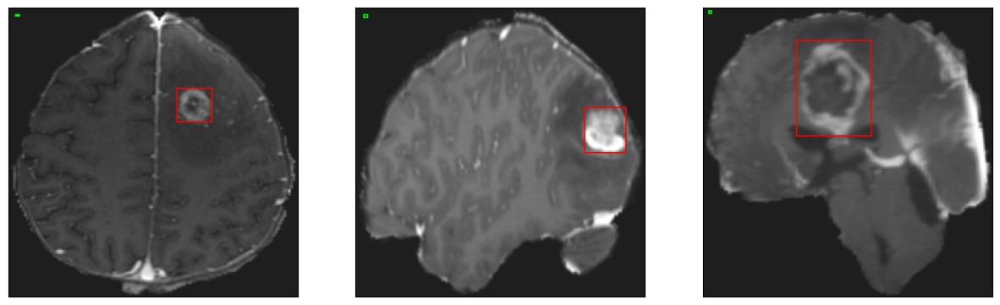

26/26 [==============================] - 18s 168ms/step - loss: 34.8726 - IoU: 0.0617 - val_loss: 68.3214 - val_IoU: 0.0000e+00
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 23.2771 - IoU: 0.1085
Epoch 2: val_loss improved from 68.32137 to 58.48839, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


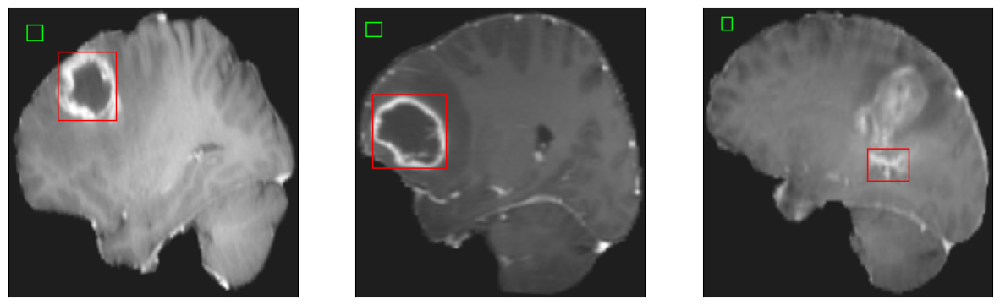

26/26 [==============================] - 3s 116ms/step - loss: 23.2436 - IoU: 0.1089 - val_loss: 58.4884 - val_IoU: 0.0000e+00
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 19.5982 - IoU: 0.1650
Epoch 3: val_loss improved from 58.48839 to 47.27850, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


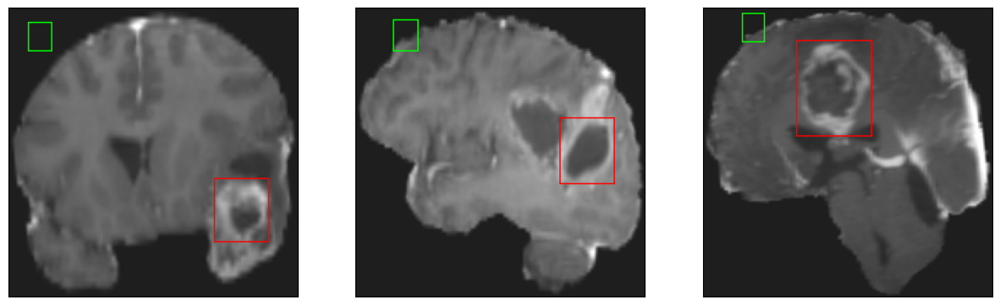

26/26 [==============================] - 3s 100ms/step - loss: 19.5982 - IoU: 0.1650 - val_loss: 47.2785 - val_IoU: 1.7378e-04
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 16.1274 - IoU: 0.2494
Epoch 4: val_loss improved from 47.27850 to 35.94250, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


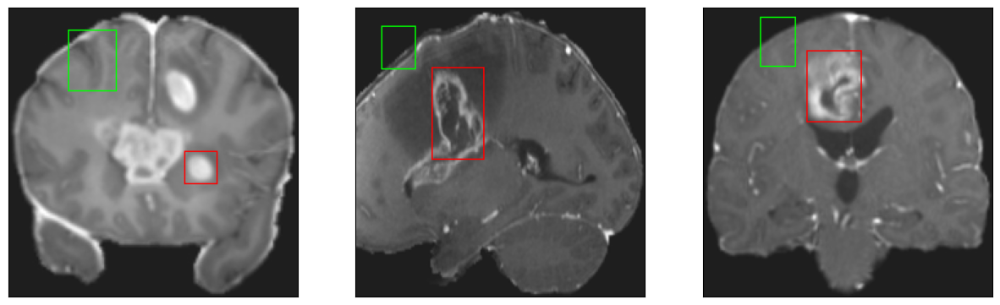

26/26 [==============================] - 2s 91ms/step - loss: 16.1746 - IoU: 0.2475 - val_loss: 35.9425 - val_IoU: 0.0209
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 14.8378 - IoU: 0.2739
Epoch 5: val_loss improved from 35.94250 to 33.19614, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


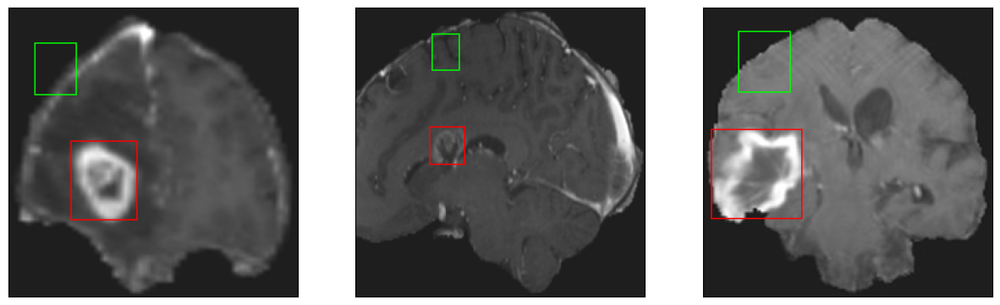

26/26 [==============================] - 3s 100ms/step - loss: 14.8339 - IoU: 0.2727 - val_loss: 33.1961 - val_IoU: 0.0348
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 13.7320 - IoU: 0.3079
Epoch 6: val_loss improved from 33.19614 to 30.25085, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


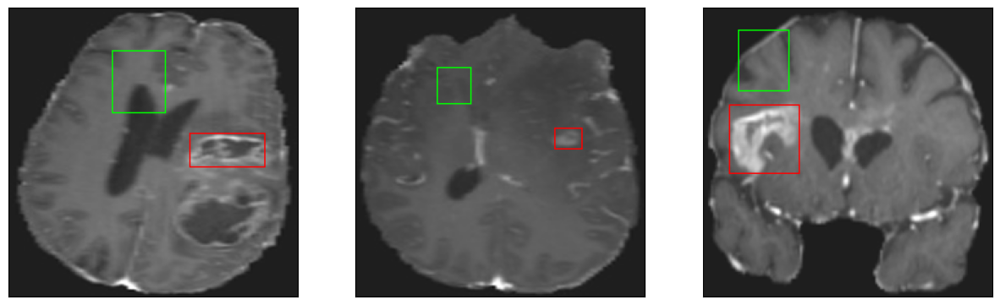

26/26 [==============================] - 3s 114ms/step - loss: 13.6684 - IoU: 0.3097 - val_loss: 30.2509 - val_IoU: 0.0508
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 12.7407 - IoU: 0.3262
Epoch 7: val_loss improved from 30.25085 to 25.74355, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


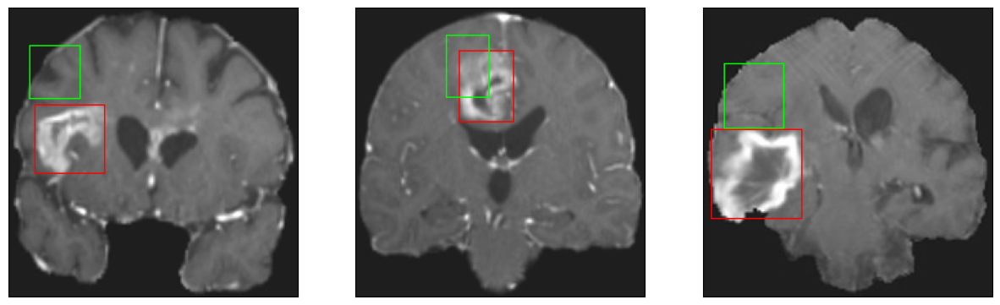

26/26 [==============================] - 2s 93ms/step - loss: 12.7407 - IoU: 0.3262 - val_loss: 25.7435 - val_IoU: 0.0718
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 12.0755 - IoU: 0.3429
Epoch 8: val_loss did not improve from 25.74355
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


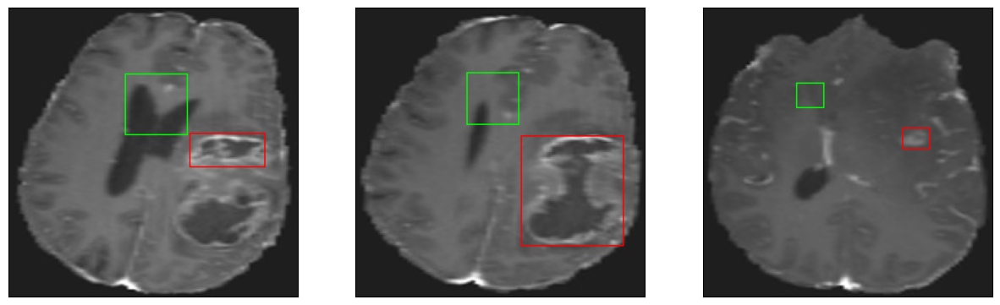

26/26 [==============================] - 2s 84ms/step - loss: 12.0140 - IoU: 0.3435 - val_loss: 27.4588 - val_IoU: 0.0506
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 11.6051 - IoU: 0.3558
Epoch 9: val_loss improved from 25.74355 to 24.32095, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


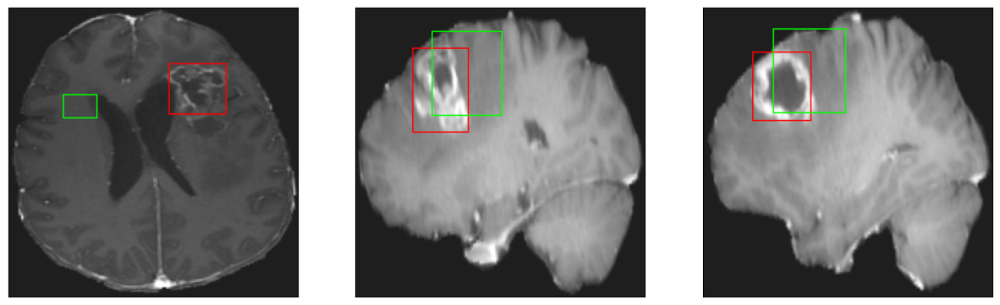

26/26 [==============================] - 2s 94ms/step - loss: 11.5422 - IoU: 0.3571 - val_loss: 24.3210 - val_IoU: 0.0797
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.9055 - IoU: 0.3730
Epoch 10: val_loss improved from 24.32095 to 21.01913, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


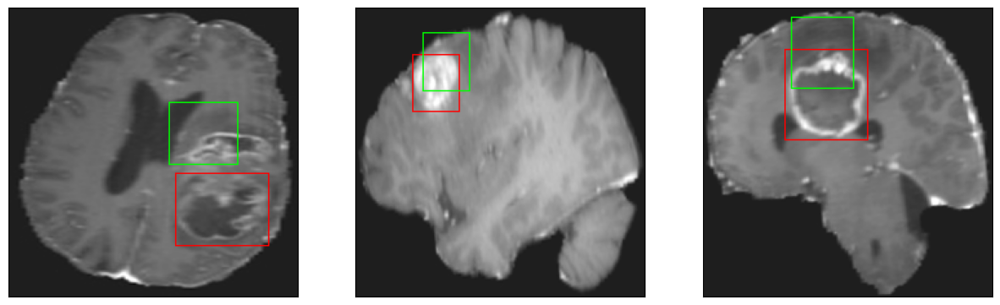

26/26 [==============================] - 2s 91ms/step - loss: 10.8768 - IoU: 0.3736 - val_loss: 21.0191 - val_IoU: 0.1123
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 10.6309 - IoU: 0.3821
Epoch 11: val_loss improved from 21.01913 to 17.95621, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


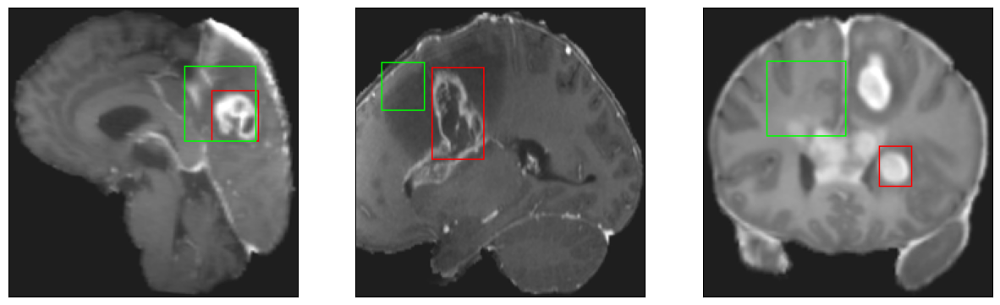

26/26 [==============================] - 3s 119ms/step - loss: 10.6352 - IoU: 0.3811 - val_loss: 17.9562 - val_IoU: 0.1997
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 10.5969 - IoU: 0.3818
Epoch 12: val_loss improved from 17.95621 to 15.95128, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


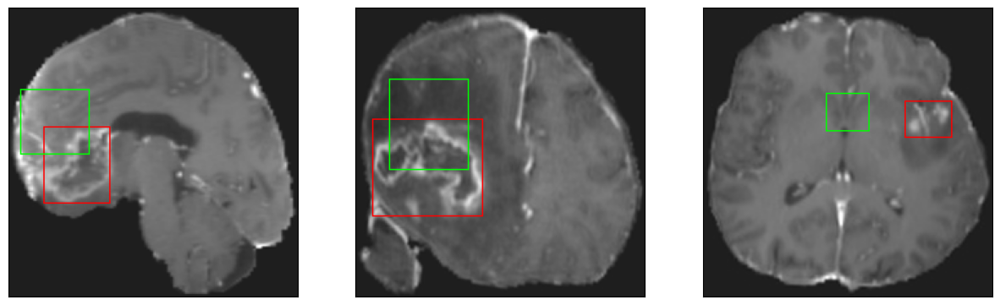

26/26 [==============================] - 3s 110ms/step - loss: 10.5843 - IoU: 0.3843 - val_loss: 15.9513 - val_IoU: 0.2609
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 9.8180 - IoU: 0.4113
Epoch 13: val_loss did not improve from 15.95128
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


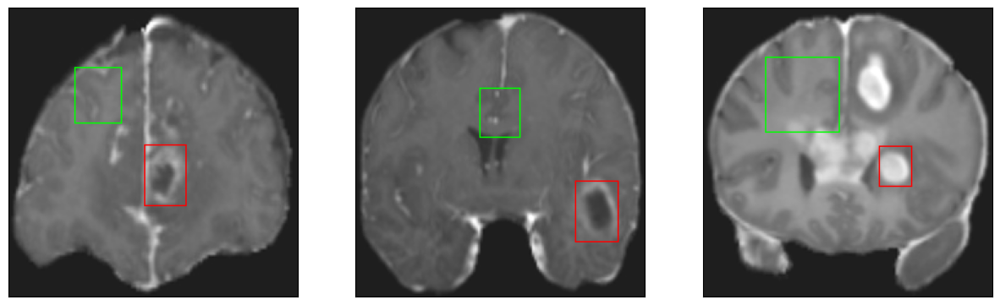

26/26 [==============================] - 3s 96ms/step - loss: 9.8552 - IoU: 0.4099 - val_loss: 19.2821 - val_IoU: 0.1802
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 9.8620 - IoU: 0.4078
Epoch 14: val_loss improved from 15.95128 to 13.60431, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


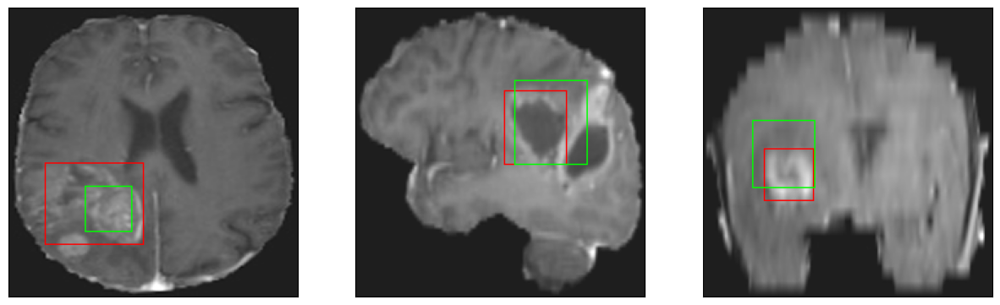

26/26 [==============================] - 3s 97ms/step - loss: 9.8620 - IoU: 0.4078 - val_loss: 13.6043 - val_IoU: 0.3371
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 9.6574 - IoU: 0.4195
Epoch 15: val_loss improved from 13.60431 to 11.44124, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


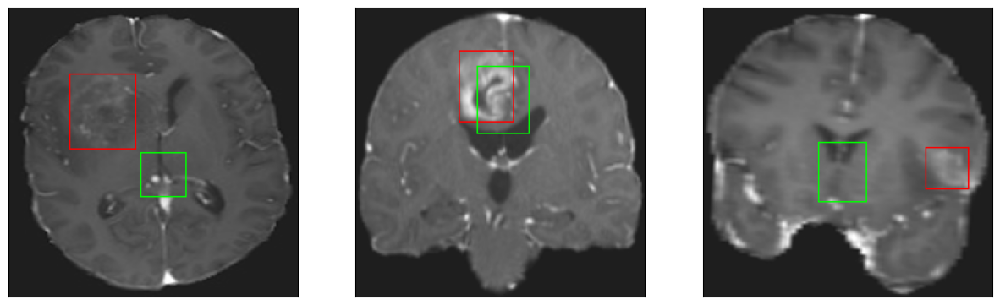

26/26 [==============================] - 3s 97ms/step - loss: 9.6574 - IoU: 0.4195 - val_loss: 11.4412 - val_IoU: 0.3884
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 9.0699 - IoU: 0.4303
Epoch 16: val_loss did not improve from 11.44124
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


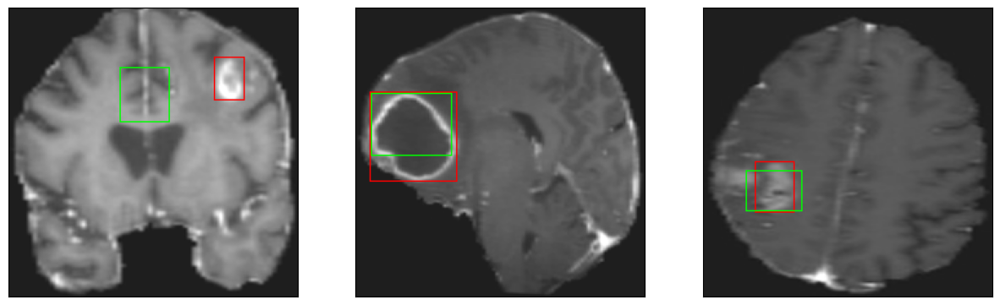

26/26 [==============================] - 3s 97ms/step - loss: 9.0480 - IoU: 0.4311 - val_loss: 12.0970 - val_IoU: 0.3548
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8499 - IoU: 0.4470
Epoch 17: val_loss did not improve from 11.44124
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


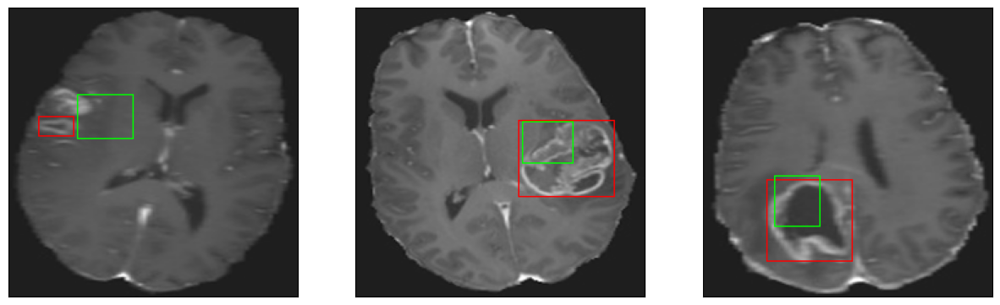

26/26 [==============================] - 2s 95ms/step - loss: 8.8423 - IoU: 0.4477 - val_loss: 15.1253 - val_IoU: 0.2483
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8433 - IoU: 0.4403
Epoch 18: val_loss did not improve from 11.44124
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


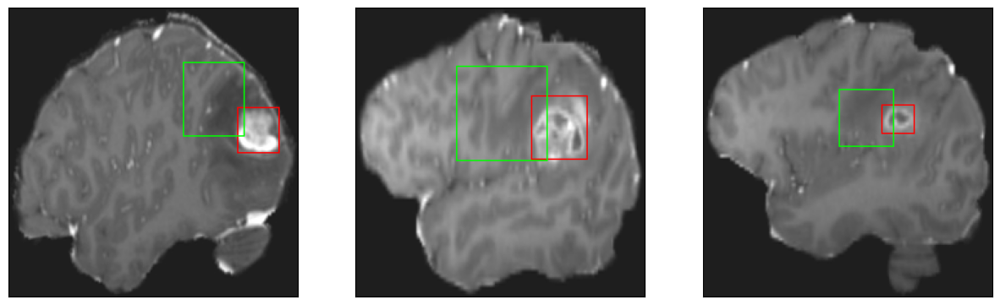

26/26 [==============================] - 2s 89ms/step - loss: 8.8659 - IoU: 0.4404 - val_loss: 12.7329 - val_IoU: 0.3801
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 8.7392 - IoU: 0.4415
Epoch 19: val_loss improved from 11.44124 to 11.07605, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


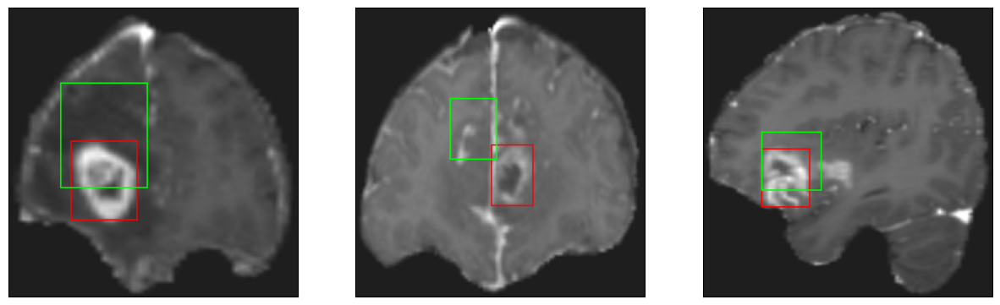

26/26 [==============================] - 3s 128ms/step - loss: 8.7392 - IoU: 0.4415 - val_loss: 11.0760 - val_IoU: 0.4141
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 8.3746 - IoU: 0.4631
Epoch 20: val_loss did not improve from 11.07605
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


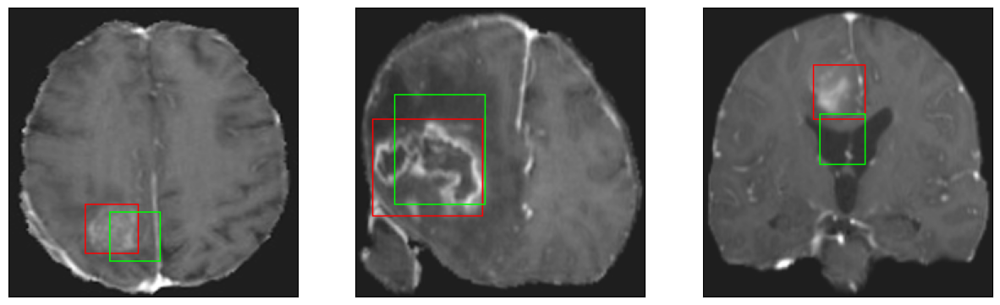

26/26 [==============================] - 3s 126ms/step - loss: 8.3746 - IoU: 0.4631 - val_loss: 11.4074 - val_IoU: 0.3854
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 8.5661 - IoU: 0.4471
Epoch 21: val_loss did not improve from 11.07605
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


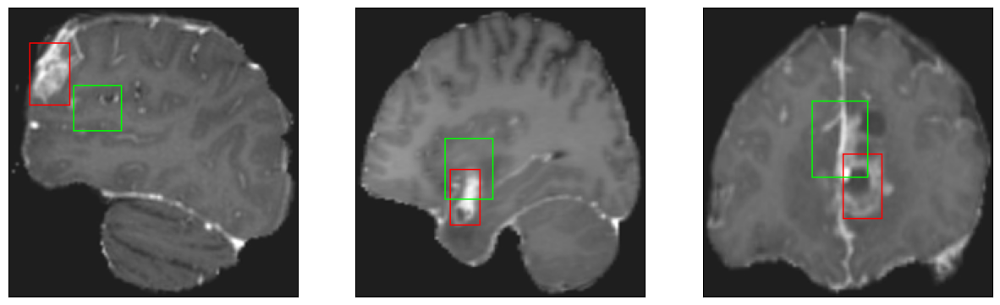

26/26 [==============================] - 3s 108ms/step - loss: 8.5661 - IoU: 0.4471 - val_loss: 11.4909 - val_IoU: 0.3977
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0867 - IoU: 0.4666
Epoch 22: val_loss did not improve from 11.07605
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


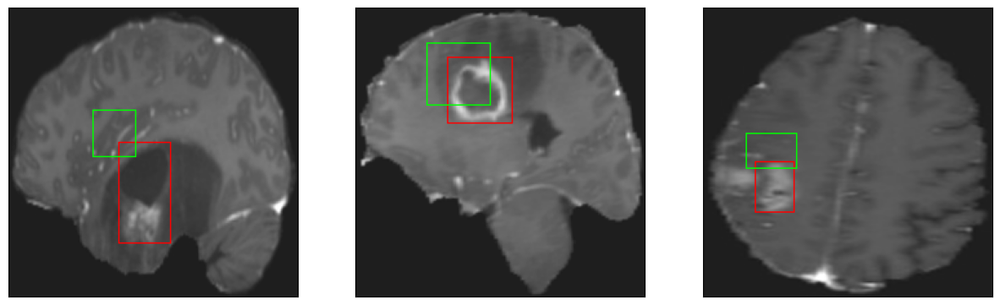

26/26 [==============================] - 2s 92ms/step - loss: 8.1076 - IoU: 0.4661 - val_loss: 14.7201 - val_IoU: 0.2542
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0932 - IoU: 0.4757
Epoch 23: val_loss did not improve from 11.07605
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


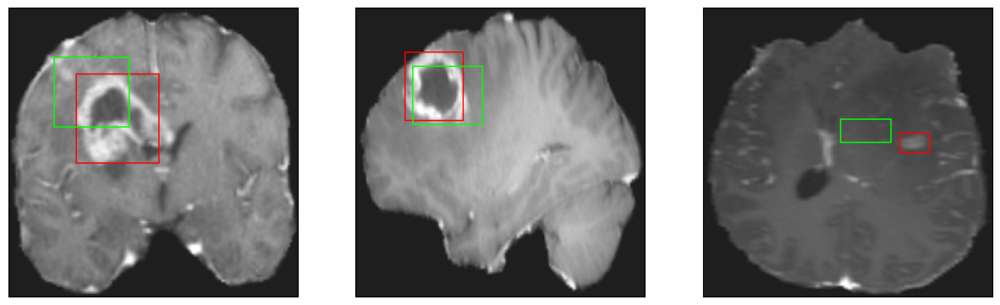

26/26 [==============================] - 3s 107ms/step - loss: 8.1210 - IoU: 0.4735 - val_loss: 17.4780 - val_IoU: 0.1960
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 8.1851 - IoU: 0.4589
Epoch 24: val_loss did not improve from 11.07605
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


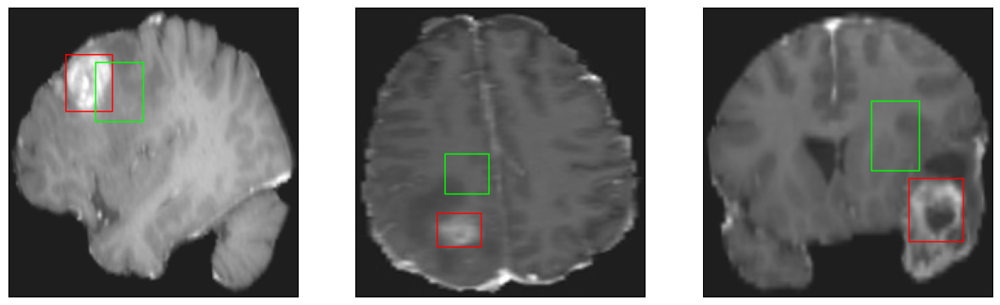

26/26 [==============================] - 2s 92ms/step - loss: 8.1851 - IoU: 0.4589 - val_loss: 11.9975 - val_IoU: 0.3572
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 8.0125 - IoU: 0.4704
Epoch 25: val_loss improved from 11.07605 to 10.91945, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


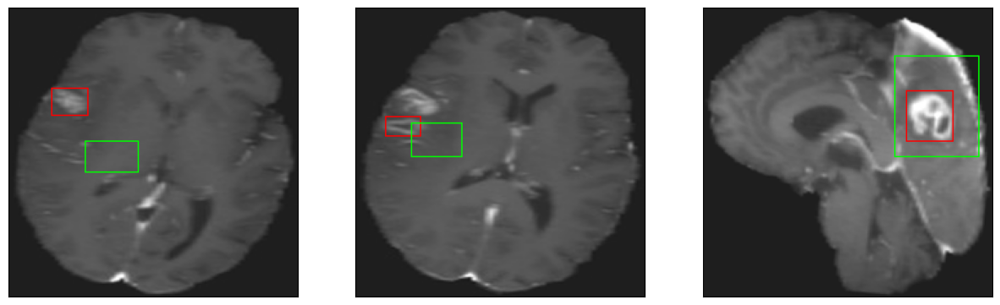

26/26 [==============================] - 3s 109ms/step - loss: 8.0125 - IoU: 0.4704 - val_loss: 10.9195 - val_IoU: 0.4151
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7929 - IoU: 0.4780
Epoch 26: val_loss did not improve from 10.91945
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


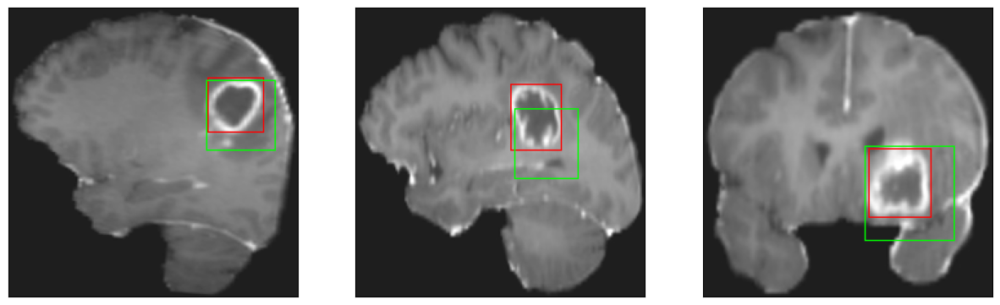

26/26 [==============================] - 2s 94ms/step - loss: 7.7819 - IoU: 0.4803 - val_loss: 11.8522 - val_IoU: 0.3632
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4258 - IoU: 0.4927
Epoch 27: val_loss did not improve from 10.91945
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


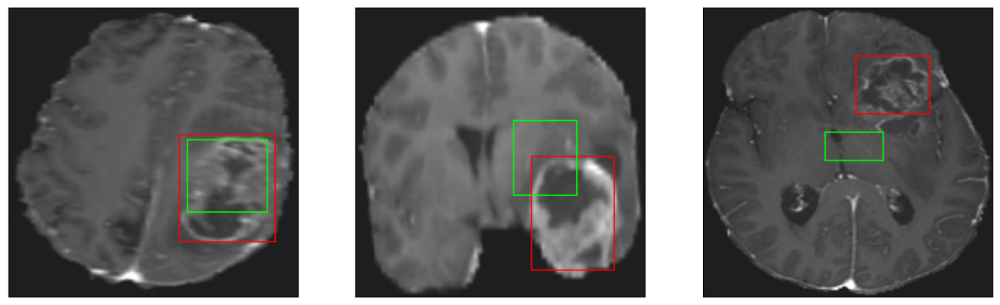

26/26 [==============================] - 3s 111ms/step - loss: 7.4146 - IoU: 0.4914 - val_loss: 10.9265 - val_IoU: 0.4119
Epoch 28/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5196 - IoU: 0.4903
Epoch 28: val_loss did not improve from 10.91945
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


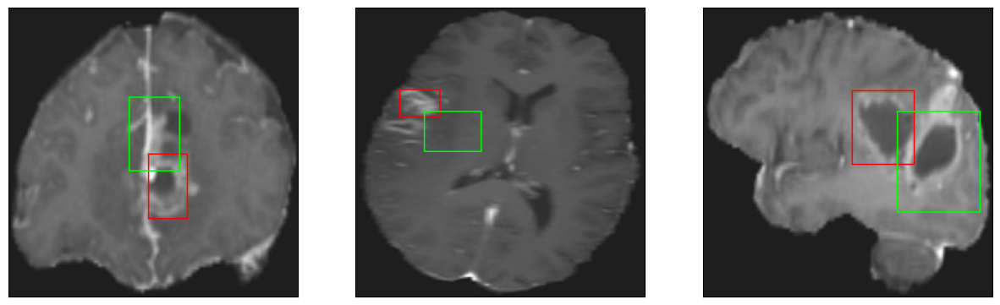

26/26 [==============================] - 2s 88ms/step - loss: 7.5753 - IoU: 0.4885 - val_loss: 11.6298 - val_IoU: 0.3798
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 7.2467 - IoU: 0.5017
Epoch 29: val_loss did not improve from 10.91945
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


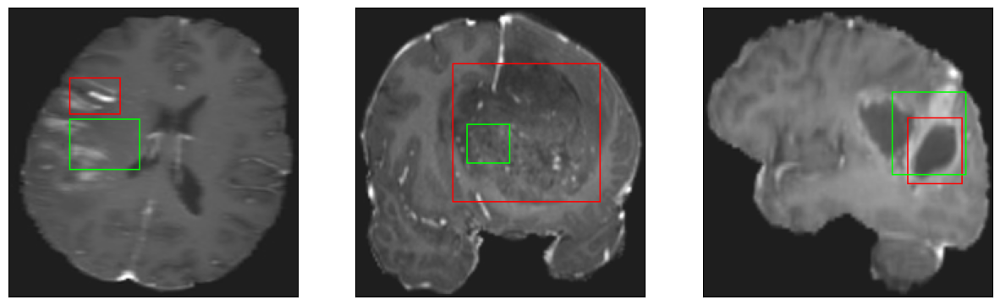

26/26 [==============================] - 2s 96ms/step - loss: 7.2467 - IoU: 0.5017 - val_loss: 11.7216 - val_IoU: 0.3624
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4201 - IoU: 0.4940
Epoch 30: val_loss did not improve from 10.91945
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


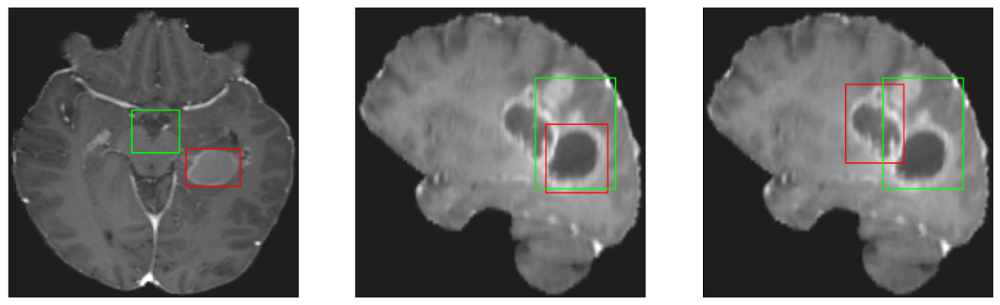

26/26 [==============================] - 2s 86ms/step - loss: 7.4211 - IoU: 0.4950 - val_loss: 11.5057 - val_IoU: 0.4069
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8487 - IoU: 0.5180
Epoch 31: val_loss improved from 10.91945 to 10.33768, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


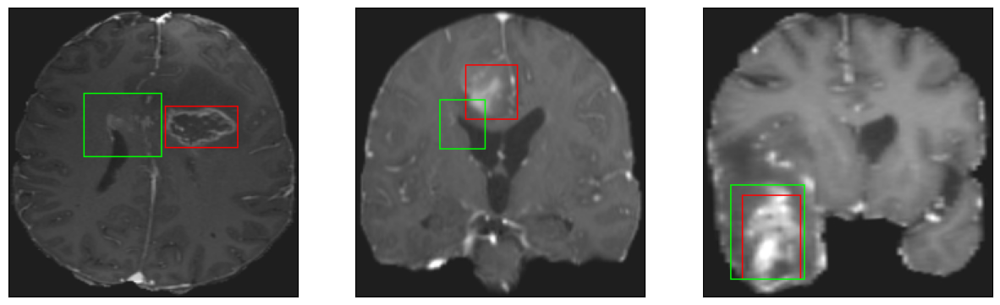

26/26 [==============================] - 3s 118ms/step - loss: 6.8774 - IoU: 0.5171 - val_loss: 10.3377 - val_IoU: 0.4181
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 7.1447 - IoU: 0.5080
Epoch 32: val_loss did not improve from 10.33768
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


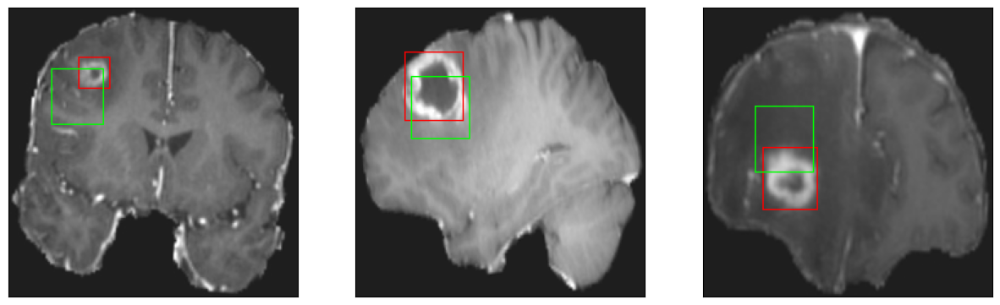

26/26 [==============================] - 3s 111ms/step - loss: 7.1447 - IoU: 0.5080 - val_loss: 10.9219 - val_IoU: 0.3992
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.9621 - IoU: 0.5078
Epoch 33: val_loss did not improve from 10.33768
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


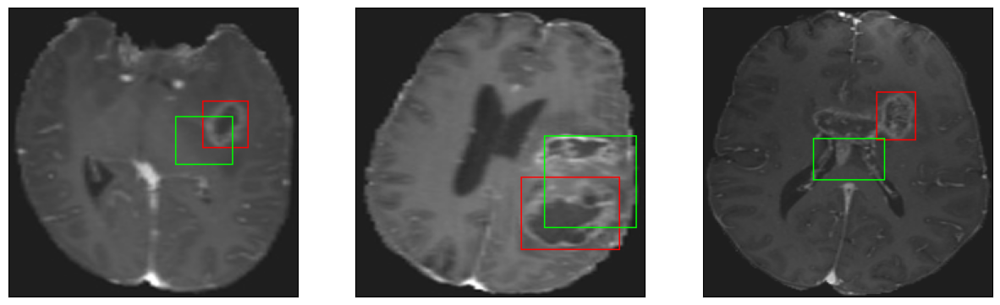

26/26 [==============================] - 3s 101ms/step - loss: 6.9621 - IoU: 0.5078 - val_loss: 10.7805 - val_IoU: 0.3936
Epoch 34/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9751 - IoU: 0.5119
Epoch 34: val_loss did not improve from 10.33768
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


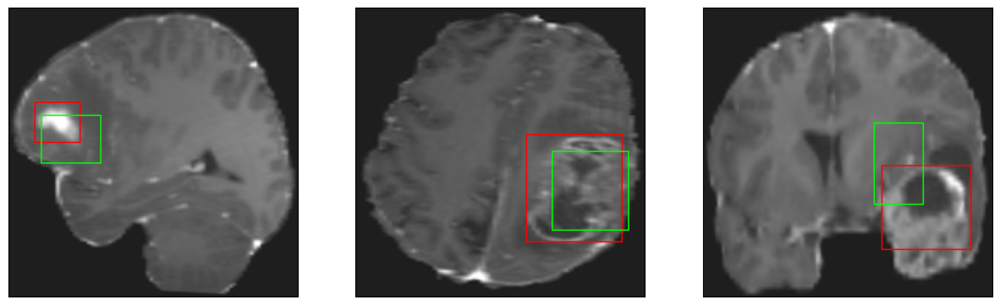

26/26 [==============================] - 2s 88ms/step - loss: 6.9966 - IoU: 0.5101 - val_loss: 11.5822 - val_IoU: 0.3658
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 7.1770 - IoU: 0.4966
Epoch 35: val_loss improved from 10.33768 to 10.13103, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


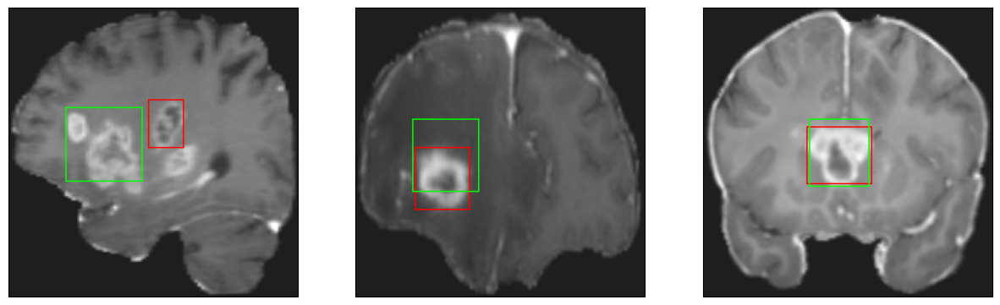

26/26 [==============================] - 3s 123ms/step - loss: 7.1770 - IoU: 0.4966 - val_loss: 10.1310 - val_IoU: 0.4222
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6630 - IoU: 0.5312
Epoch 36: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


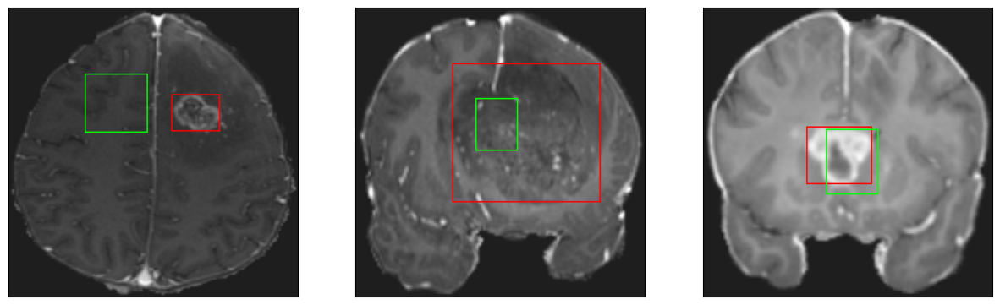

26/26 [==============================] - 3s 119ms/step - loss: 6.6549 - IoU: 0.5322 - val_loss: 10.8013 - val_IoU: 0.3859
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 6.6991 - IoU: 0.5299
Epoch 37: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


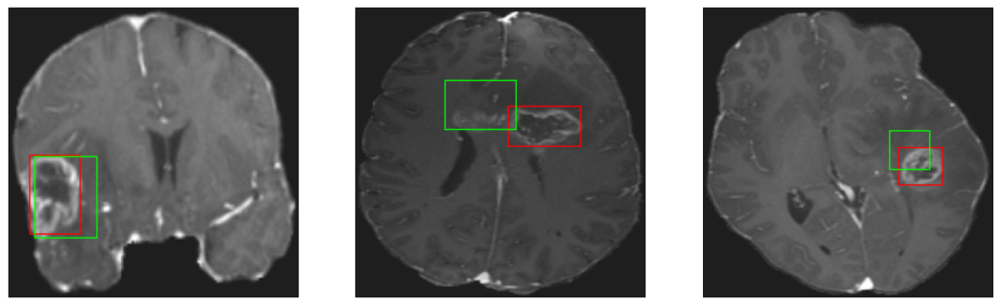

26/26 [==============================] - 2s 96ms/step - loss: 6.6991 - IoU: 0.5299 - val_loss: 10.4075 - val_IoU: 0.4155
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5607 - IoU: 0.5347
Epoch 38: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


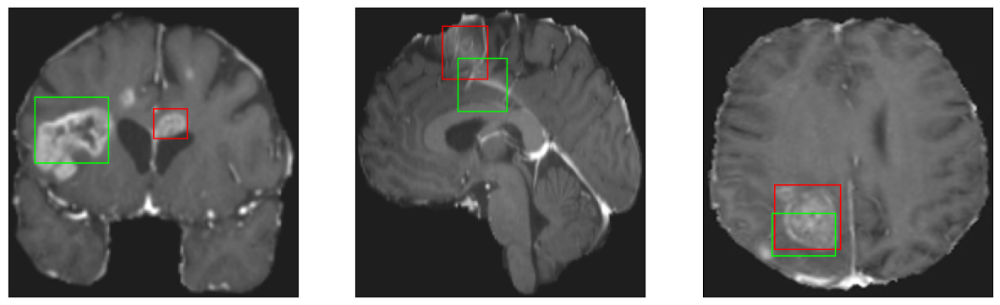

26/26 [==============================] - 2s 94ms/step - loss: 6.5494 - IoU: 0.5366 - val_loss: 10.8499 - val_IoU: 0.4006
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 6.6645 - IoU: 0.5360
Epoch 39: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


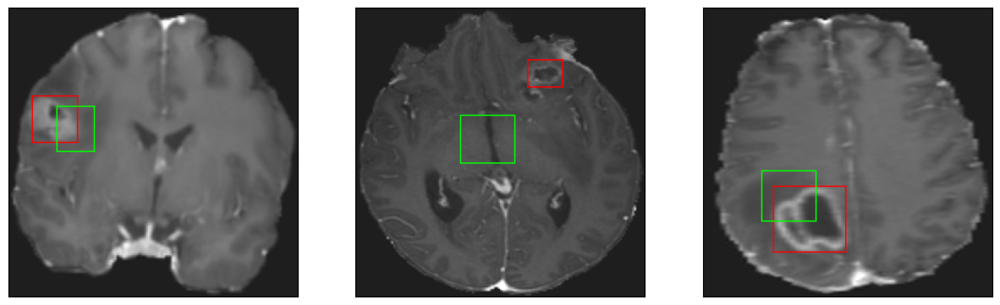

26/26 [==============================] - 2s 94ms/step - loss: 6.6645 - IoU: 0.5360 - val_loss: 11.9256 - val_IoU: 0.3666
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.6504 - IoU: 0.5346
Epoch 40: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


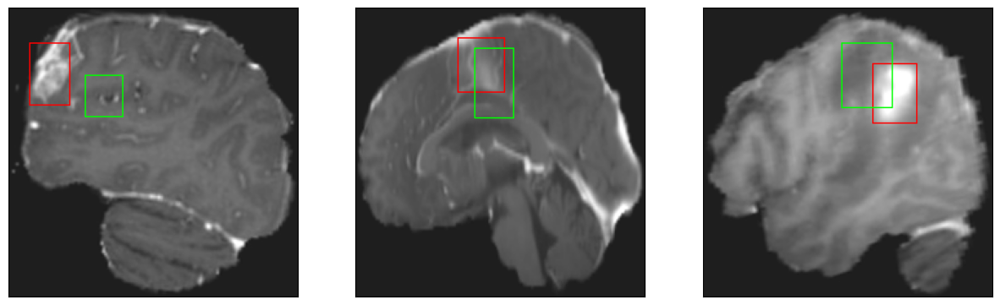

26/26 [==============================] - 3s 100ms/step - loss: 6.6504 - IoU: 0.5346 - val_loss: 10.3465 - val_IoU: 0.4160
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3655 - IoU: 0.5559
Epoch 41: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


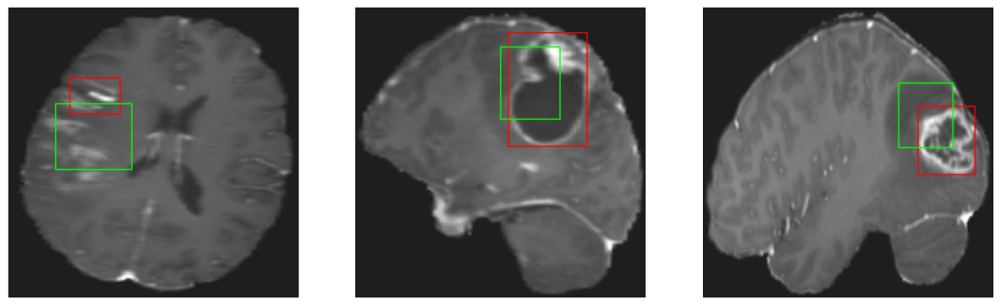

26/26 [==============================] - 3s 110ms/step - loss: 6.3627 - IoU: 0.5540 - val_loss: 10.3078 - val_IoU: 0.4214
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 6.4337 - IoU: 0.5418
Epoch 42: val_loss did not improve from 10.13103
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


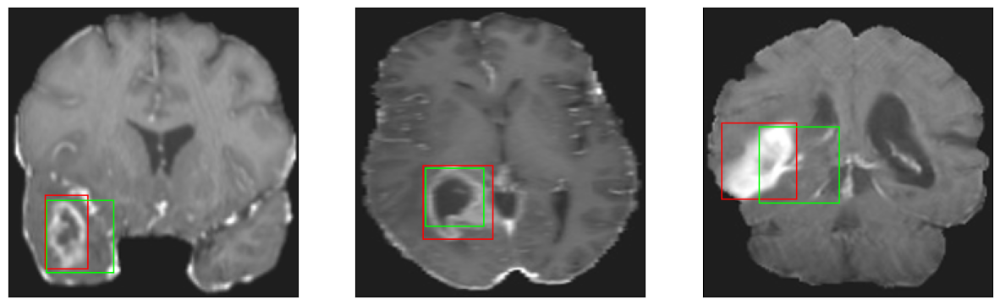

26/26 [==============================] - 3s 114ms/step - loss: 6.4337 - IoU: 0.5418 - val_loss: 10.6823 - val_IoU: 0.3948
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 6.3157 - IoU: 0.5411
Epoch 43: val_loss improved from 10.13103 to 9.61166, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


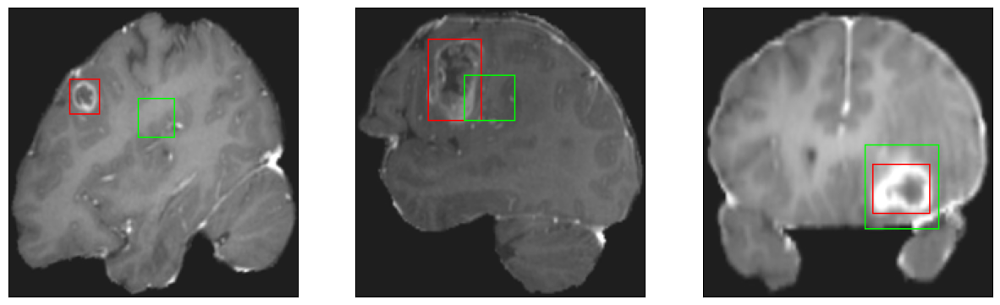

26/26 [==============================] - 3s 115ms/step - loss: 6.3157 - IoU: 0.5411 - val_loss: 9.6117 - val_IoU: 0.4544
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 6.0731 - IoU: 0.5575
Epoch 44: val_loss did not improve from 9.61166
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


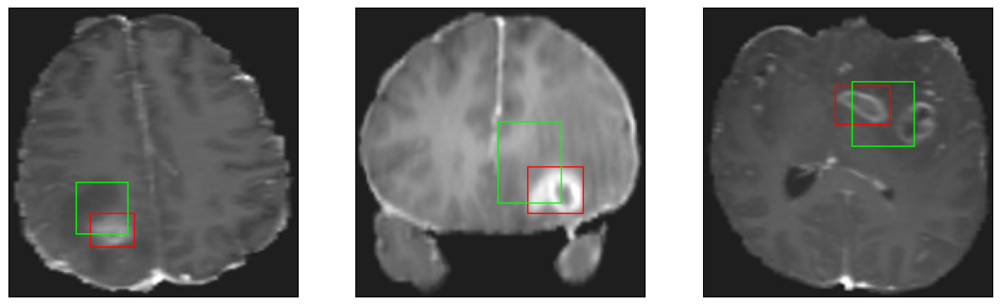

26/26 [==============================] - 3s 110ms/step - loss: 6.0731 - IoU: 0.5575 - val_loss: 10.7424 - val_IoU: 0.4249
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 6.4674 - IoU: 0.5429
Epoch 45: val_loss did not improve from 9.61166
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


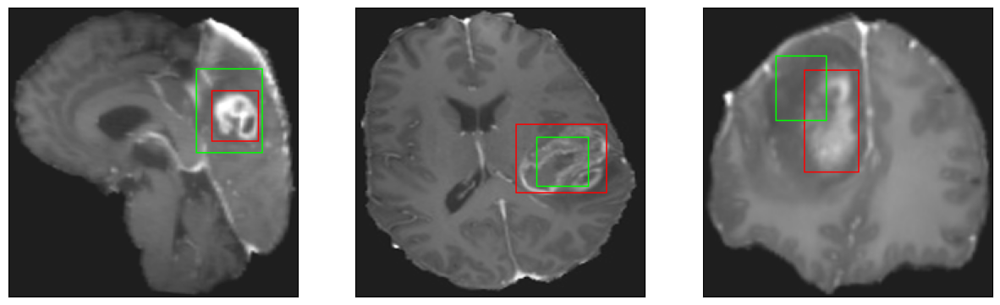

26/26 [==============================] - 3s 129ms/step - loss: 6.4674 - IoU: 0.5429 - val_loss: 9.7117 - val_IoU: 0.4572
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 6.4523 - IoU: 0.5424
Epoch 46: val_loss did not improve from 9.61166
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


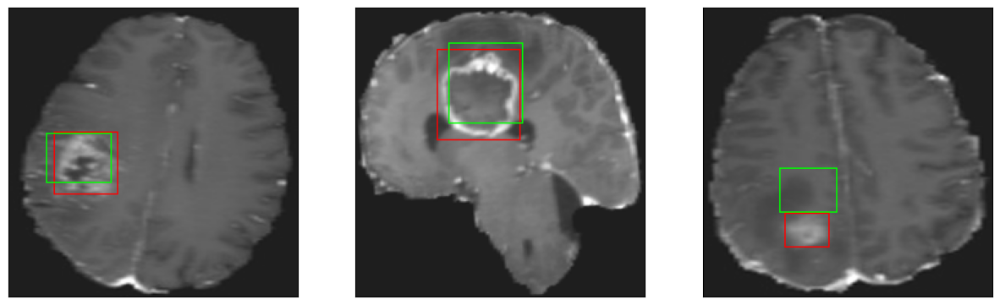

26/26 [==============================] - 2s 92ms/step - loss: 6.4523 - IoU: 0.5424 - val_loss: 10.1176 - val_IoU: 0.4480
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 5.9849 - IoU: 0.5643
Epoch 47: val_loss improved from 9.61166 to 9.55773, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


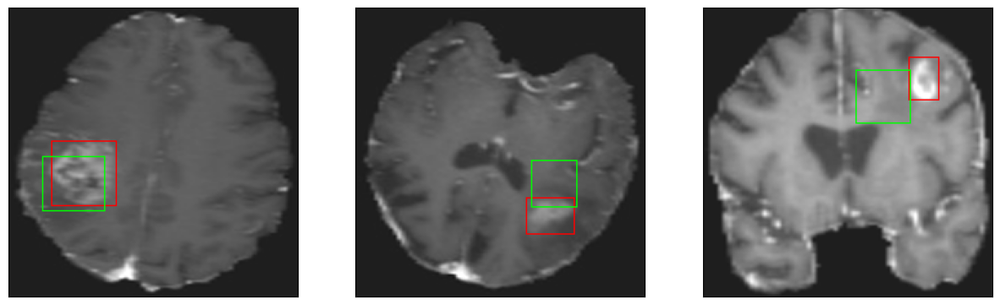

26/26 [==============================] - 3s 122ms/step - loss: 5.9849 - IoU: 0.5643 - val_loss: 9.5577 - val_IoU: 0.4536
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2060 - IoU: 0.5503
Epoch 48: val_loss did not improve from 9.55773
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


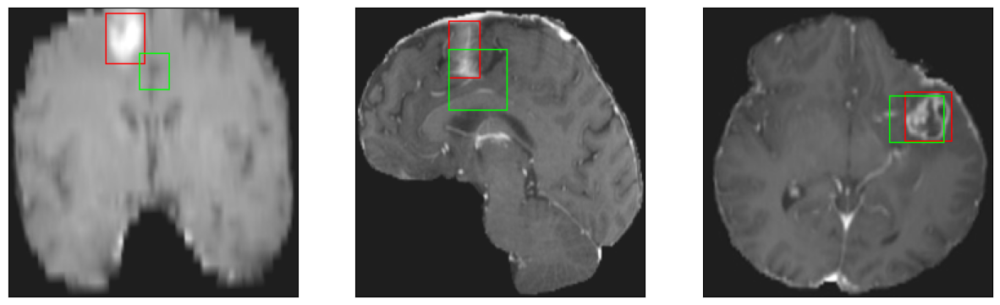

26/26 [==============================] - 2s 89ms/step - loss: 6.1731 - IoU: 0.5522 - val_loss: 10.4674 - val_IoU: 0.4242
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 6.2735 - IoU: 0.5457
Epoch 49: val_loss did not improve from 9.55773
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


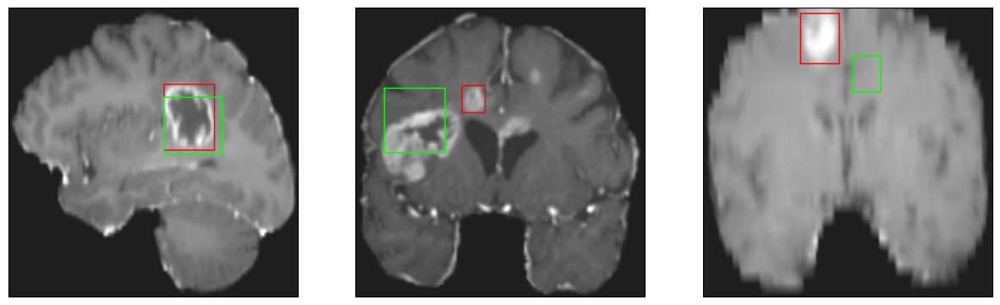

26/26 [==============================] - 3s 115ms/step - loss: 6.2735 - IoU: 0.5457 - val_loss: 10.0158 - val_IoU: 0.4315
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1913 - IoU: 0.5497
Epoch 50: val_loss did not improve from 9.55773
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


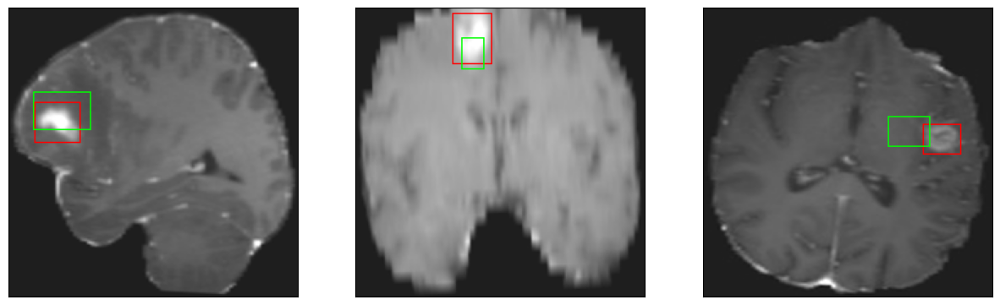

26/26 [==============================] - 3s 118ms/step - loss: 6.2005 - IoU: 0.5496 - val_loss: 13.4523 - val_IoU: 0.2935
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3912 - IoU: 0.5473
Epoch 51: val_loss improved from 9.55773 to 9.55226, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


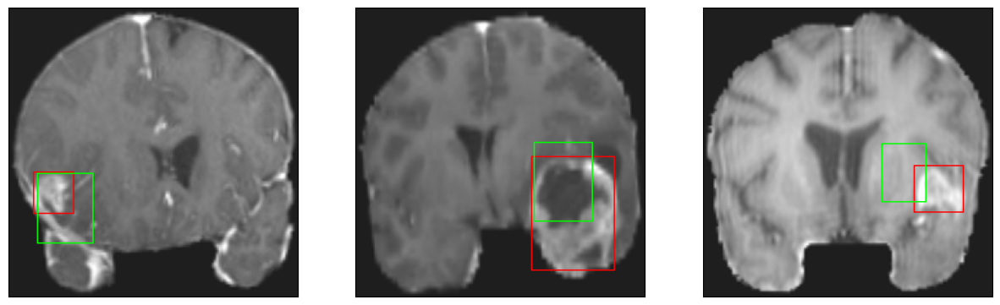

26/26 [==============================] - 3s 132ms/step - loss: 6.3318 - IoU: 0.5489 - val_loss: 9.5523 - val_IoU: 0.4505
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 6.1723 - IoU: 0.5517
Epoch 52: val_loss did not improve from 9.55226
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


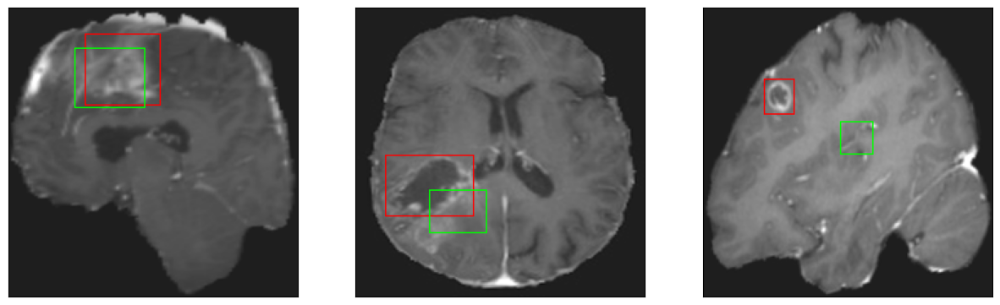

26/26 [==============================] - 2s 94ms/step - loss: 6.1723 - IoU: 0.5517 - val_loss: 10.1444 - val_IoU: 0.3979
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1590 - IoU: 0.5521
Epoch 53: val_loss did not improve from 9.55226
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


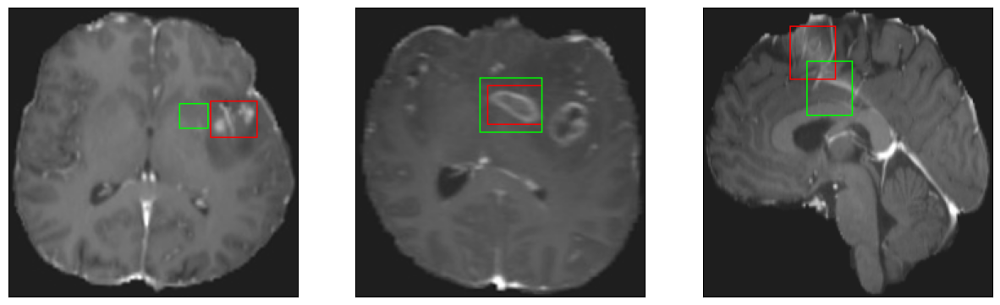

26/26 [==============================] - 3s 113ms/step - loss: 6.1086 - IoU: 0.5554 - val_loss: 10.0899 - val_IoU: 0.4364
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 6.1210 - IoU: 0.5547
Epoch 54: val_loss improved from 9.55226 to 9.54308, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


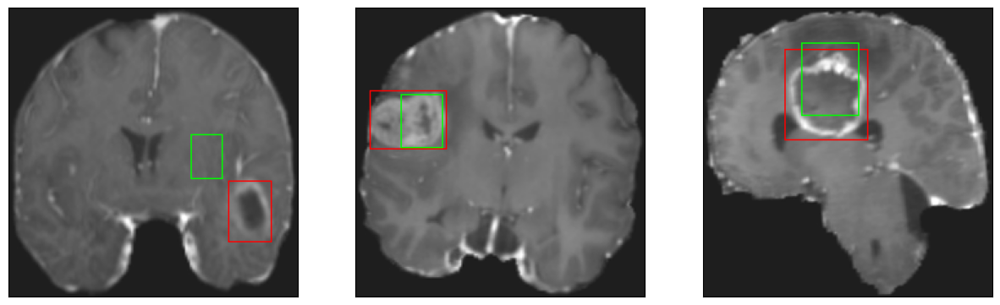

26/26 [==============================] - 4s 143ms/step - loss: 6.1210 - IoU: 0.5547 - val_loss: 9.5431 - val_IoU: 0.4470
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.7763 - IoU: 0.5737
Epoch 55: val_loss did not improve from 9.54308
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


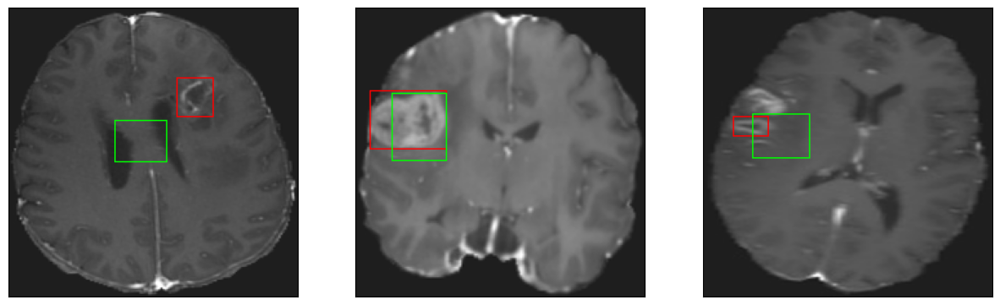

26/26 [==============================] - 3s 97ms/step - loss: 5.7763 - IoU: 0.5737 - val_loss: 10.2930 - val_IoU: 0.4564
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 5.8864 - IoU: 0.5685
Epoch 56: val_loss improved from 9.54308 to 9.49902, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


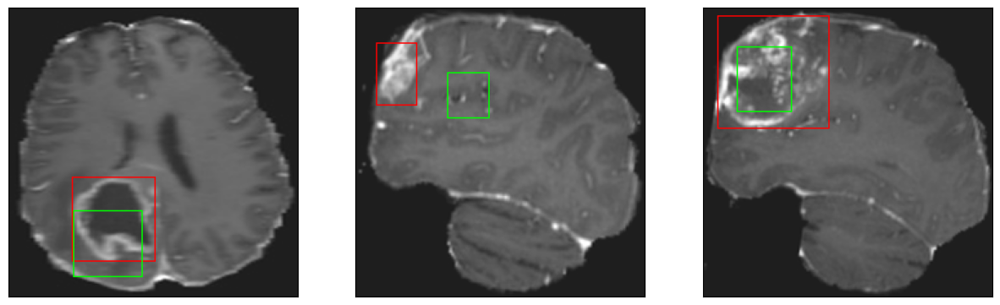

26/26 [==============================] - 3s 109ms/step - loss: 5.8864 - IoU: 0.5685 - val_loss: 9.4990 - val_IoU: 0.4677
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8342 - IoU: 0.5695
Epoch 57: val_loss did not improve from 9.49902
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


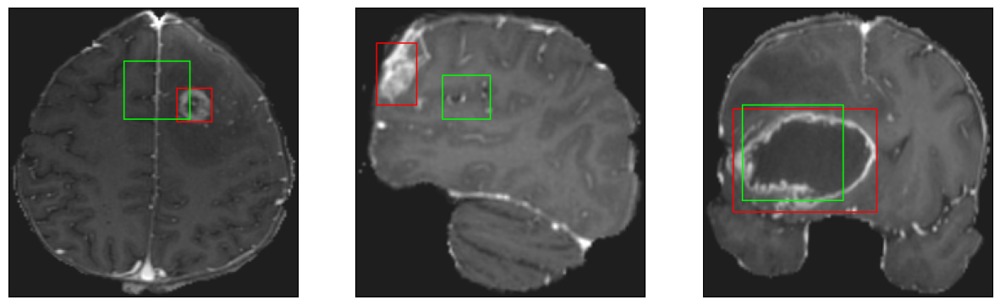

26/26 [==============================] - 3s 113ms/step - loss: 5.8531 - IoU: 0.5689 - val_loss: 10.5549 - val_IoU: 0.4274
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8904 - IoU: 0.5694
Epoch 58: val_loss did not improve from 9.49902
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


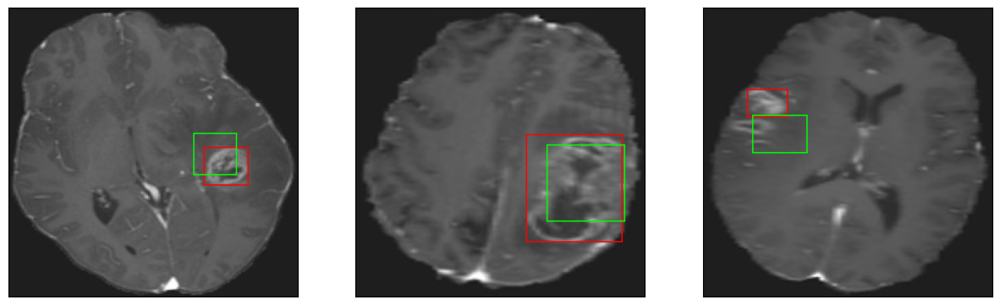

26/26 [==============================] - 3s 122ms/step - loss: 5.8546 - IoU: 0.5691 - val_loss: 10.3293 - val_IoU: 0.4385
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.7973 - IoU: 0.5794
Epoch 59: val_loss did not improve from 9.49902
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


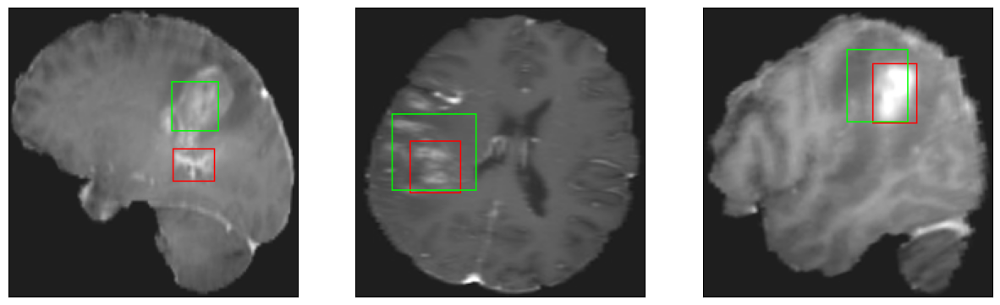

26/26 [==============================] - 3s 105ms/step - loss: 5.7973 - IoU: 0.5794 - val_loss: 9.8779 - val_IoU: 0.4459
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.6003 - IoU: 0.5872
Epoch 60: val_loss improved from 9.49902 to 9.01791, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


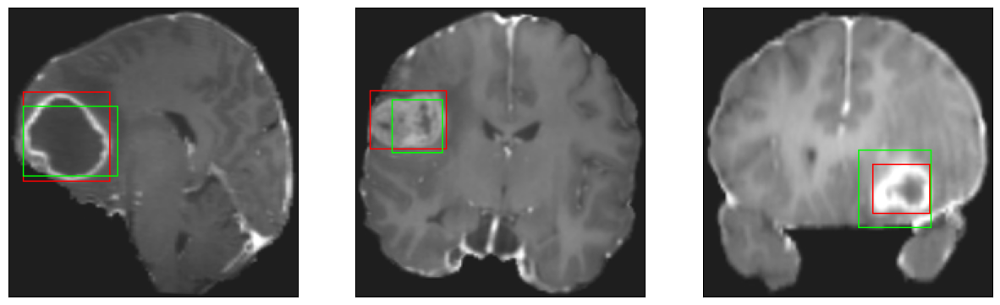

26/26 [==============================] - 3s 115ms/step - loss: 5.6003 - IoU: 0.5872 - val_loss: 9.0179 - val_IoU: 0.4726
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 5.7664 - IoU: 0.5770
Epoch 61: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


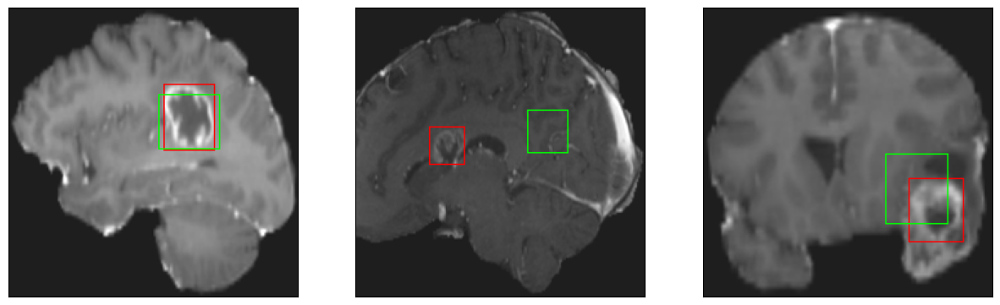

26/26 [==============================] - 3s 109ms/step - loss: 5.7664 - IoU: 0.5770 - val_loss: 10.7164 - val_IoU: 0.4077
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7985 - IoU: 0.5732
Epoch 62: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


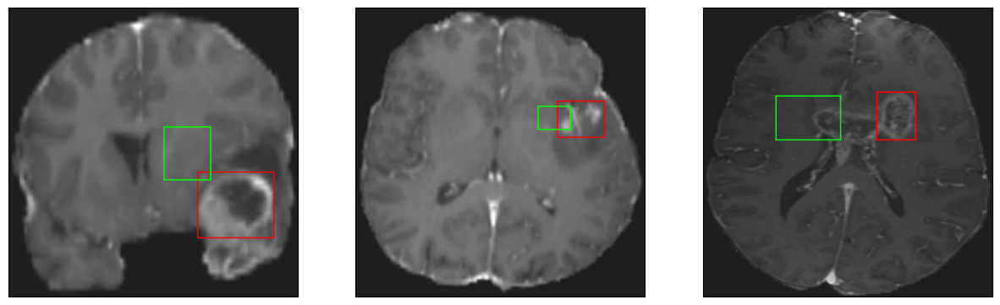

26/26 [==============================] - 3s 118ms/step - loss: 5.7802 - IoU: 0.5723 - val_loss: 9.8061 - val_IoU: 0.4549
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5285 - IoU: 0.5867
Epoch 63: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4


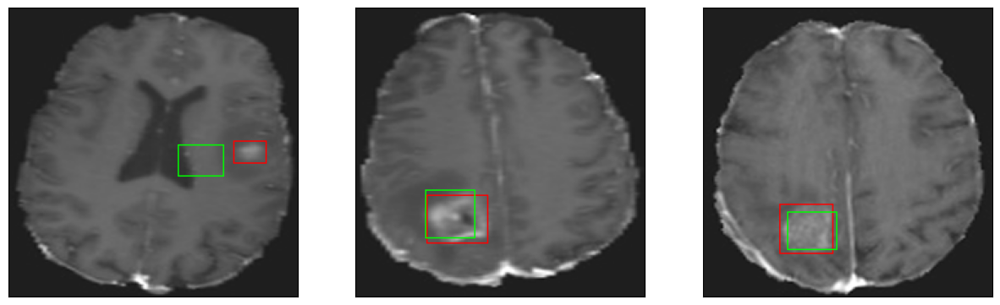

26/26 [==============================] - 3s 115ms/step - loss: 5.5299 - IoU: 0.5854 - val_loss: 9.8718 - val_IoU: 0.4425
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5219 - IoU: 0.5849
Epoch 64: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


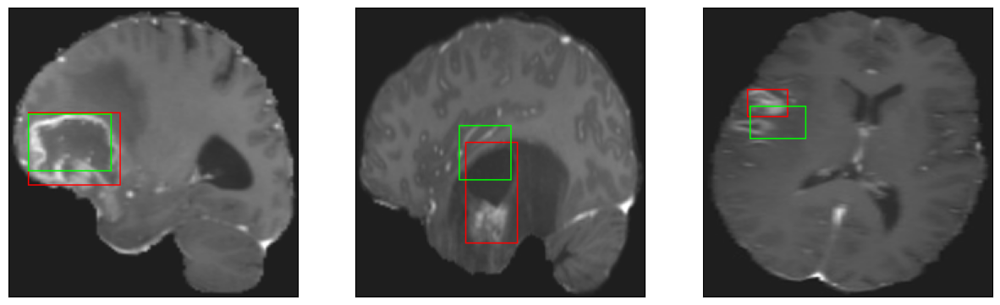

26/26 [==============================] - 3s 96ms/step - loss: 5.5287 - IoU: 0.5860 - val_loss: 10.9175 - val_IoU: 0.4234
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6483 - IoU: 0.5801
Epoch 65: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


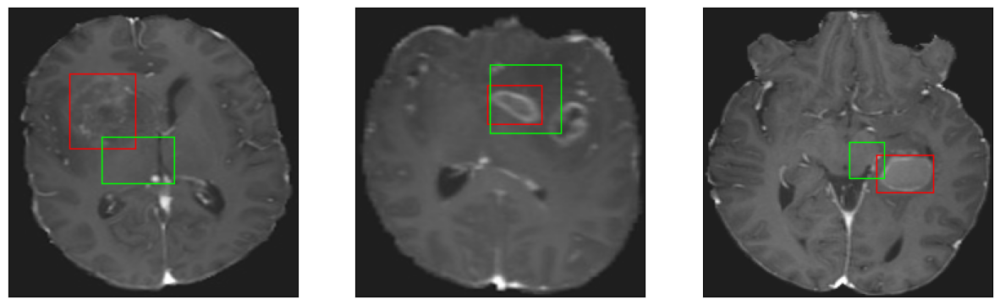

26/26 [==============================] - 3s 106ms/step - loss: 5.6086 - IoU: 0.5831 - val_loss: 9.6605 - val_IoU: 0.4647
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5108 - IoU: 0.5899
Epoch 66: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


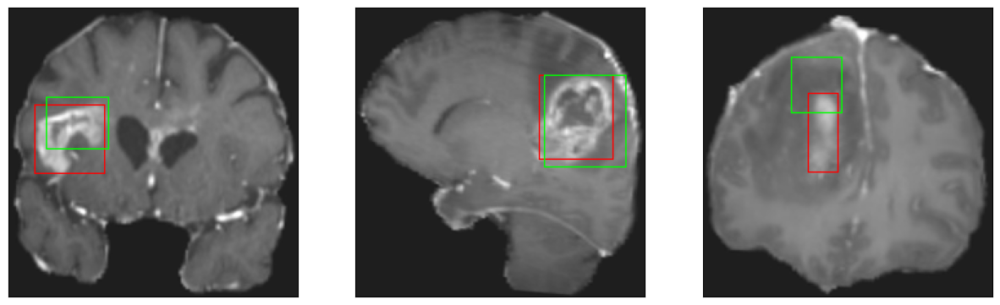

26/26 [==============================] - 3s 120ms/step - loss: 5.5019 - IoU: 0.5913 - val_loss: 11.4913 - val_IoU: 0.3961
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 5.3833 - IoU: 0.5936
Epoch 67: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


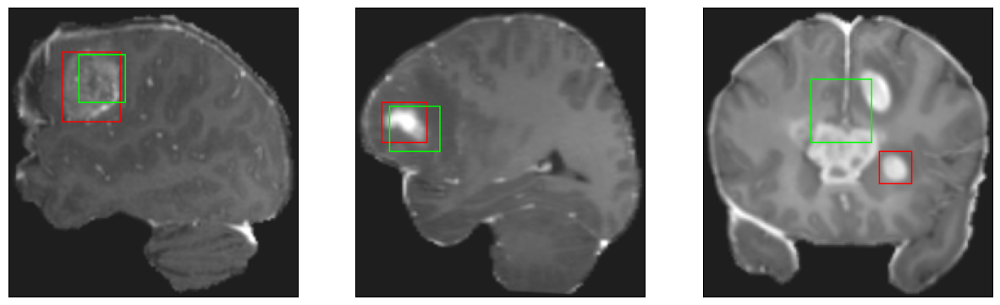

26/26 [==============================] - 3s 111ms/step - loss: 5.3833 - IoU: 0.5936 - val_loss: 9.6105 - val_IoU: 0.4615
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1835 - IoU: 0.6014
Epoch 68: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


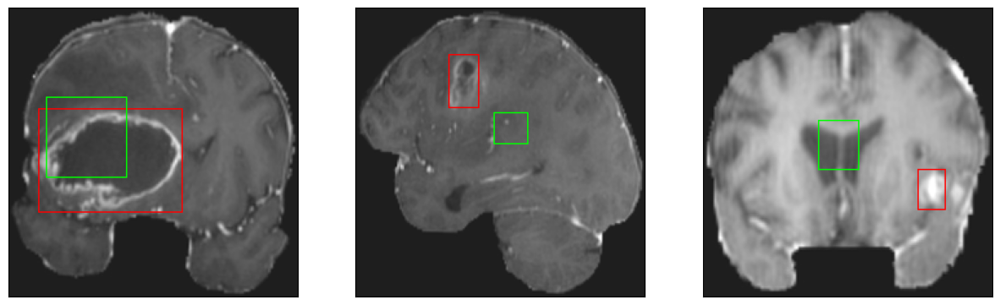

26/26 [==============================] - 3s 101ms/step - loss: 5.1969 - IoU: 0.6037 - val_loss: 10.1962 - val_IoU: 0.4289
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 5.4098 - IoU: 0.5926
Epoch 69: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


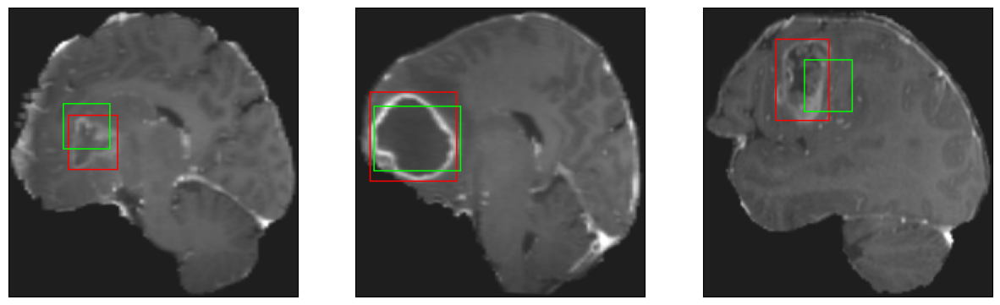

26/26 [==============================] - 3s 100ms/step - loss: 5.4098 - IoU: 0.5926 - val_loss: 9.1235 - val_IoU: 0.4722
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.4183 - IoU: 0.6026
Epoch 70: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


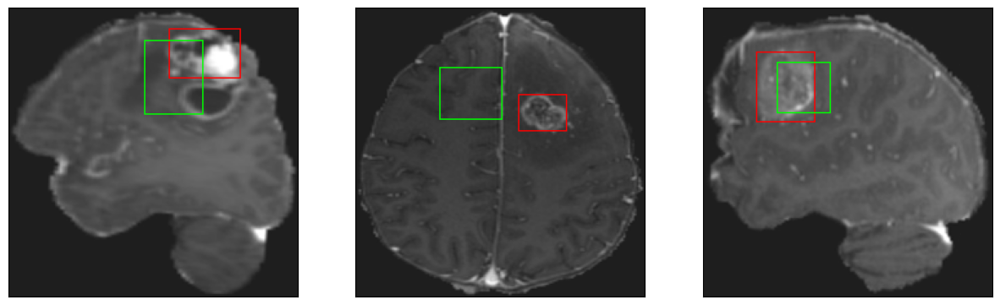

26/26 [==============================] - 3s 114ms/step - loss: 5.4183 - IoU: 0.6026 - val_loss: 9.4643 - val_IoU: 0.4505
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6493 - IoU: 0.5798
Epoch 71: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


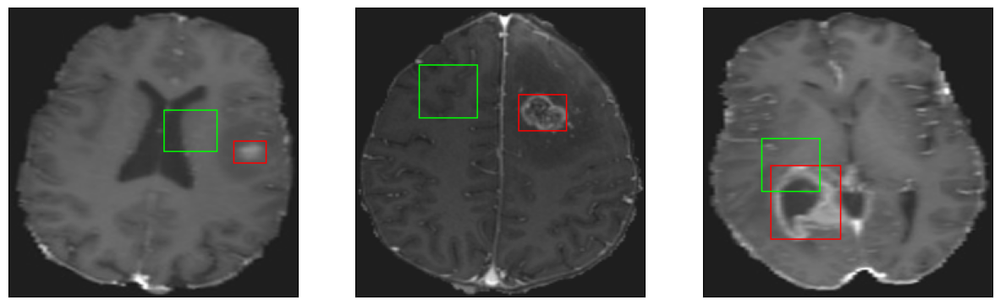

26/26 [==============================] - 3s 122ms/step - loss: 5.6411 - IoU: 0.5805 - val_loss: 11.1606 - val_IoU: 0.3888
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5801 - IoU: 0.5874
Epoch 72: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


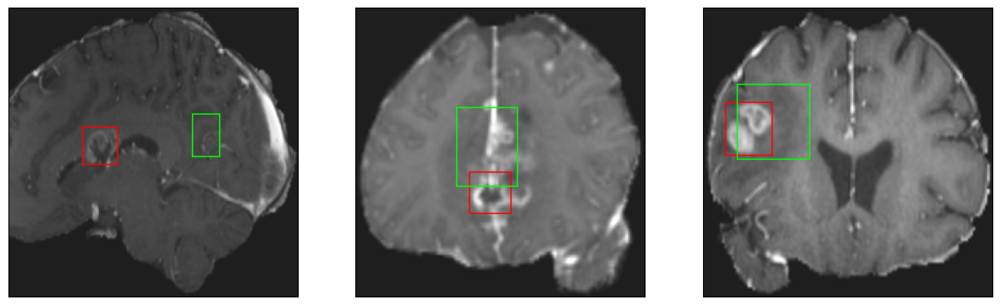

26/26 [==============================] - 3s 96ms/step - loss: 5.5899 - IoU: 0.5858 - val_loss: 12.8606 - val_IoU: 0.3532
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.4027 - IoU: 0.6046
Epoch 73: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


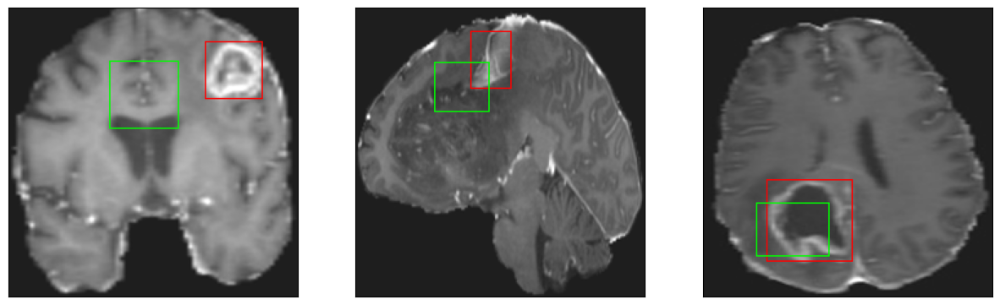

26/26 [==============================] - 2s 96ms/step - loss: 5.4027 - IoU: 0.6046 - val_loss: 13.5351 - val_IoU: 0.3214
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.2829 - IoU: 0.5991
Epoch 74: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


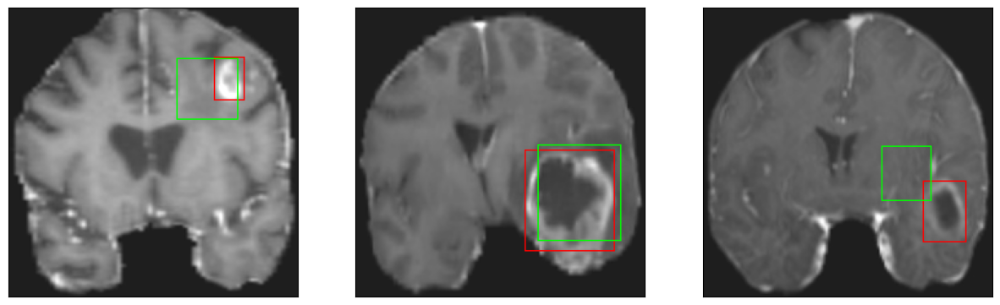

26/26 [==============================] - 2s 93ms/step - loss: 5.2829 - IoU: 0.5991 - val_loss: 10.0360 - val_IoU: 0.4669
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 5.5991 - IoU: 0.5835
Epoch 75: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


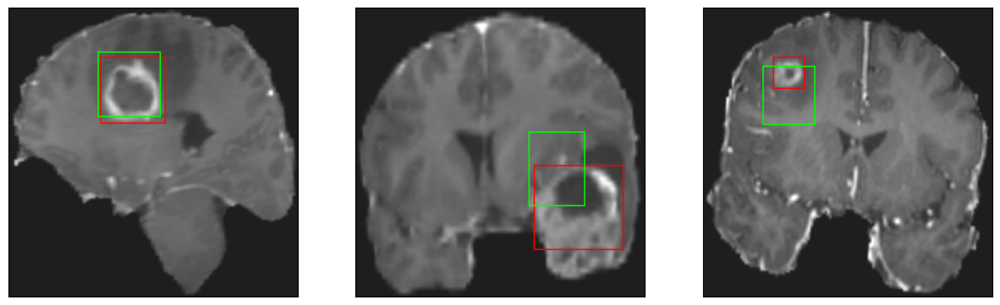

26/26 [==============================] - 3s 106ms/step - loss: 5.5991 - IoU: 0.5835 - val_loss: 9.6269 - val_IoU: 0.4603
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3282 - IoU: 0.5904
Epoch 76: val_loss did not improve from 9.01791
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


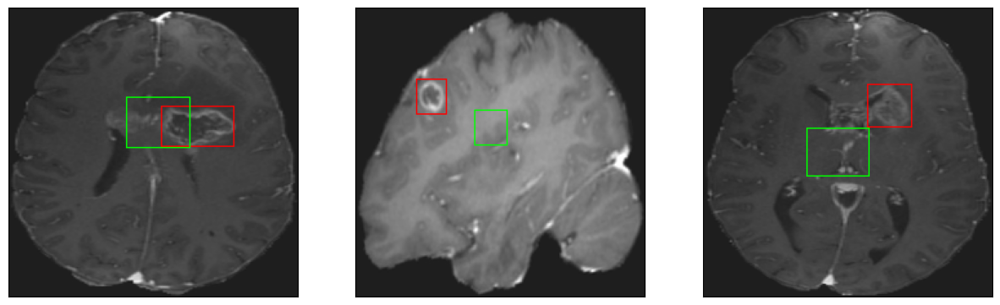

26/26 [==============================] - 3s 108ms/step - loss: 5.3765 - IoU: 0.5906 - val_loss: 9.2365 - val_IoU: 0.4588
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2523 - IoU: 0.5998
Epoch 77: val_loss improved from 9.01791 to 8.85480, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


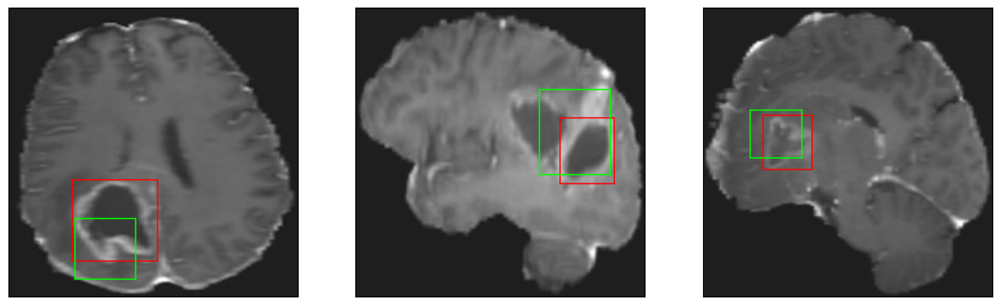

26/26 [==============================] - 3s 123ms/step - loss: 5.2606 - IoU: 0.6002 - val_loss: 8.8548 - val_IoU: 0.4775
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2926 - IoU: 0.5936
Epoch 78: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


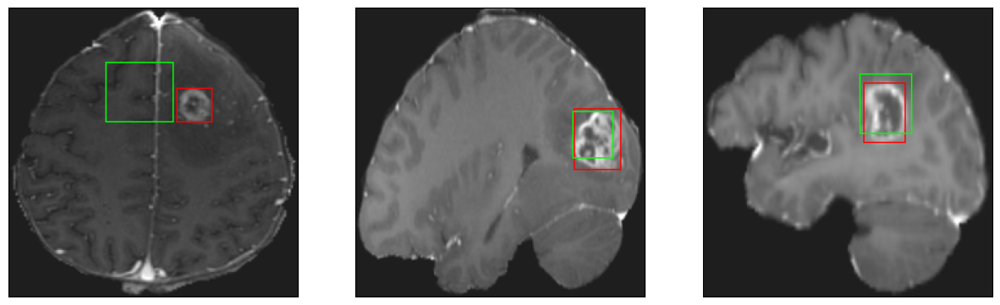

26/26 [==============================] - 3s 110ms/step - loss: 5.3032 - IoU: 0.5925 - val_loss: 9.9722 - val_IoU: 0.4167
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2539 - IoU: 0.6066
Epoch 79: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


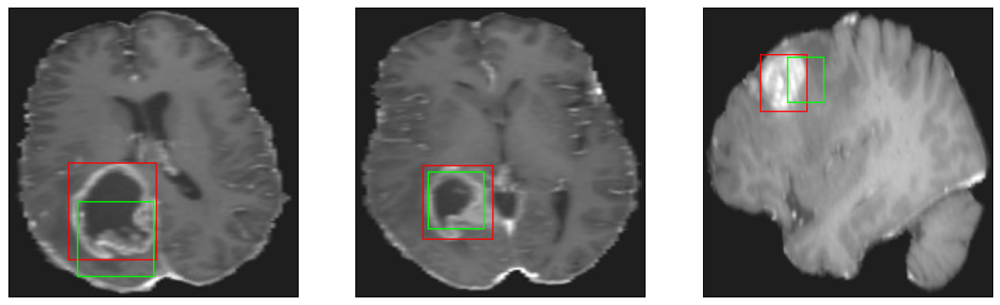

26/26 [==============================] - 3s 120ms/step - loss: 5.2842 - IoU: 0.6063 - val_loss: 9.2558 - val_IoU: 0.4675
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5539 - IoU: 0.5882
Epoch 80: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


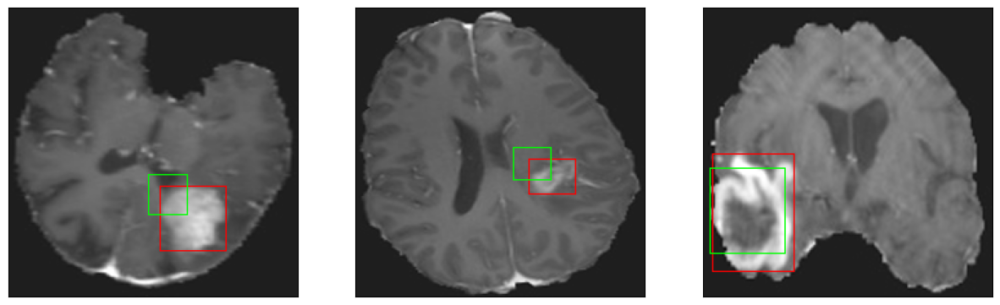

26/26 [==============================] - 3s 115ms/step - loss: 5.5837 - IoU: 0.5876 - val_loss: 9.9201 - val_IoU: 0.4337
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3890 - IoU: 0.5941
Epoch 81: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


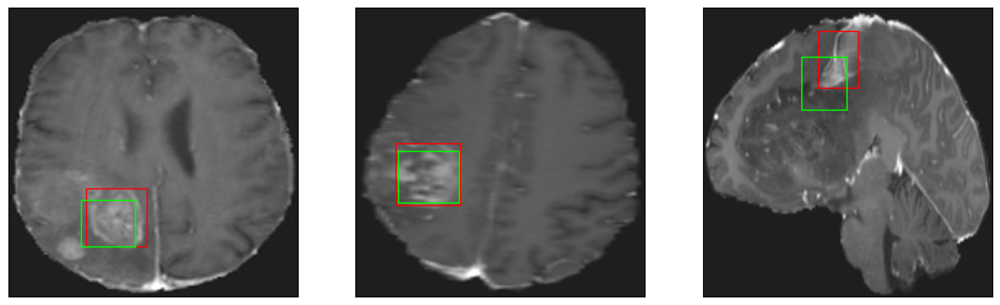

26/26 [==============================] - 3s 115ms/step - loss: 5.3436 - IoU: 0.5948 - val_loss: 9.6814 - val_IoU: 0.4454
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2191 - IoU: 0.6094
Epoch 82: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


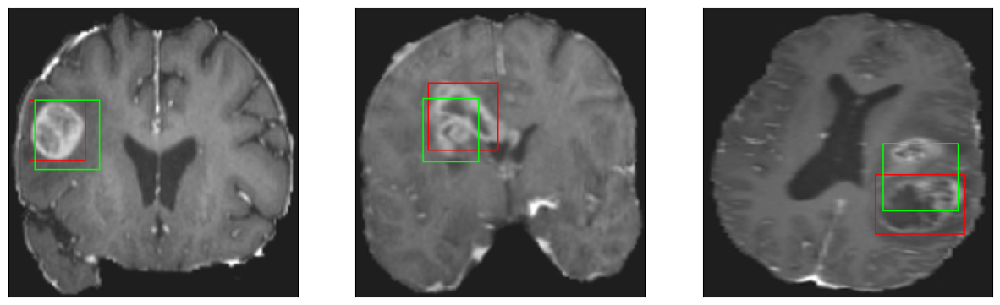

26/26 [==============================] - 3s 100ms/step - loss: 5.2163 - IoU: 0.6092 - val_loss: 9.0093 - val_IoU: 0.4916
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1751 - IoU: 0.6080
Epoch 83: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


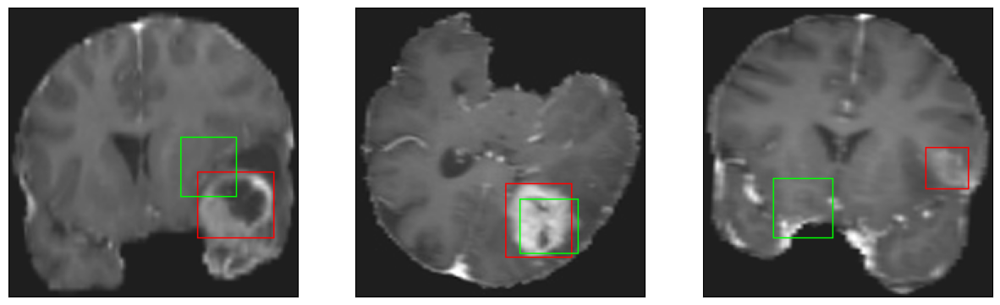

26/26 [==============================] - 3s 108ms/step - loss: 5.1707 - IoU: 0.6090 - val_loss: 9.4045 - val_IoU: 0.4780
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 5.3103 - IoU: 0.5972
Epoch 84: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


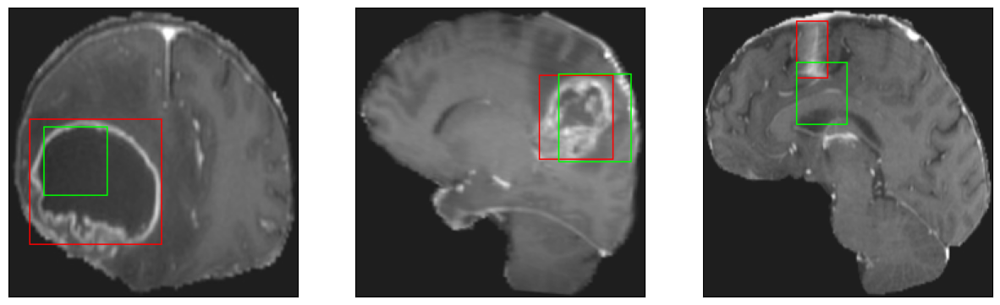

26/26 [==============================] - 3s 115ms/step - loss: 5.3103 - IoU: 0.5972 - val_loss: 9.9986 - val_IoU: 0.4079
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 5.3715 - IoU: 0.5989
Epoch 85: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


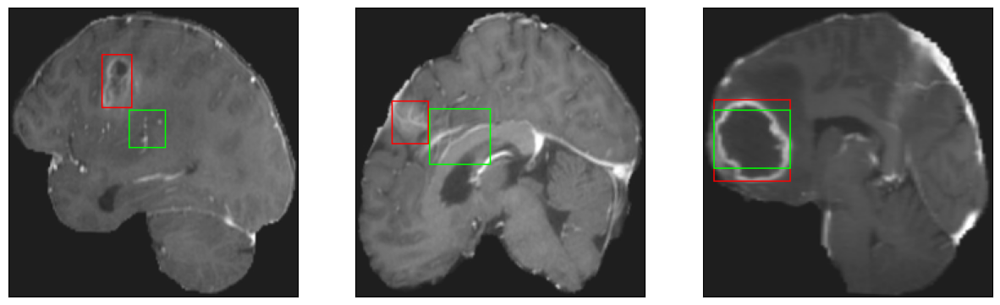

26/26 [==============================] - 3s 116ms/step - loss: 5.3715 - IoU: 0.5989 - val_loss: 9.3313 - val_IoU: 0.4557
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1776 - IoU: 0.6154
Epoch 86: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


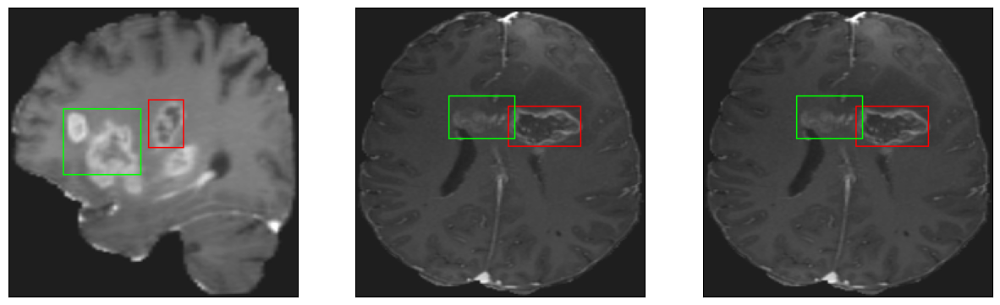

26/26 [==============================] - 3s 121ms/step - loss: 5.1299 - IoU: 0.6159 - val_loss: 9.4292 - val_IoU: 0.4664
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1075 - IoU: 0.6139
Epoch 87: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


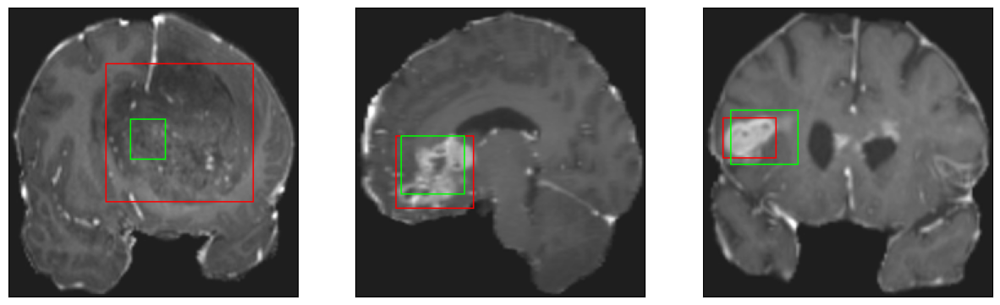

26/26 [==============================] - 3s 115ms/step - loss: 5.1037 - IoU: 0.6138 - val_loss: 8.9506 - val_IoU: 0.4851
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1668 - IoU: 0.6103
Epoch 88: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


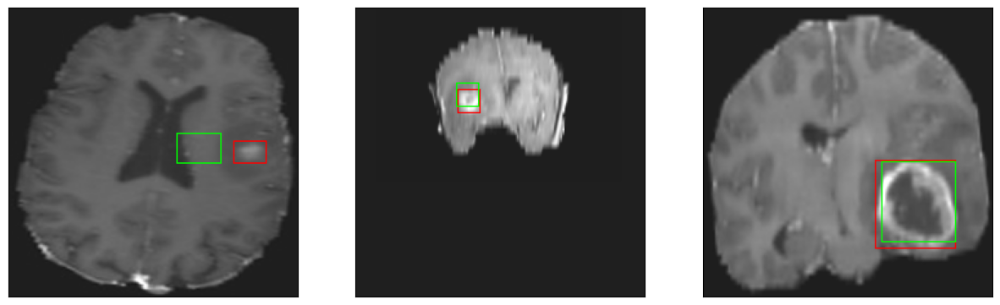

26/26 [==============================] - 3s 103ms/step - loss: 5.1588 - IoU: 0.6103 - val_loss: 9.6829 - val_IoU: 0.4434
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2778 - IoU: 0.6015
Epoch 89: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


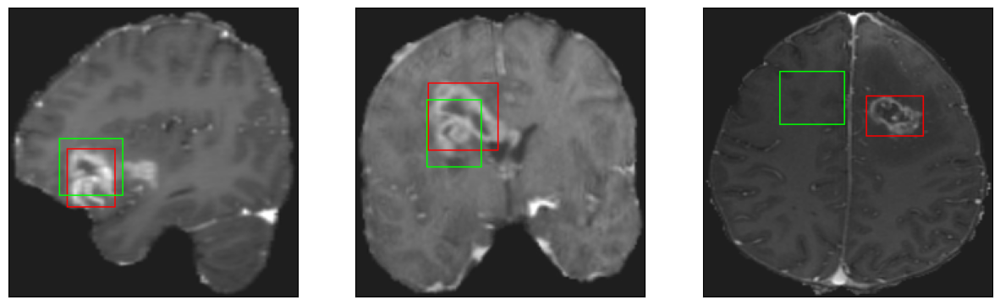

26/26 [==============================] - 3s 102ms/step - loss: 5.2434 - IoU: 0.6024 - val_loss: 9.1479 - val_IoU: 0.4780
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1250 - IoU: 0.6057
Epoch 90: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


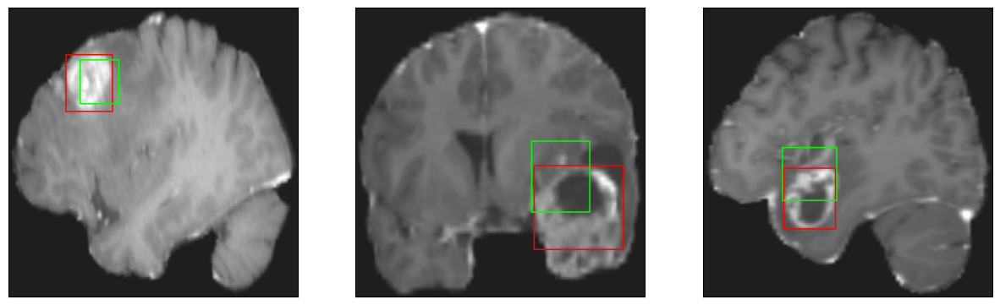

26/26 [==============================] - 3s 113ms/step - loss: 5.1251 - IoU: 0.6055 - val_loss: 8.9782 - val_IoU: 0.4839
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 5.1660 - IoU: 0.6081
Epoch 91: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


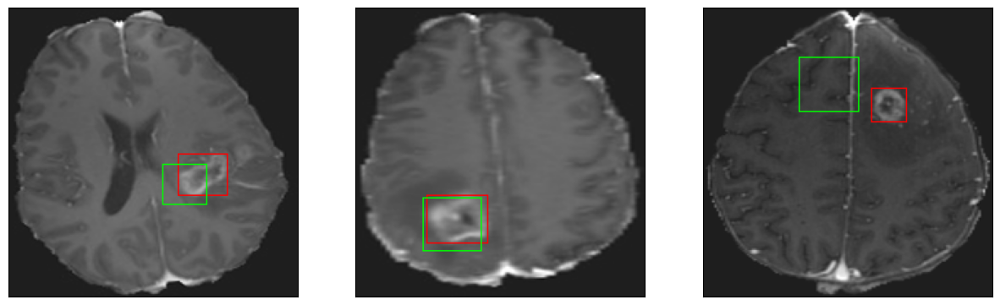

26/26 [==============================] - 3s 104ms/step - loss: 5.1660 - IoU: 0.6081 - val_loss: 9.1066 - val_IoU: 0.4859
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2814 - IoU: 0.5993
Epoch 92: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


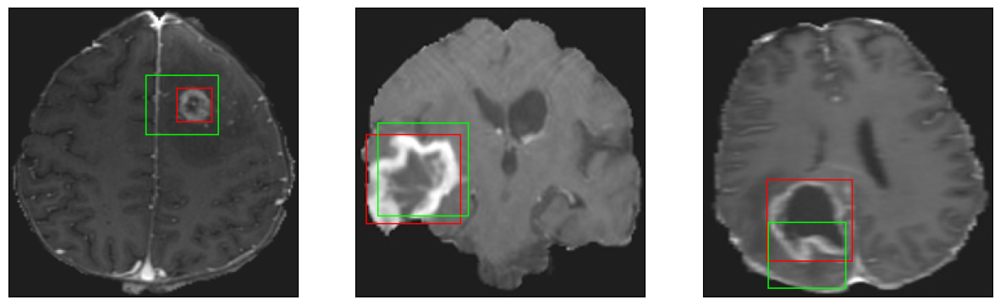

26/26 [==============================] - 3s 105ms/step - loss: 5.2853 - IoU: 0.6002 - val_loss: 12.2830 - val_IoU: 0.3882
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.9549 - IoU: 0.6210
Epoch 93: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


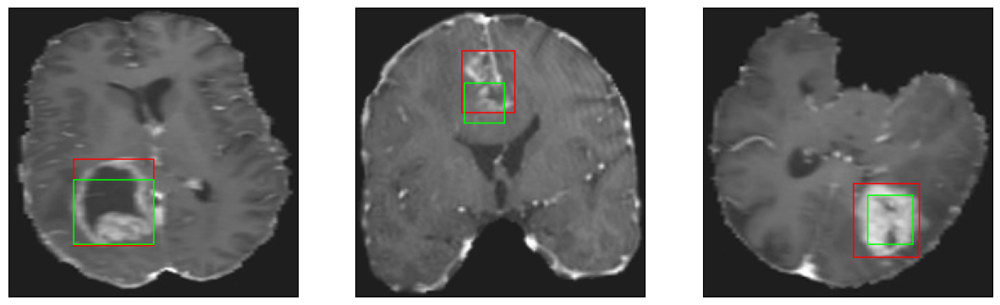

26/26 [==============================] - 3s 99ms/step - loss: 4.9549 - IoU: 0.6210 - val_loss: 8.8822 - val_IoU: 0.4909
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.9395 - IoU: 0.6143
Epoch 94: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


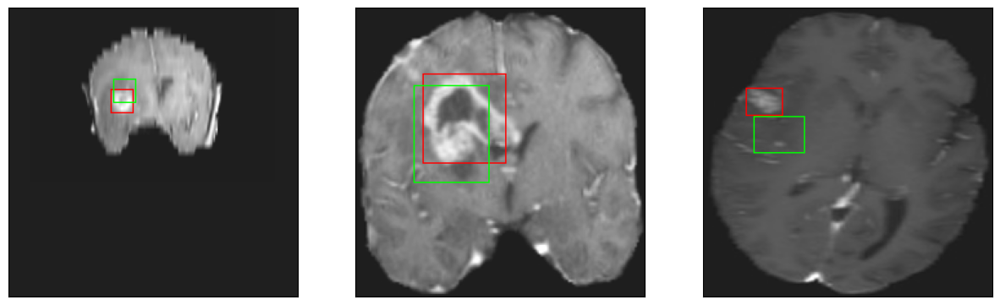

26/26 [==============================] - 3s 114ms/step - loss: 4.9395 - IoU: 0.6143 - val_loss: 9.5009 - val_IoU: 0.4700
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9111 - IoU: 0.6123
Epoch 95: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


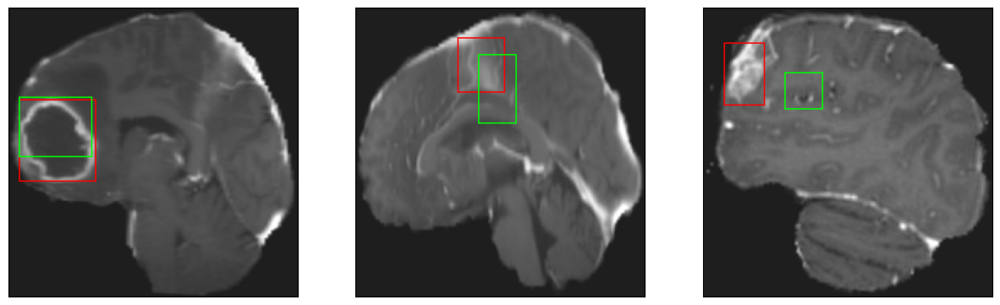

26/26 [==============================] - 3s 102ms/step - loss: 4.9078 - IoU: 0.6140 - val_loss: 9.2379 - val_IoU: 0.4625
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0431 - IoU: 0.6125
Epoch 96: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


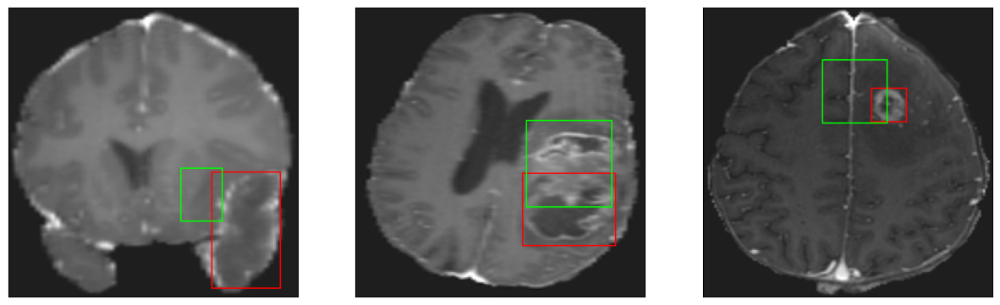

26/26 [==============================] - 3s 100ms/step - loss: 5.0463 - IoU: 0.6116 - val_loss: 9.3426 - val_IoU: 0.4657
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 4.8584 - IoU: 0.6265
Epoch 97: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


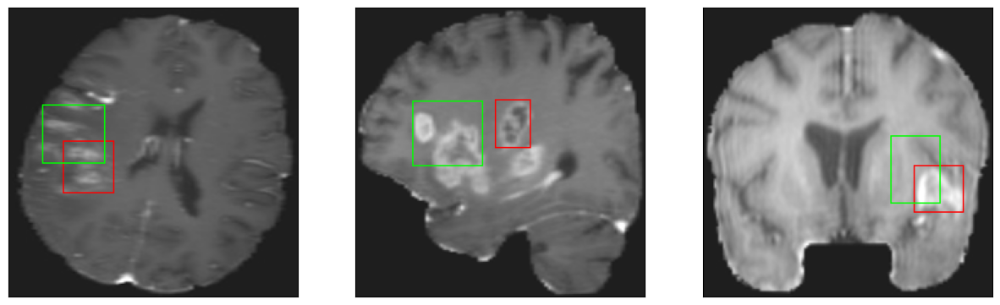

26/26 [==============================] - 3s 110ms/step - loss: 4.8584 - IoU: 0.6265 - val_loss: 9.2175 - val_IoU: 0.4734
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 5.1283 - IoU: 0.6039
Epoch 98: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


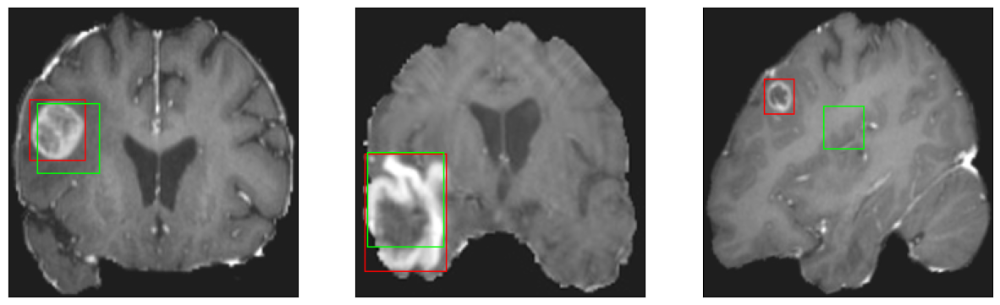

26/26 [==============================] - 3s 132ms/step - loss: 5.1283 - IoU: 0.6039 - val_loss: 9.0069 - val_IoU: 0.4892
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.9057 - IoU: 0.6241
Epoch 99: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


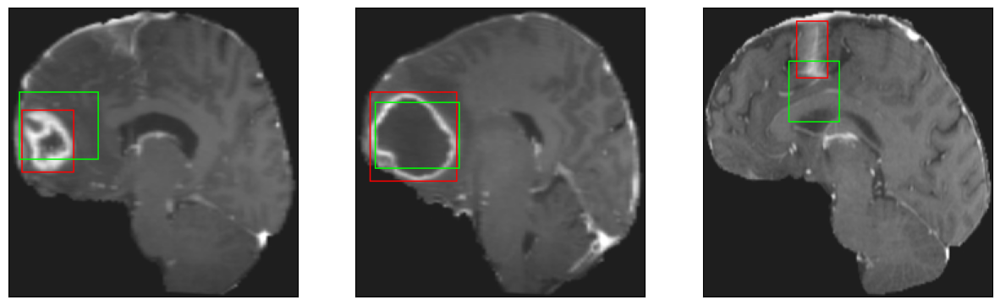

26/26 [==============================] - 3s 98ms/step - loss: 4.9057 - IoU: 0.6241 - val_loss: 13.5822 - val_IoU: 0.3359
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8953 - IoU: 0.6294
Epoch 100: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


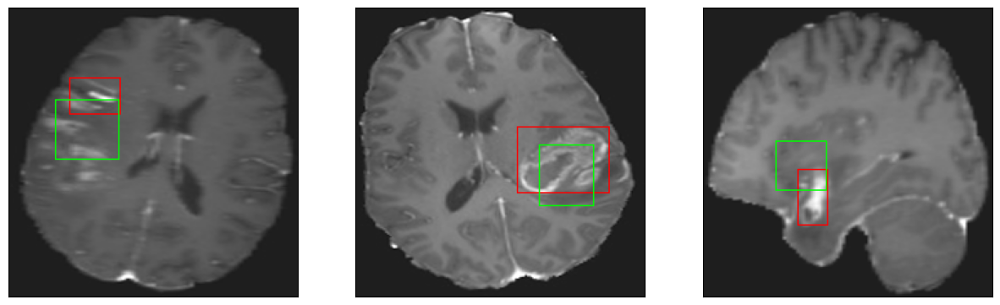

26/26 [==============================] - 3s 120ms/step - loss: 4.8935 - IoU: 0.6285 - val_loss: 9.4804 - val_IoU: 0.4573
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.9299 - IoU: 0.6229
Epoch 101: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


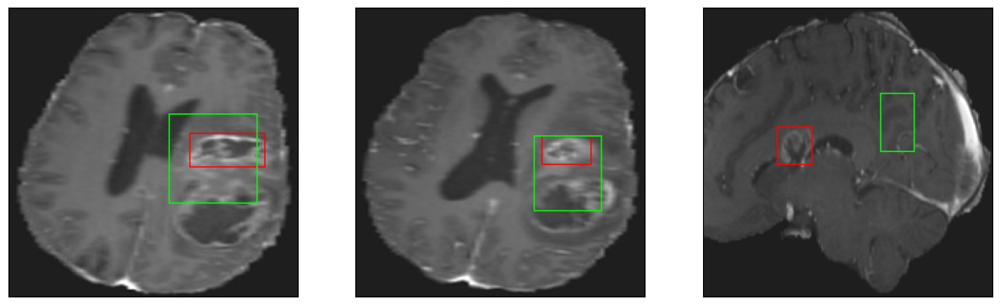

26/26 [==============================] - 3s 98ms/step - loss: 4.9299 - IoU: 0.6229 - val_loss: 9.3362 - val_IoU: 0.4722
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9210 - IoU: 0.6165
Epoch 102: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


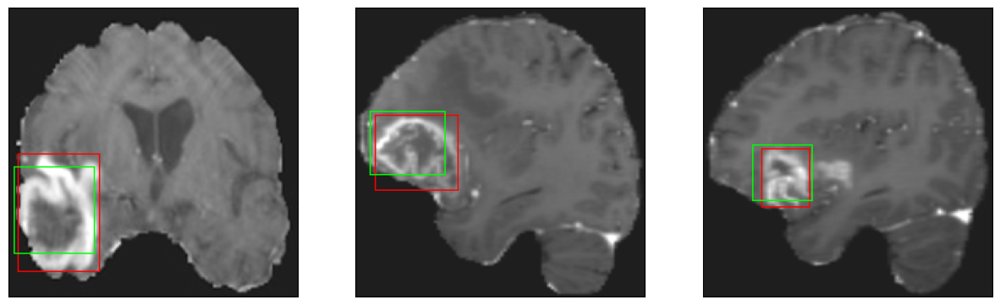

26/26 [==============================] - 3s 126ms/step - loss: 4.9136 - IoU: 0.6173 - val_loss: 9.0884 - val_IoU: 0.4762
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9798 - IoU: 0.6188
Epoch 103: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


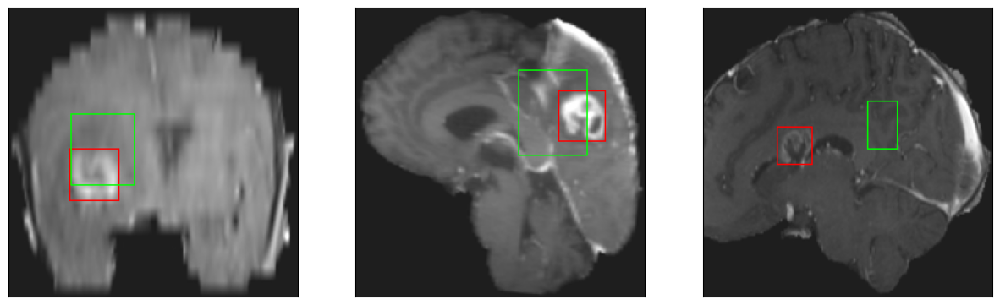

26/26 [==============================] - 3s 112ms/step - loss: 4.9840 - IoU: 0.6185 - val_loss: 12.4576 - val_IoU: 0.3689
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.8598 - IoU: 0.6250
Epoch 104: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


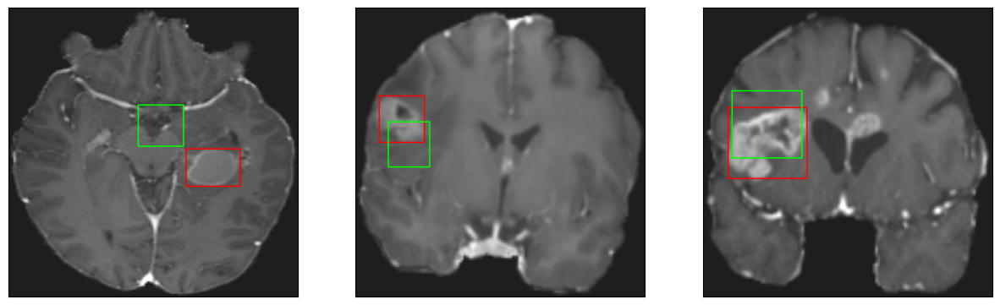

26/26 [==============================] - 3s 105ms/step - loss: 4.8598 - IoU: 0.6250 - val_loss: 9.0735 - val_IoU: 0.4743
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9324 - IoU: 0.6247
Epoch 105: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


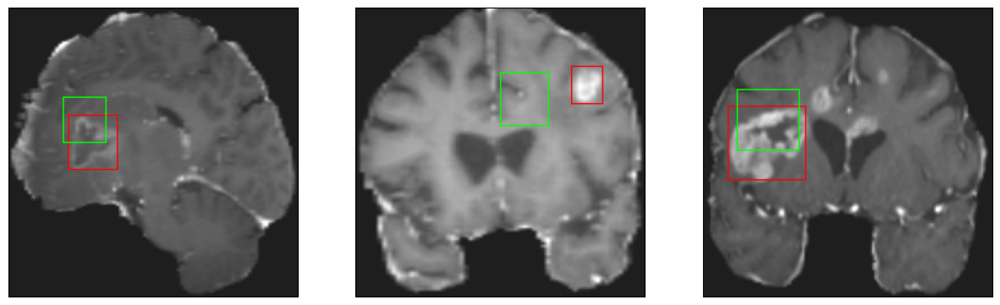

26/26 [==============================] - 3s 119ms/step - loss: 4.9481 - IoU: 0.6237 - val_loss: 9.4946 - val_IoU: 0.4486
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9354 - IoU: 0.6214
Epoch 106: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


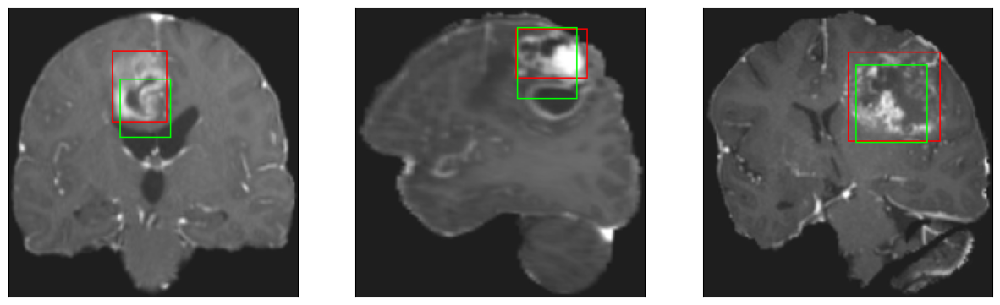

26/26 [==============================] - 3s 119ms/step - loss: 4.9205 - IoU: 0.6231 - val_loss: 9.4056 - val_IoU: 0.4596
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1492 - IoU: 0.6105
Epoch 107: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 11ms/step
4


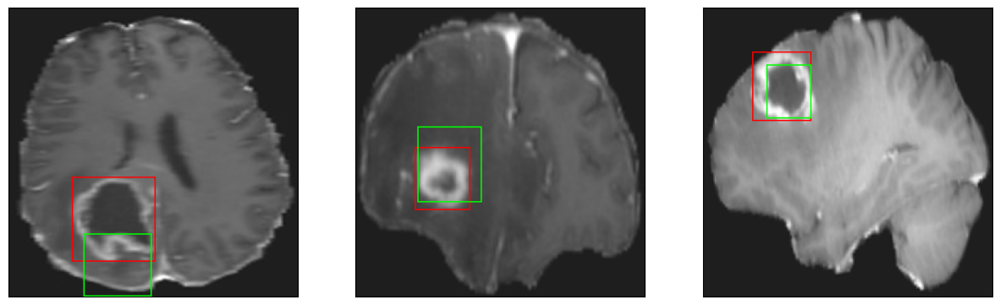

26/26 [==============================] - 3s 98ms/step - loss: 5.1455 - IoU: 0.6104 - val_loss: 9.2168 - val_IoU: 0.4647
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7083 - IoU: 0.6310
Epoch 108: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


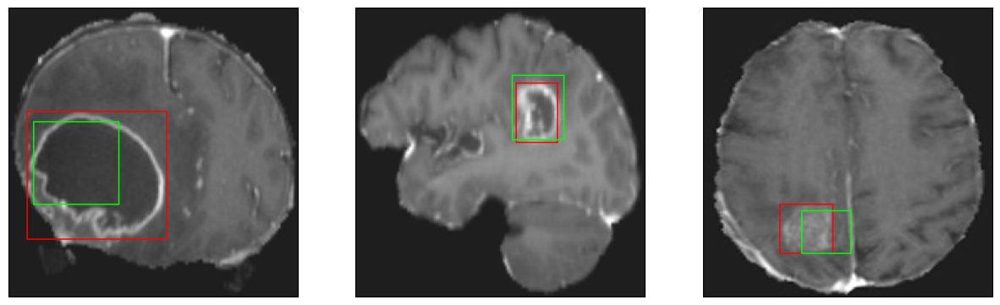

26/26 [==============================] - 3s 106ms/step - loss: 4.7229 - IoU: 0.6301 - val_loss: 9.1793 - val_IoU: 0.4927
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8080 - IoU: 0.6250
Epoch 109: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


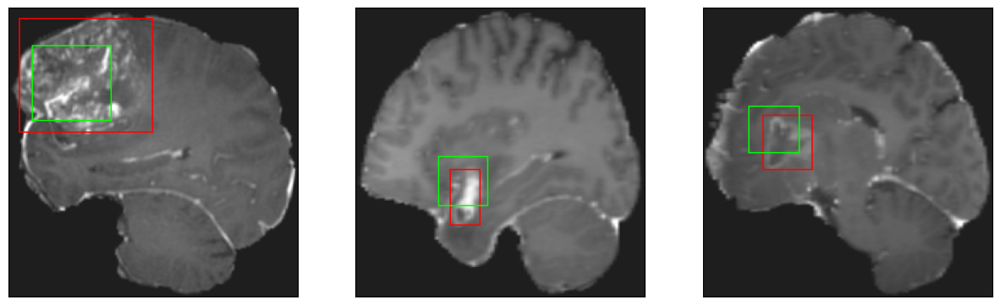

26/26 [==============================] - 3s 106ms/step - loss: 4.8558 - IoU: 0.6241 - val_loss: 9.6049 - val_IoU: 0.4753
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8996 - IoU: 0.6190
Epoch 110: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


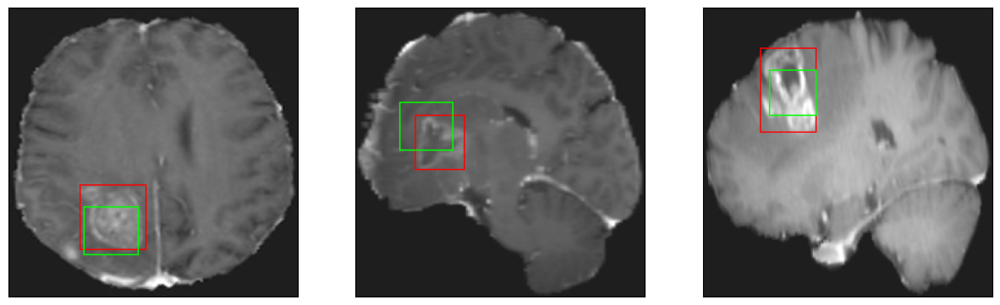

26/26 [==============================] - 3s 115ms/step - loss: 4.8858 - IoU: 0.6213 - val_loss: 9.3304 - val_IoU: 0.4739
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9158 - IoU: 0.6226
Epoch 111: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


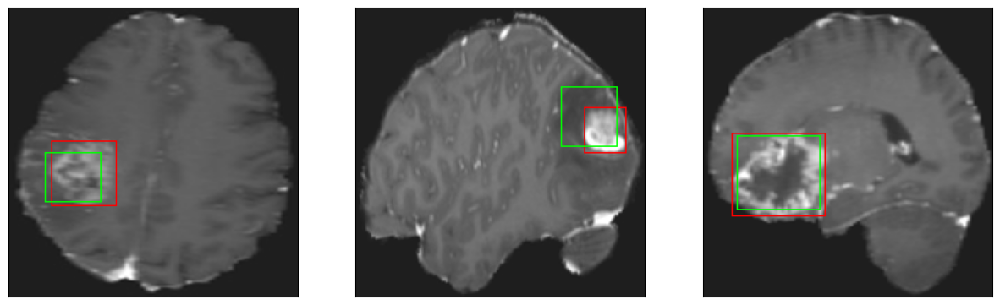

26/26 [==============================] - 2s 93ms/step - loss: 4.9109 - IoU: 0.6217 - val_loss: 9.6420 - val_IoU: 0.4590
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6316 - IoU: 0.6365
Epoch 112: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


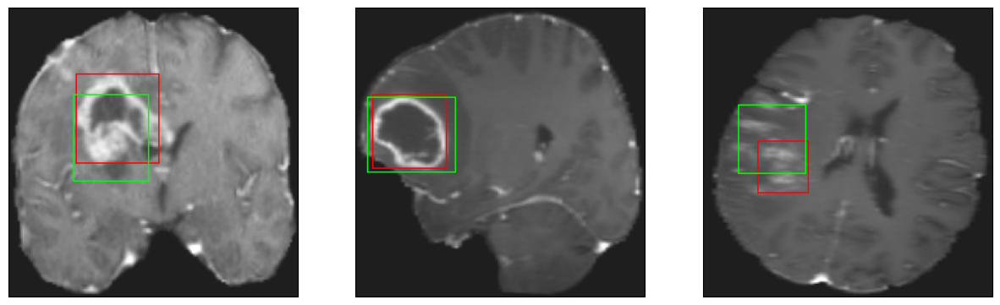

26/26 [==============================] - 3s 100ms/step - loss: 4.6478 - IoU: 0.6372 - val_loss: 9.1034 - val_IoU: 0.4903
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7692 - IoU: 0.6305
Epoch 113: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


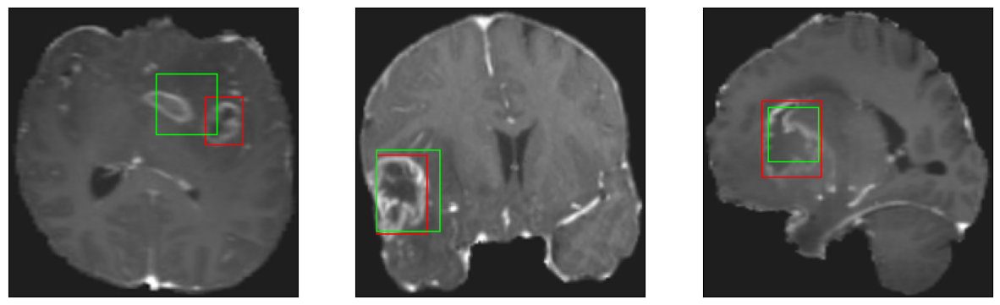

26/26 [==============================] - 3s 99ms/step - loss: 4.7777 - IoU: 0.6290 - val_loss: 9.4069 - val_IoU: 0.4737
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.8915 - IoU: 0.6275
Epoch 114: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


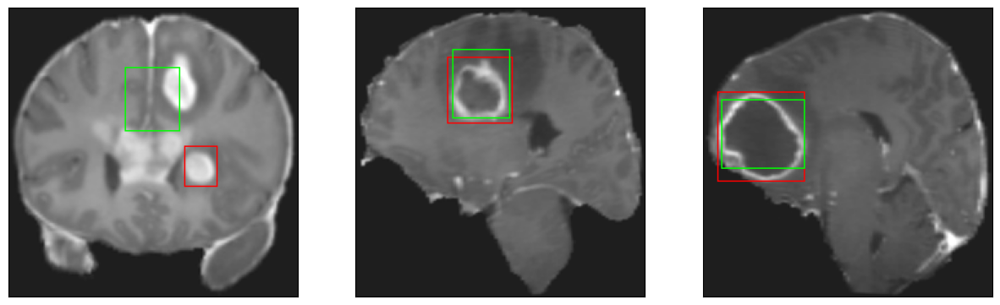

26/26 [==============================] - 3s 118ms/step - loss: 4.8915 - IoU: 0.6275 - val_loss: 8.8836 - val_IoU: 0.4826
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6827 - IoU: 0.6379
Epoch 115: val_loss did not improve from 8.85480
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


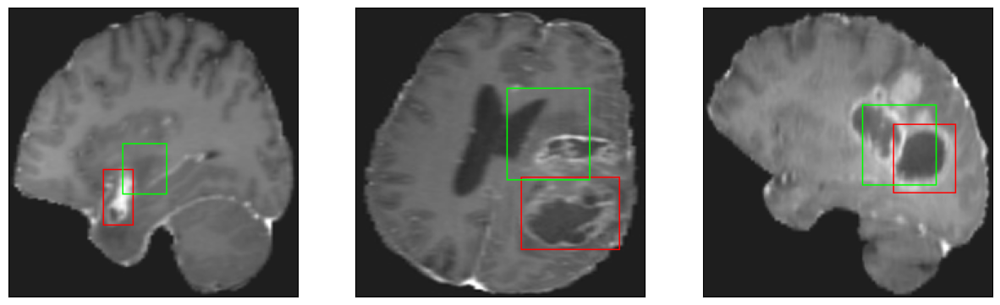

26/26 [==============================] - 3s 108ms/step - loss: 4.6477 - IoU: 0.6377 - val_loss: 12.8351 - val_IoU: 0.3467
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7859 - IoU: 0.6322
Epoch 116: val_loss improved from 8.85480 to 8.77250, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


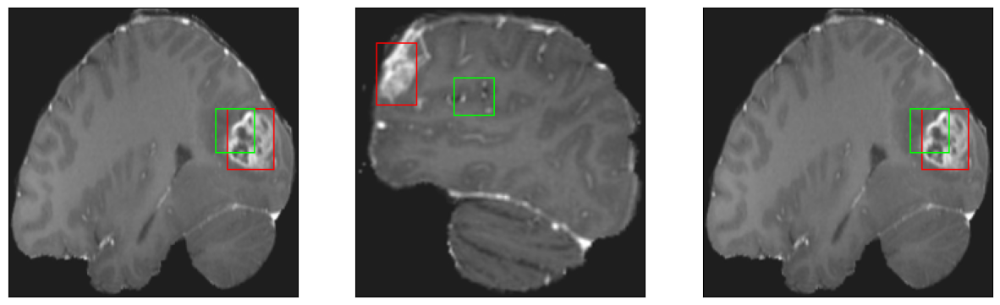

26/26 [==============================] - 3s 122ms/step - loss: 4.8486 - IoU: 0.6306 - val_loss: 8.7725 - val_IoU: 0.4857
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8973 - IoU: 0.6235
Epoch 117: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


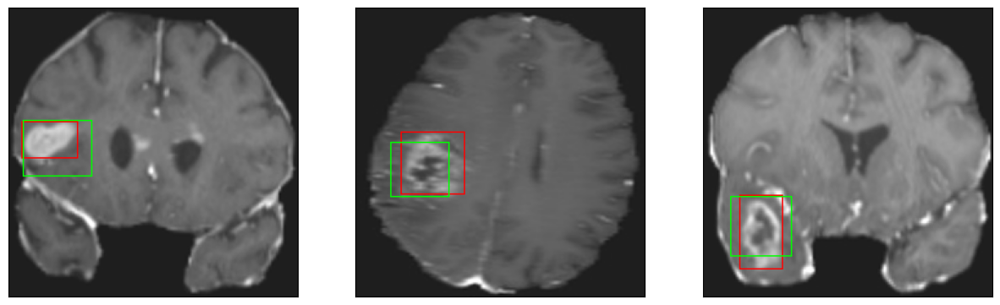

26/26 [==============================] - 3s 107ms/step - loss: 4.9109 - IoU: 0.6237 - val_loss: 9.2095 - val_IoU: 0.4919
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.9163 - IoU: 0.6207
Epoch 118: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


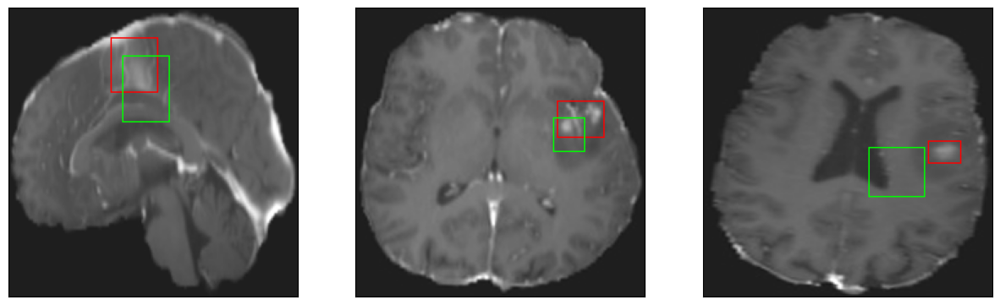

26/26 [==============================] - 3s 119ms/step - loss: 4.9163 - IoU: 0.6207 - val_loss: 10.0473 - val_IoU: 0.4384
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.9423 - IoU: 0.6256
Epoch 119: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


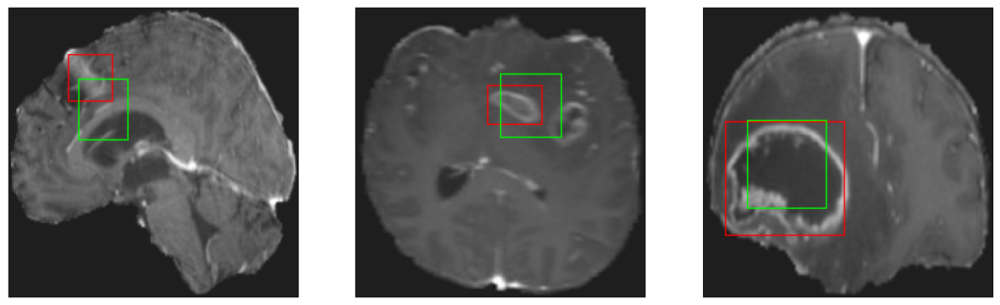

26/26 [==============================] - 3s 101ms/step - loss: 4.9423 - IoU: 0.6256 - val_loss: 9.1498 - val_IoU: 0.4948
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6845 - IoU: 0.6354
Epoch 120: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


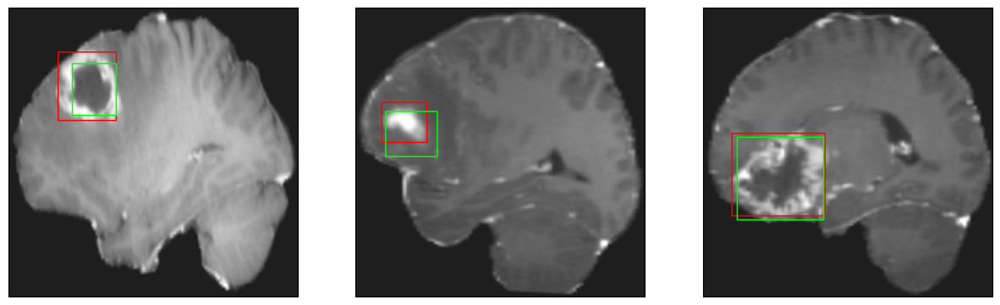

26/26 [==============================] - 3s 121ms/step - loss: 4.6555 - IoU: 0.6358 - val_loss: 9.1048 - val_IoU: 0.4811
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.8669 - IoU: 0.6189
Epoch 121: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


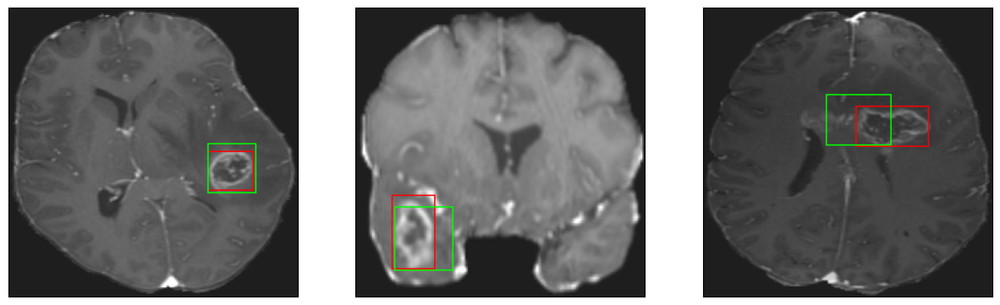

26/26 [==============================] - 3s 128ms/step - loss: 4.8669 - IoU: 0.6189 - val_loss: 9.0081 - val_IoU: 0.4757
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7784 - IoU: 0.6310
Epoch 122: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


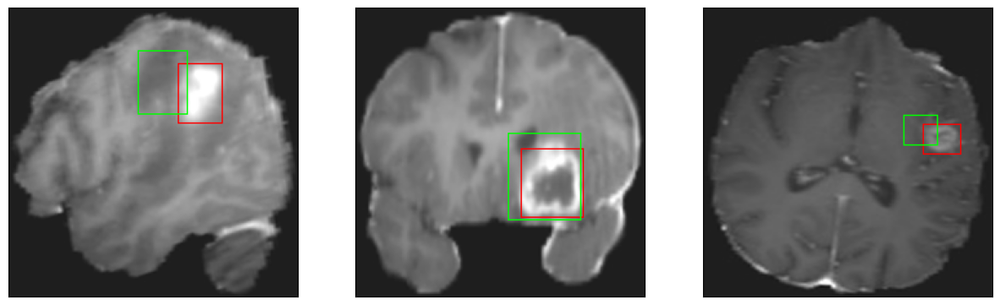

26/26 [==============================] - 3s 106ms/step - loss: 4.7379 - IoU: 0.6335 - val_loss: 9.8235 - val_IoU: 0.4367
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 4.7909 - IoU: 0.6281
Epoch 123: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


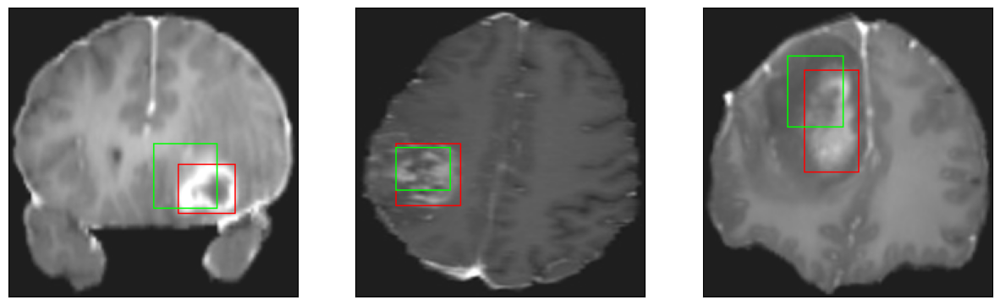

26/26 [==============================] - 2s 94ms/step - loss: 4.7909 - IoU: 0.6281 - val_loss: 9.1849 - val_IoU: 0.4822
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6025 - IoU: 0.6399
Epoch 124: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


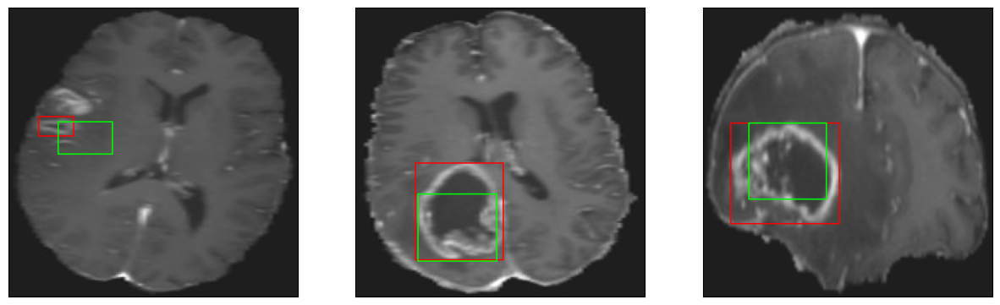

26/26 [==============================] - 3s 107ms/step - loss: 4.6503 - IoU: 0.6371 - val_loss: 9.5306 - val_IoU: 0.4537
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7858 - IoU: 0.6305
Epoch 125: val_loss did not improve from 8.77250
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


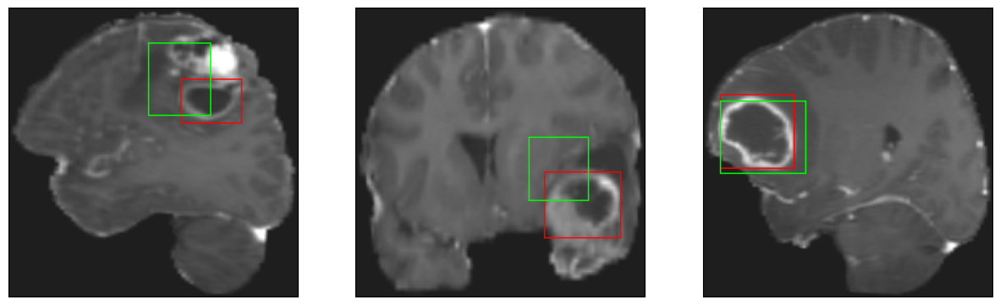

26/26 [==============================] - 3s 108ms/step - loss: 4.7963 - IoU: 0.6320 - val_loss: 9.7599 - val_IoU: 0.4731
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8310 - IoU: 0.6334
Epoch 126: val_loss improved from 8.77250 to 8.70292, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


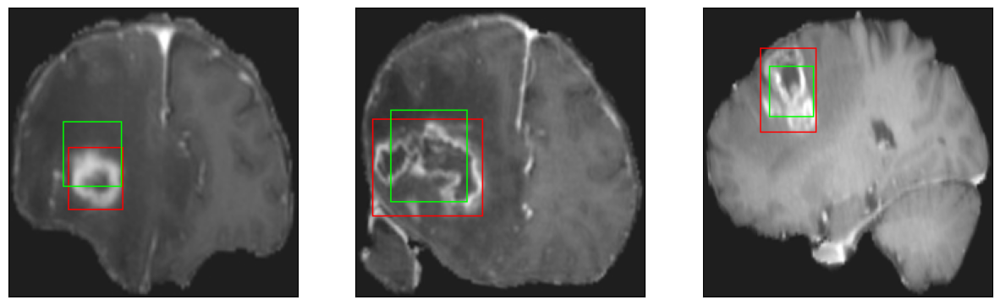

26/26 [==============================] - 3s 123ms/step - loss: 4.8503 - IoU: 0.6310 - val_loss: 8.7029 - val_IoU: 0.4955
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.7967 - IoU: 0.6295
Epoch 127: val_loss did not improve from 8.70292
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


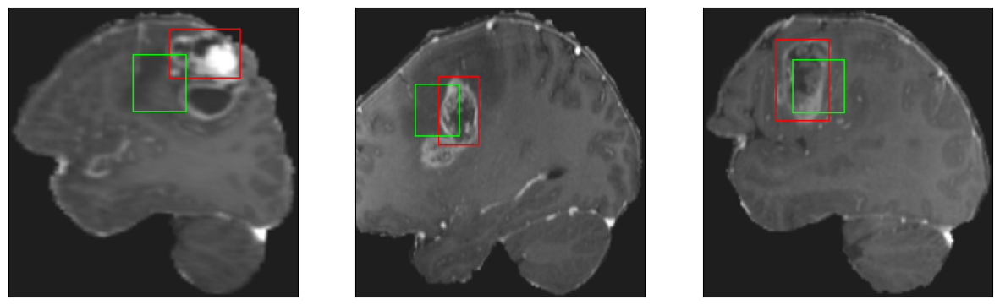

26/26 [==============================] - 3s 106ms/step - loss: 4.7967 - IoU: 0.6295 - val_loss: 9.2922 - val_IoU: 0.4934
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7098 - IoU: 0.6325
Epoch 128: val_loss improved from 8.70292 to 8.59927, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


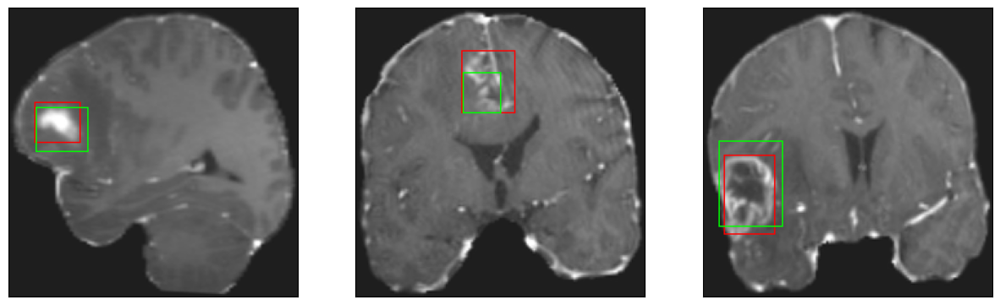

26/26 [==============================] - 3s 131ms/step - loss: 4.6755 - IoU: 0.6358 - val_loss: 8.5993 - val_IoU: 0.5094
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6926 - IoU: 0.6367
Epoch 129: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


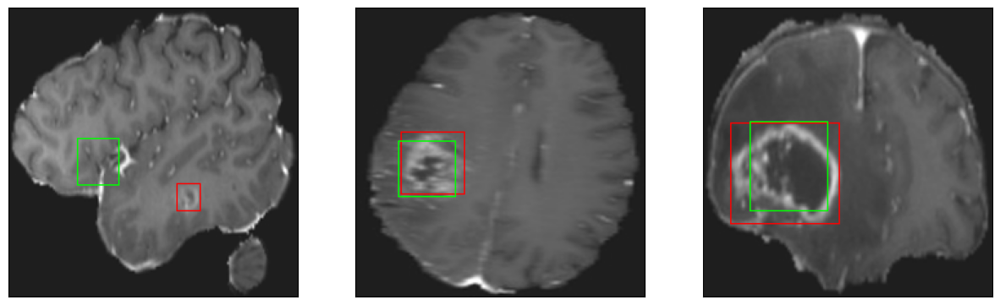

26/26 [==============================] - 3s 106ms/step - loss: 4.6836 - IoU: 0.6366 - val_loss: 9.3994 - val_IoU: 0.4671
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7334 - IoU: 0.6382
Epoch 130: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


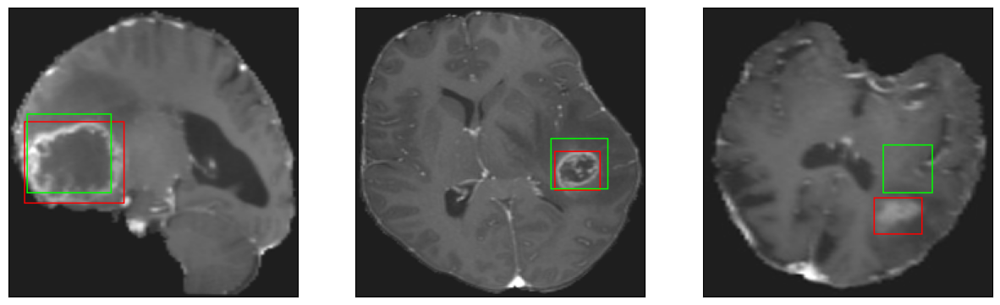

26/26 [==============================] - 2s 93ms/step - loss: 4.7359 - IoU: 0.6373 - val_loss: 8.7349 - val_IoU: 0.4908
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6814 - IoU: 0.6391
Epoch 131: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


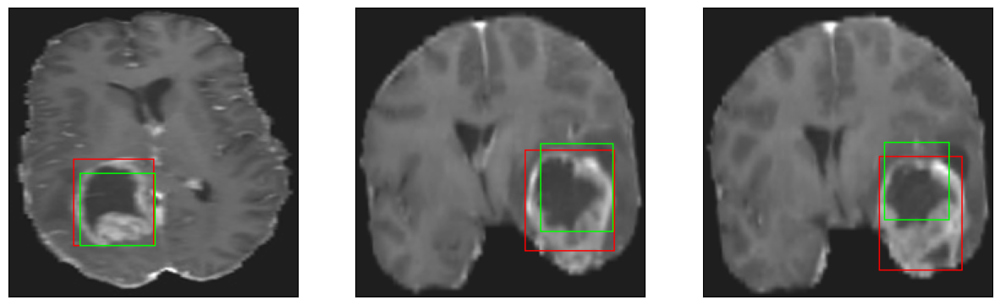

26/26 [==============================] - 3s 102ms/step - loss: 4.6335 - IoU: 0.6412 - val_loss: 9.1877 - val_IoU: 0.4820
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.4557 - IoU: 0.6491
Epoch 132: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


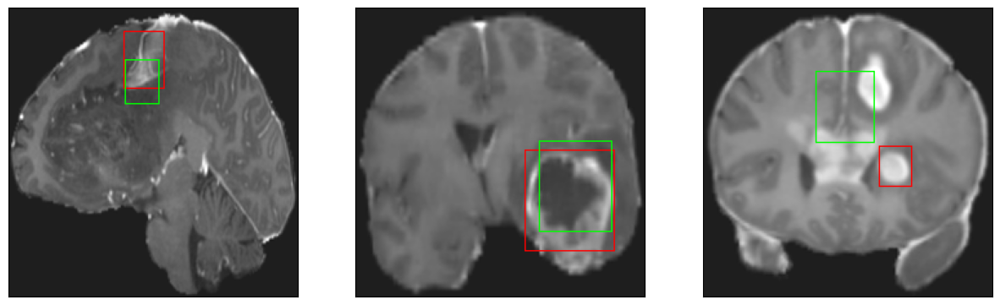

26/26 [==============================] - 3s 124ms/step - loss: 4.4557 - IoU: 0.6491 - val_loss: 9.0356 - val_IoU: 0.4804
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.5347 - IoU: 0.6424
Epoch 133: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


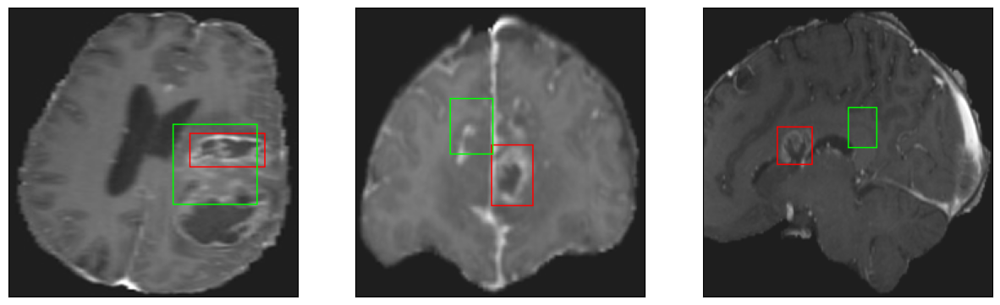

26/26 [==============================] - 3s 102ms/step - loss: 4.5347 - IoU: 0.6424 - val_loss: 8.9983 - val_IoU: 0.4734
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7290 - IoU: 0.6342
Epoch 134: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


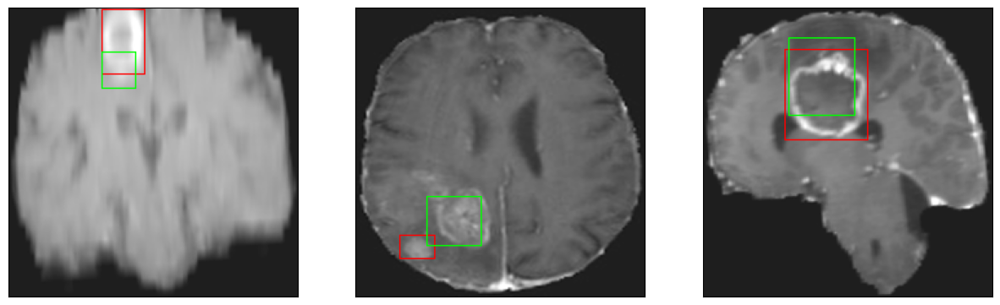

26/26 [==============================] - 3s 98ms/step - loss: 4.7025 - IoU: 0.6356 - val_loss: 9.2730 - val_IoU: 0.4615
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5124 - IoU: 0.6453
Epoch 135: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


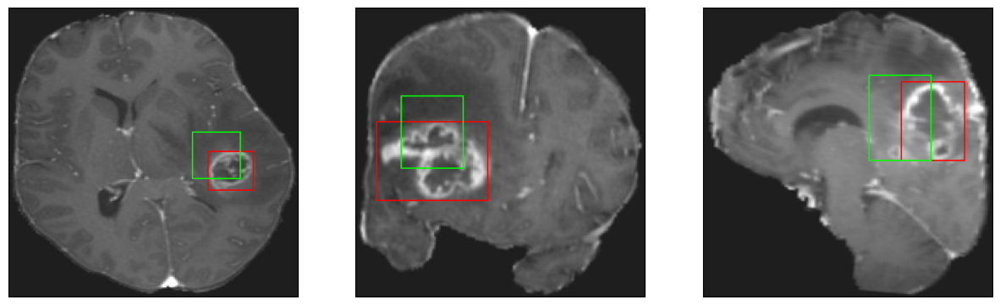

26/26 [==============================] - 3s 118ms/step - loss: 4.5738 - IoU: 0.6413 - val_loss: 10.6034 - val_IoU: 0.3941
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.4873 - IoU: 0.6527
Epoch 136: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


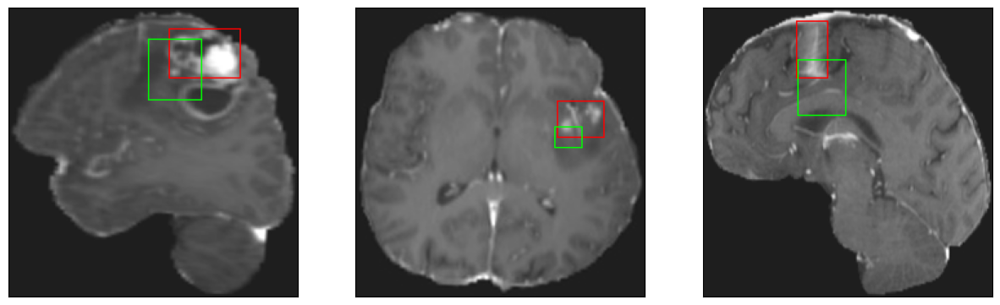

26/26 [==============================] - 2s 95ms/step - loss: 4.4873 - IoU: 0.6527 - val_loss: 8.9521 - val_IoU: 0.4755
Epoch 137/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6615 - IoU: 0.6378
Epoch 137: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


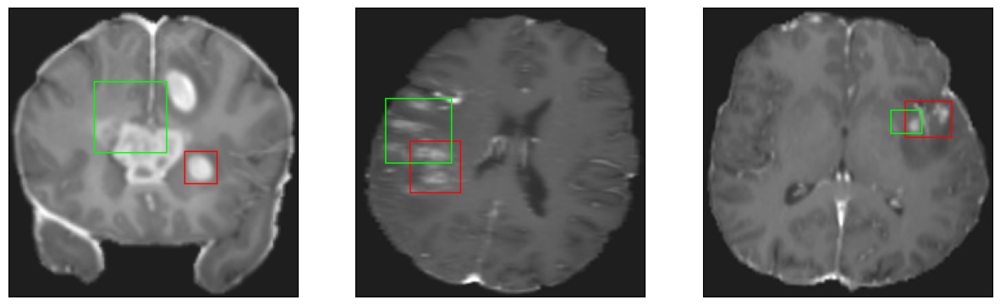

26/26 [==============================] - 3s 97ms/step - loss: 4.6491 - IoU: 0.6391 - val_loss: 9.1805 - val_IoU: 0.4839
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6807 - IoU: 0.6367
Epoch 138: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


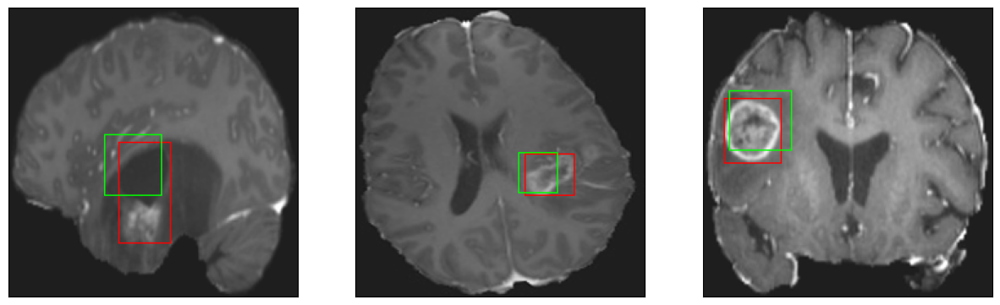

26/26 [==============================] - 3s 104ms/step - loss: 4.6568 - IoU: 0.6385 - val_loss: 9.1683 - val_IoU: 0.4873
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4524 - IoU: 0.6479
Epoch 139: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


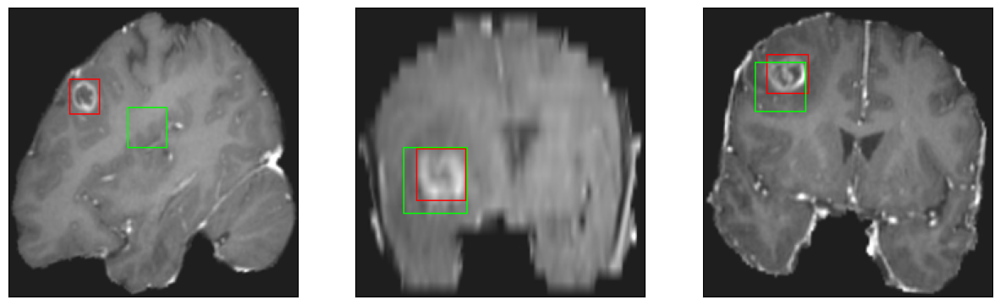

26/26 [==============================] - 3s 125ms/step - loss: 4.4177 - IoU: 0.6495 - val_loss: 8.8336 - val_IoU: 0.4927
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.6380 - IoU: 0.6374
Epoch 140: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


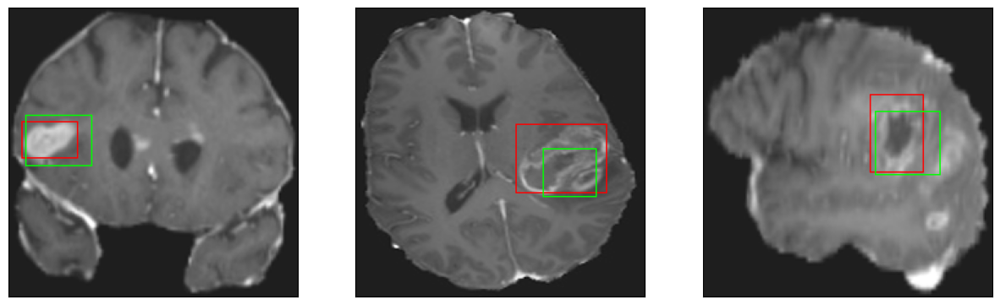

26/26 [==============================] - 3s 121ms/step - loss: 4.6380 - IoU: 0.6374 - val_loss: 9.1804 - val_IoU: 0.4689
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.6675 - IoU: 0.6405
Epoch 141: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


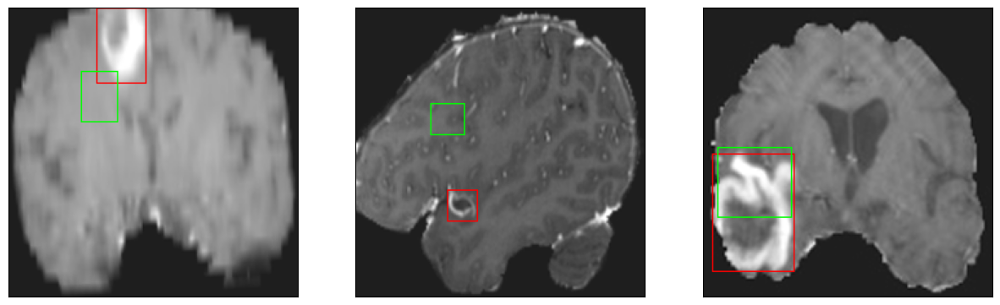

26/26 [==============================] - 3s 101ms/step - loss: 4.6675 - IoU: 0.6405 - val_loss: 11.7110 - val_IoU: 0.3704
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6302 - IoU: 0.6399
Epoch 142: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


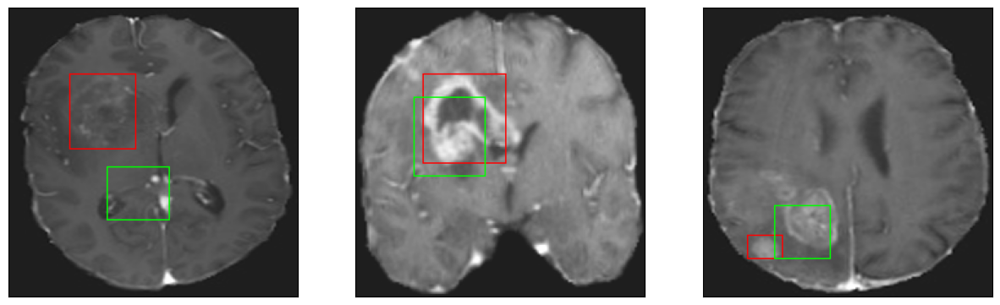

26/26 [==============================] - 3s 101ms/step - loss: 4.6377 - IoU: 0.6407 - val_loss: 9.4288 - val_IoU: 0.4597
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4484 - IoU: 0.6504
Epoch 143: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


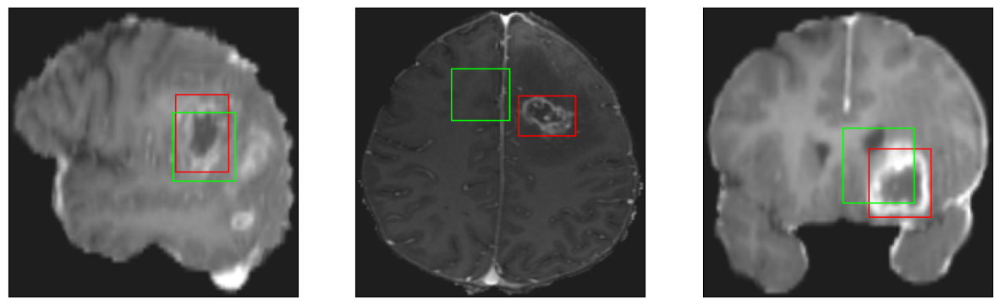

26/26 [==============================] - 3s 121ms/step - loss: 4.4782 - IoU: 0.6487 - val_loss: 10.1935 - val_IoU: 0.4256
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6761 - IoU: 0.6318
Epoch 144: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


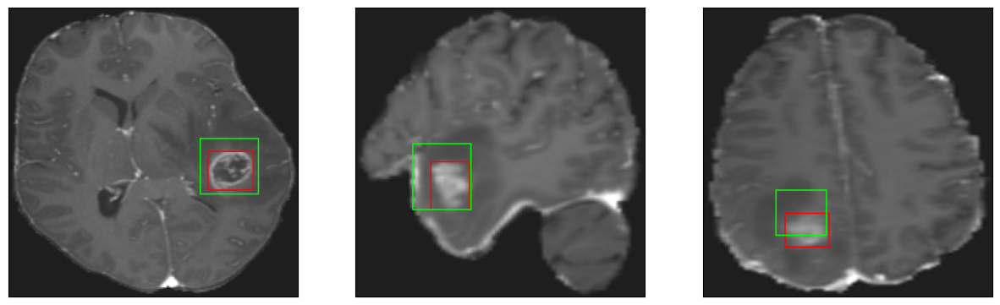

26/26 [==============================] - 3s 105ms/step - loss: 4.6360 - IoU: 0.6337 - val_loss: 9.5197 - val_IoU: 0.4495
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6714 - IoU: 0.6367
Epoch 145: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


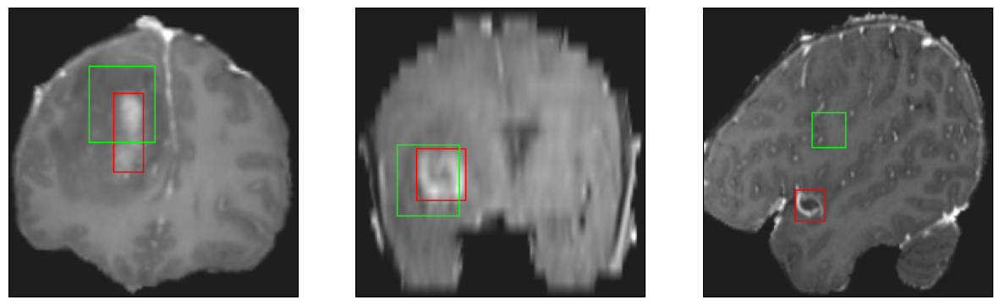

26/26 [==============================] - 3s 105ms/step - loss: 4.6685 - IoU: 0.6349 - val_loss: 9.1842 - val_IoU: 0.4934
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6367 - IoU: 0.6450
Epoch 146: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


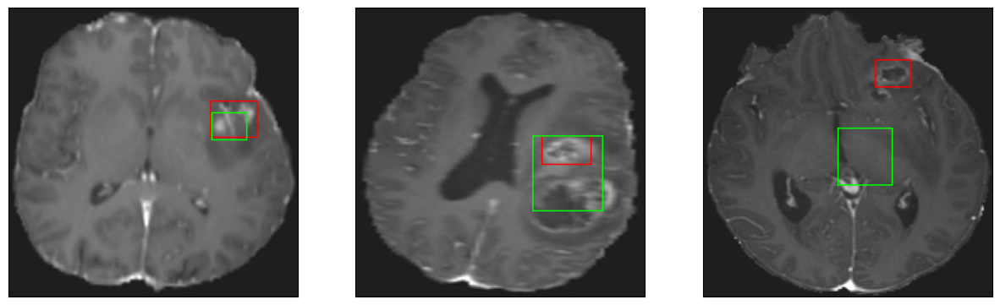

26/26 [==============================] - 3s 117ms/step - loss: 4.6901 - IoU: 0.6424 - val_loss: 9.2757 - val_IoU: 0.4775
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6426 - IoU: 0.6380
Epoch 147: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


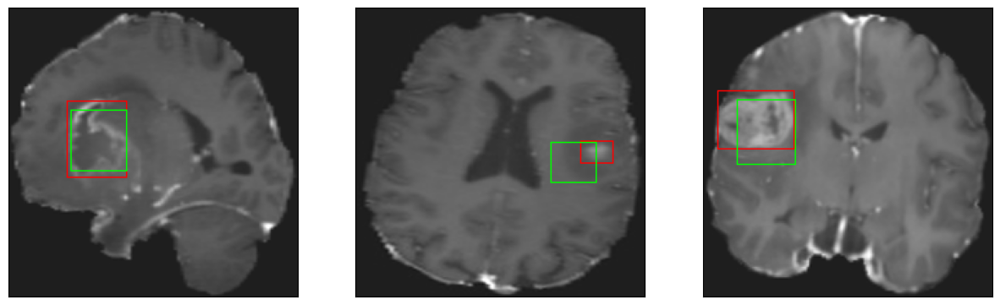

26/26 [==============================] - 3s 113ms/step - loss: 4.6126 - IoU: 0.6384 - val_loss: 8.9856 - val_IoU: 0.4922
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 4.4378 - IoU: 0.6509
Epoch 148: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


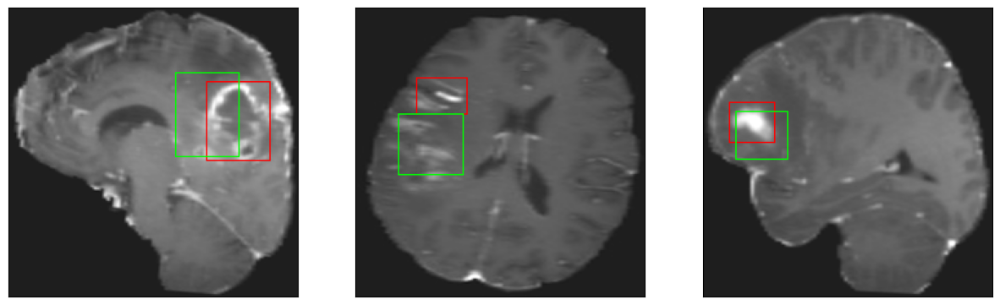

26/26 [==============================] - 3s 100ms/step - loss: 4.4378 - IoU: 0.6509 - val_loss: 8.9074 - val_IoU: 0.4931
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.5381 - IoU: 0.6441
Epoch 149: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


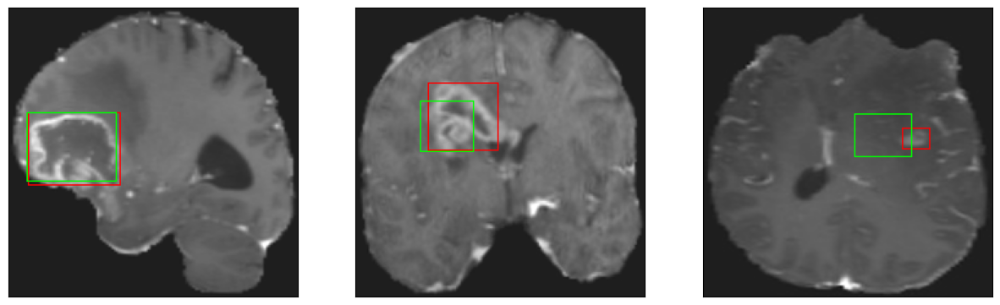

26/26 [==============================] - 3s 116ms/step - loss: 4.5381 - IoU: 0.6441 - val_loss: 9.2755 - val_IoU: 0.4756
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6723 - IoU: 0.6383
Epoch 150: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4


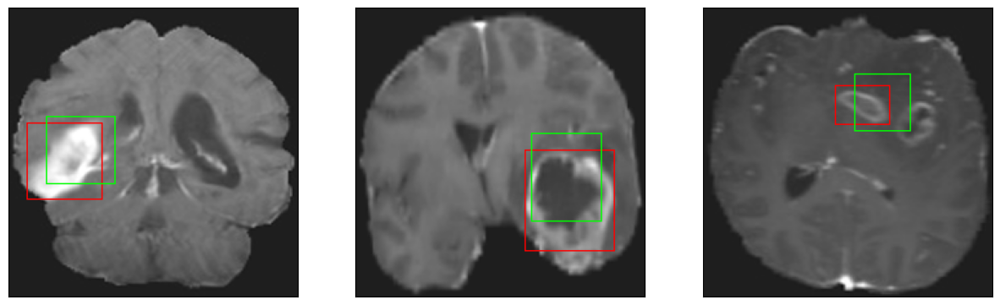

26/26 [==============================] - 3s 111ms/step - loss: 4.6760 - IoU: 0.6375 - val_loss: 9.1727 - val_IoU: 0.4634
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4027 - IoU: 0.6389
Epoch 151: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


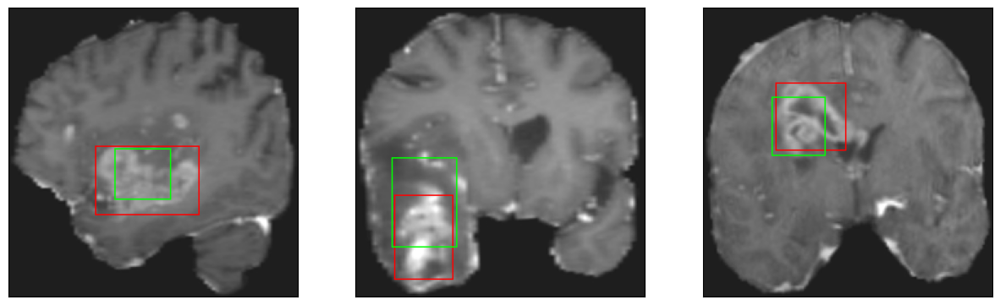

26/26 [==============================] - 2s 94ms/step - loss: 4.4548 - IoU: 0.6384 - val_loss: 8.7232 - val_IoU: 0.5045
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.5224 - IoU: 0.6420
Epoch 152: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


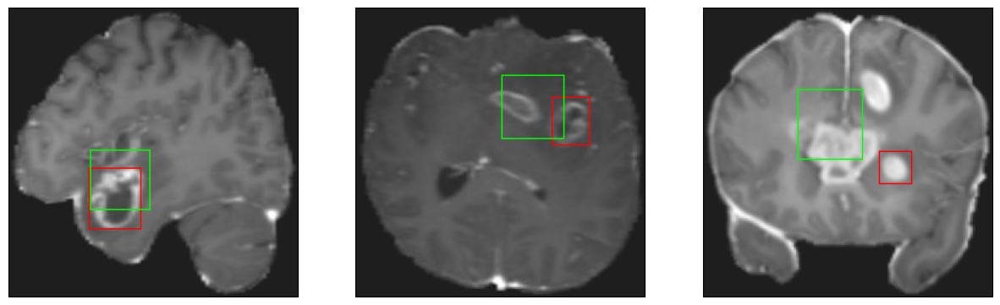

26/26 [==============================] - 2s 95ms/step - loss: 4.5224 - IoU: 0.6420 - val_loss: 9.8462 - val_IoU: 0.4588
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6660 - IoU: 0.6367
Epoch 153: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


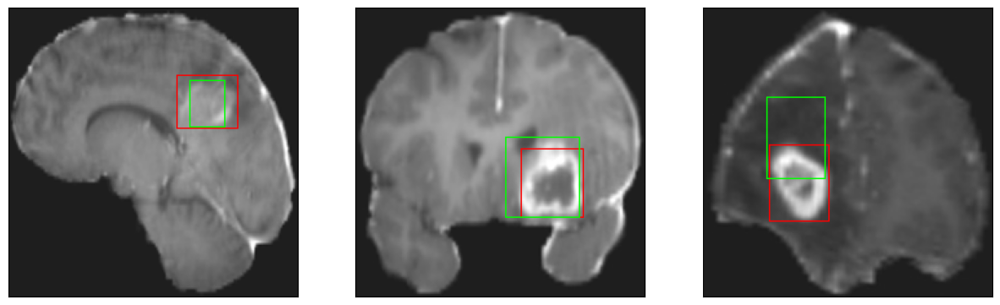

26/26 [==============================] - 3s 98ms/step - loss: 4.6689 - IoU: 0.6359 - val_loss: 9.6119 - val_IoU: 0.4497
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.4694 - IoU: 0.6460
Epoch 154: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


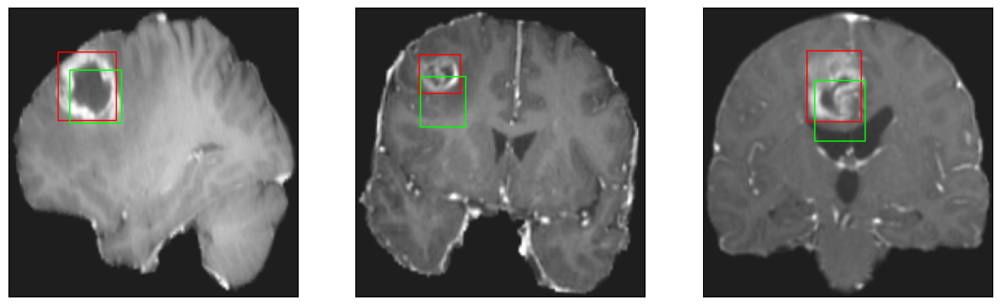

26/26 [==============================] - 3s 131ms/step - loss: 4.4694 - IoU: 0.6460 - val_loss: 8.9718 - val_IoU: 0.4818
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4577 - IoU: 0.6447
Epoch 155: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


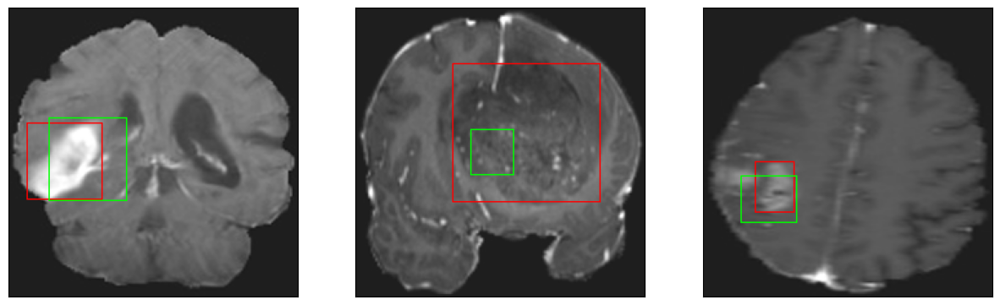

26/26 [==============================] - 3s 99ms/step - loss: 4.4517 - IoU: 0.6469 - val_loss: 9.1305 - val_IoU: 0.4868
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5242 - IoU: 0.6444
Epoch 156: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


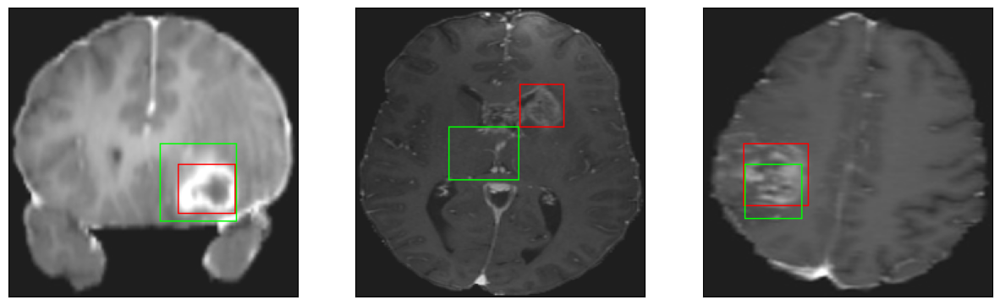

26/26 [==============================] - 2s 96ms/step - loss: 4.4846 - IoU: 0.6463 - val_loss: 8.9826 - val_IoU: 0.4896
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.4766 - IoU: 0.6451
Epoch 157: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


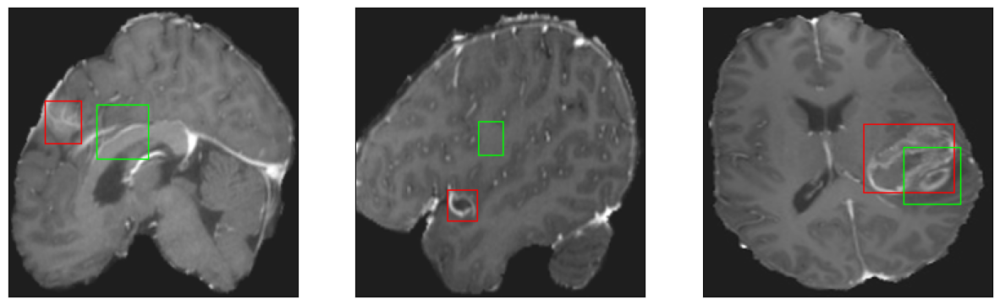

26/26 [==============================] - 3s 113ms/step - loss: 4.4766 - IoU: 0.6451 - val_loss: 9.1177 - val_IoU: 0.4716
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5631 - IoU: 0.6452
Epoch 158: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


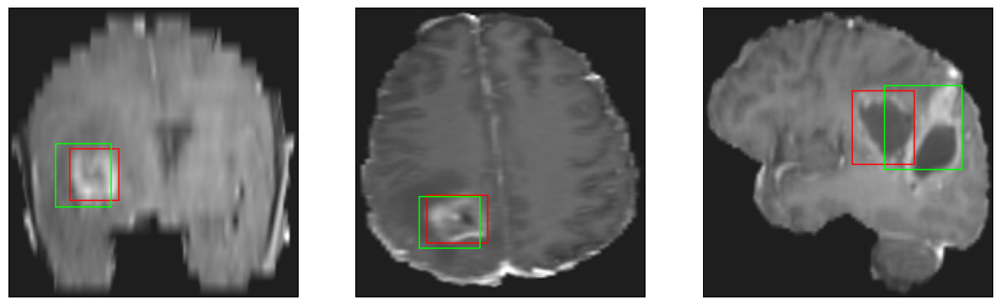

26/26 [==============================] - 3s 127ms/step - loss: 4.5801 - IoU: 0.6466 - val_loss: 9.0889 - val_IoU: 0.4799
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4752 - IoU: 0.6477
Epoch 159: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


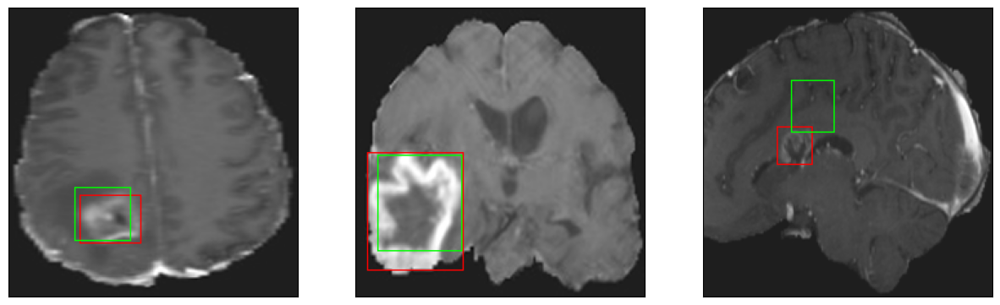

26/26 [==============================] - 3s 133ms/step - loss: 4.4810 - IoU: 0.6461 - val_loss: 8.9773 - val_IoU: 0.4926
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 4.3541 - IoU: 0.6569
Epoch 160: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


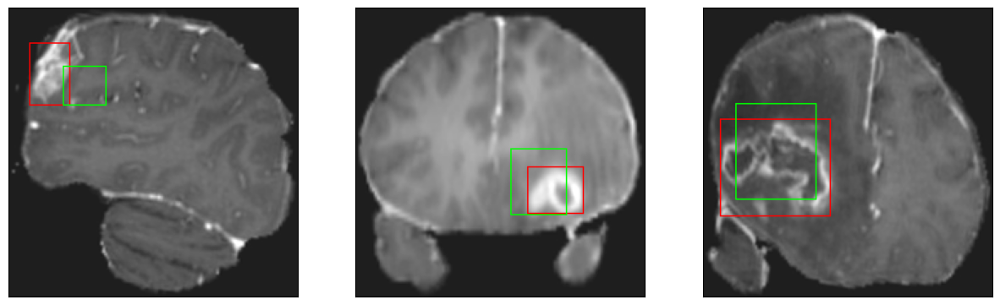

26/26 [==============================] - 3s 121ms/step - loss: 4.3541 - IoU: 0.6569 - val_loss: 8.8234 - val_IoU: 0.4886
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4038 - IoU: 0.6552
Epoch 161: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


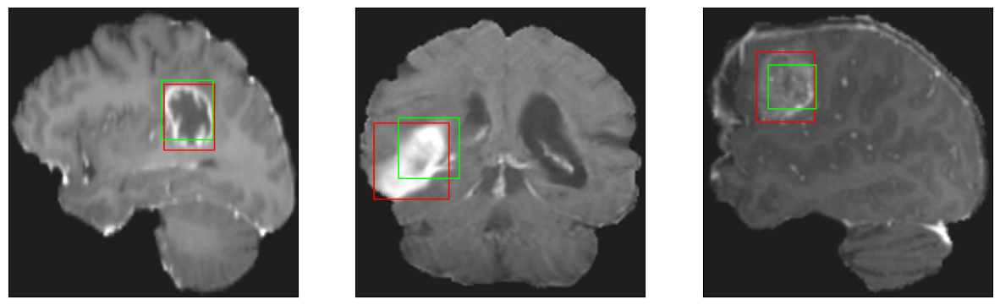

26/26 [==============================] - 3s 103ms/step - loss: 4.4279 - IoU: 0.6521 - val_loss: 9.3195 - val_IoU: 0.4649
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 4.4211 - IoU: 0.6503
Epoch 162: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


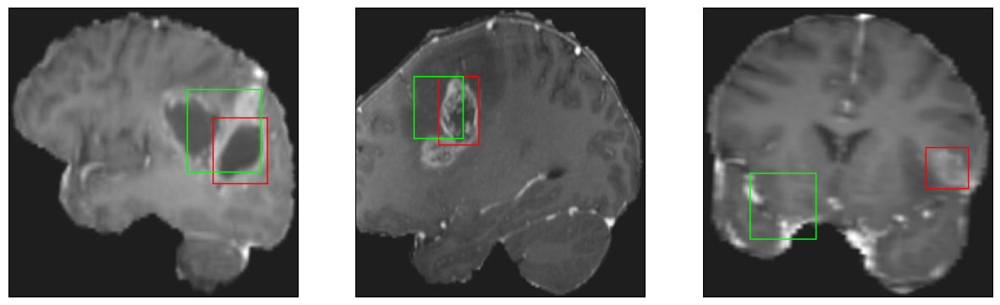

26/26 [==============================] - 3s 103ms/step - loss: 4.4211 - IoU: 0.6503 - val_loss: 8.8368 - val_IoU: 0.4937
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 4.4207 - IoU: 0.6492
Epoch 163: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


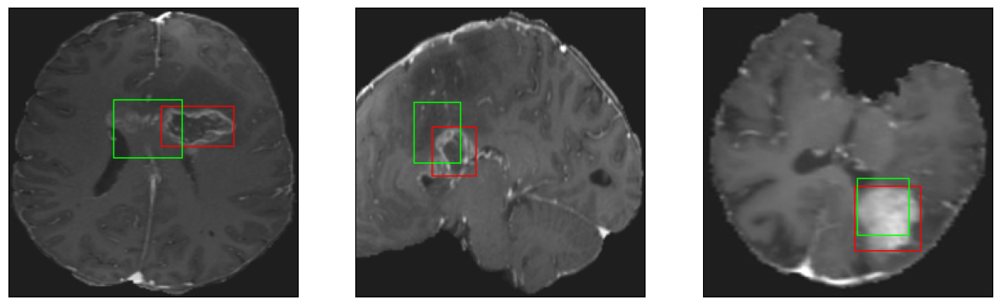

26/26 [==============================] - 3s 104ms/step - loss: 4.4207 - IoU: 0.6492 - val_loss: 9.4508 - val_IoU: 0.4619
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.3476 - IoU: 0.6581
Epoch 164: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


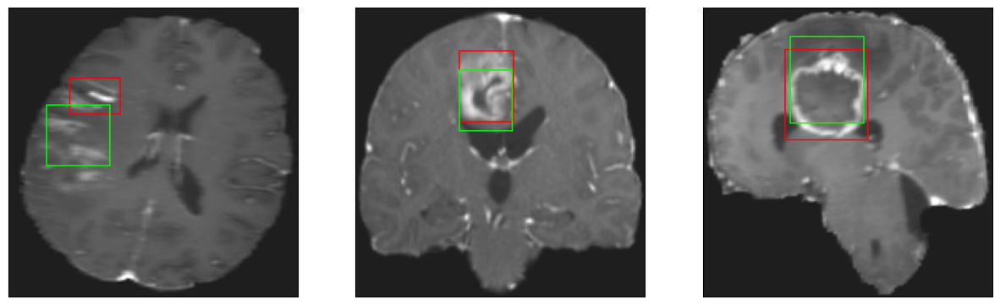

26/26 [==============================] - 3s 97ms/step - loss: 4.3476 - IoU: 0.6581 - val_loss: 8.8796 - val_IoU: 0.4910
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4115 - IoU: 0.6483
Epoch 165: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


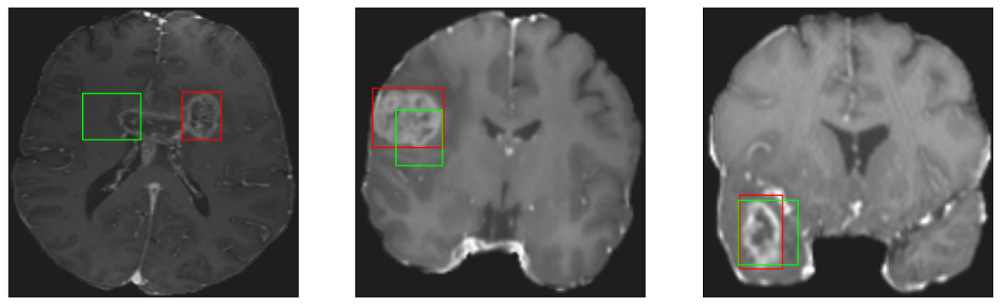

26/26 [==============================] - 3s 102ms/step - loss: 4.4213 - IoU: 0.6486 - val_loss: 9.0132 - val_IoU: 0.4774
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5516 - IoU: 0.6465
Epoch 166: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


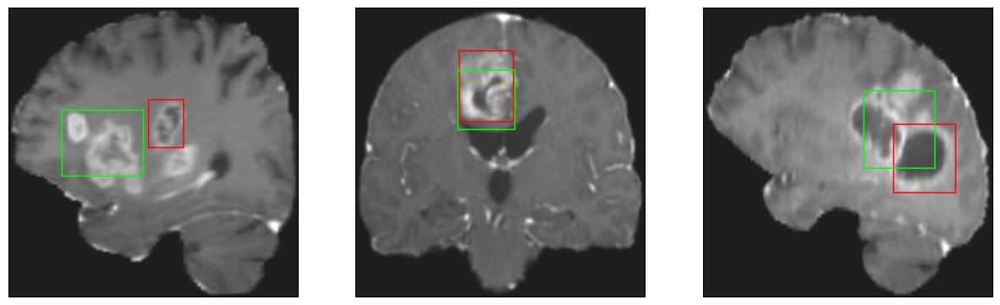

26/26 [==============================] - 3s 113ms/step - loss: 4.5601 - IoU: 0.6447 - val_loss: 10.9415 - val_IoU: 0.4132
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5169 - IoU: 0.6456
Epoch 167: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


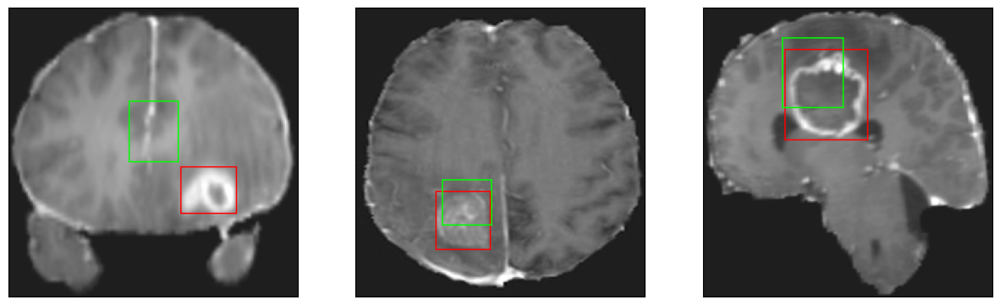

26/26 [==============================] - 3s 116ms/step - loss: 4.4898 - IoU: 0.6463 - val_loss: 11.4602 - val_IoU: 0.3795
Epoch 168/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4769 - IoU: 0.6580
Epoch 168: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


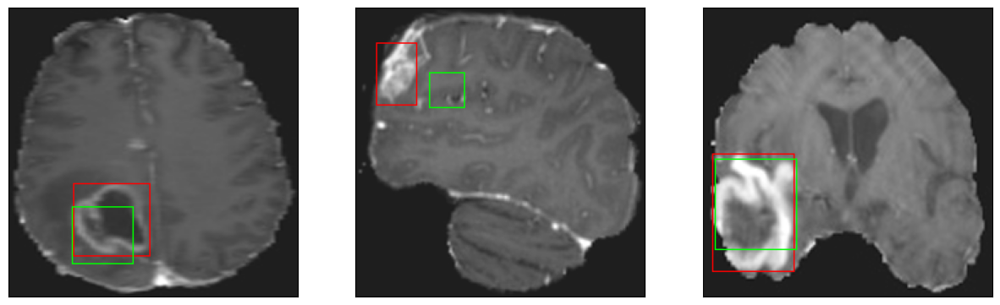

26/26 [==============================] - 3s 109ms/step - loss: 4.4814 - IoU: 0.6563 - val_loss: 8.7419 - val_IoU: 0.4927
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2688 - IoU: 0.6569
Epoch 169: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


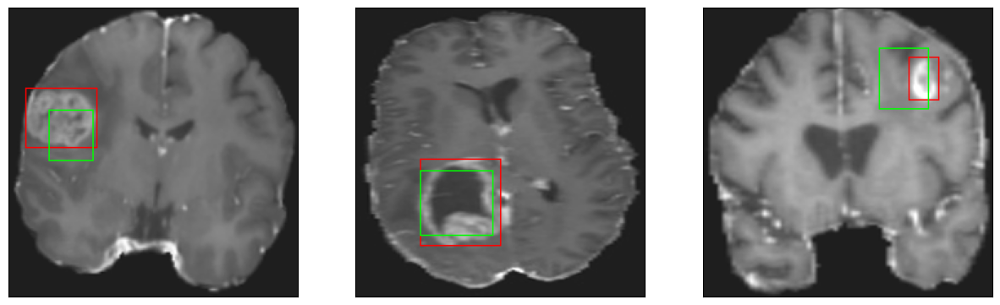

26/26 [==============================] - 3s 105ms/step - loss: 4.3079 - IoU: 0.6539 - val_loss: 8.9684 - val_IoU: 0.4855
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3550 - IoU: 0.6563
Epoch 170: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


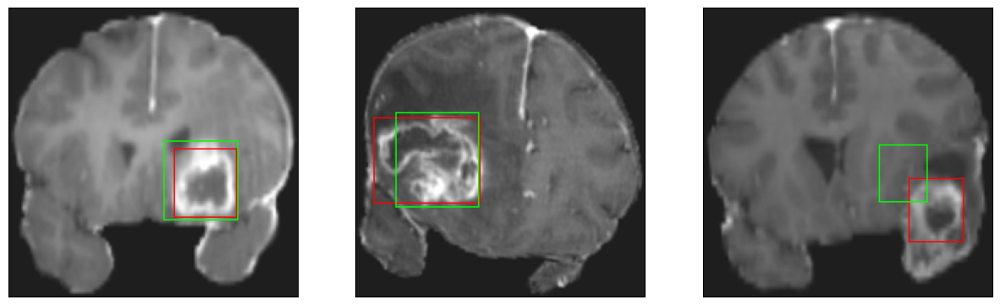

26/26 [==============================] - 3s 110ms/step - loss: 4.3044 - IoU: 0.6575 - val_loss: 9.3919 - val_IoU: 0.4499
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2142 - IoU: 0.6675
Epoch 171: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


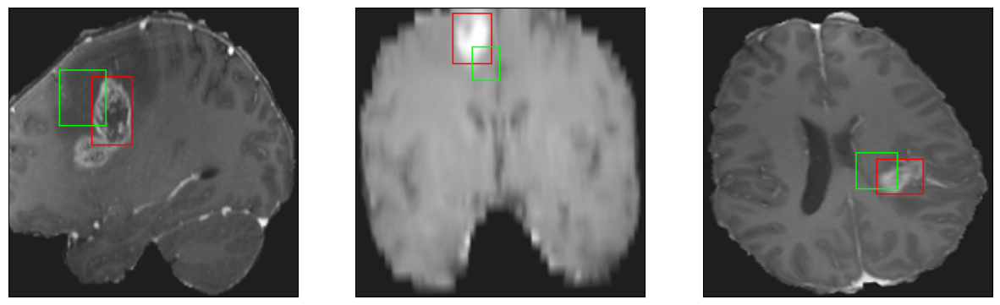

26/26 [==============================] - 3s 112ms/step - loss: 4.2735 - IoU: 0.6632 - val_loss: 10.3260 - val_IoU: 0.4188
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.3717 - IoU: 0.6582
Epoch 172: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


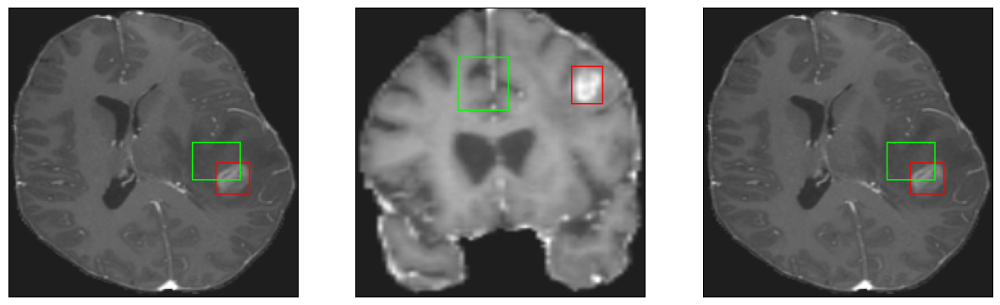

26/26 [==============================] - 2s 94ms/step - loss: 4.3717 - IoU: 0.6582 - val_loss: 10.1651 - val_IoU: 0.4429
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2718 - IoU: 0.6588
Epoch 173: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


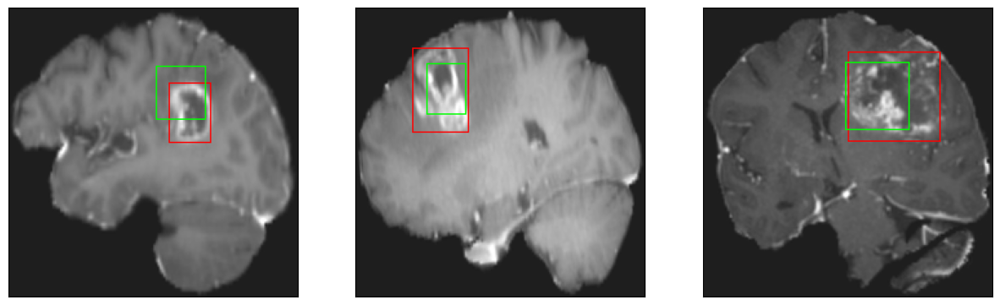

26/26 [==============================] - 2s 92ms/step - loss: 4.2917 - IoU: 0.6577 - val_loss: 8.8966 - val_IoU: 0.4691
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2438 - IoU: 0.6596
Epoch 174: val_loss did not improve from 8.59927
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


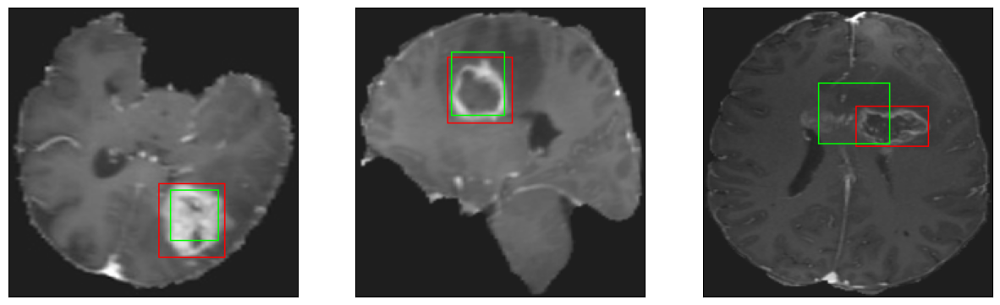

26/26 [==============================] - 3s 101ms/step - loss: 4.2747 - IoU: 0.6601 - val_loss: 8.6711 - val_IoU: 0.4921
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2819 - IoU: 0.6631
Epoch 175: val_loss improved from 8.59927 to 8.43746, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 13ms/step
4


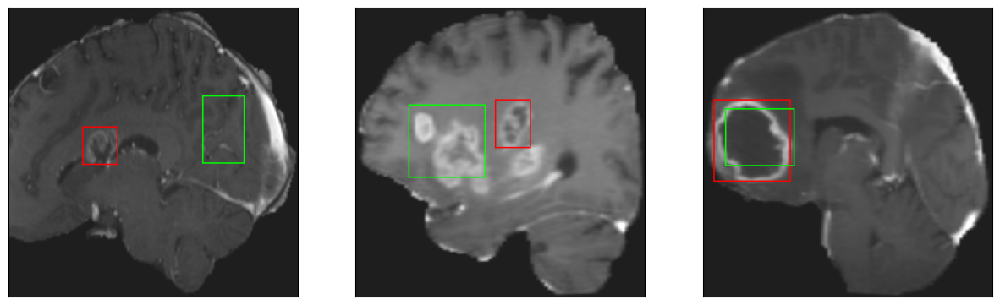

26/26 [==============================] - 4s 157ms/step - loss: 4.2347 - IoU: 0.6655 - val_loss: 8.4375 - val_IoU: 0.5065
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3085 - IoU: 0.6622
Epoch 176: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


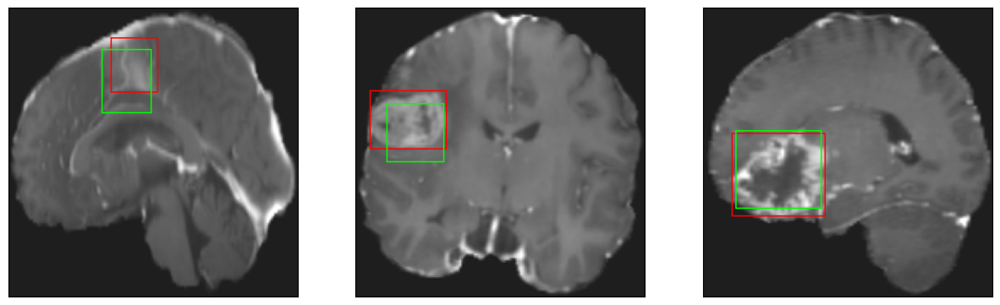

26/26 [==============================] - 3s 103ms/step - loss: 4.3003 - IoU: 0.6615 - val_loss: 9.6896 - val_IoU: 0.4625
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.5161 - IoU: 0.6415
Epoch 177: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


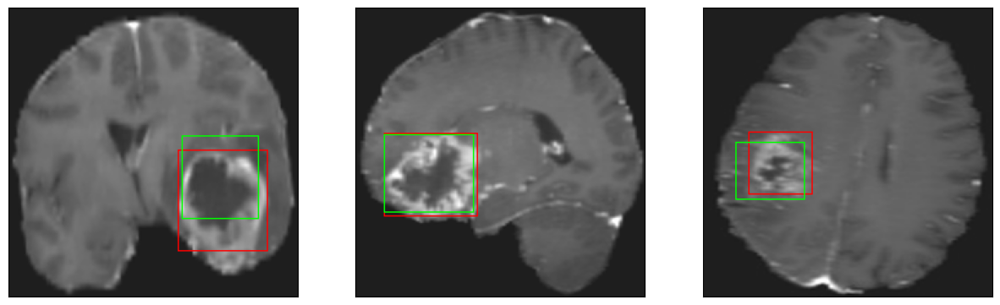

26/26 [==============================] - 3s 102ms/step - loss: 4.5161 - IoU: 0.6415 - val_loss: 9.5520 - val_IoU: 0.4775
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3227 - IoU: 0.6620
Epoch 178: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


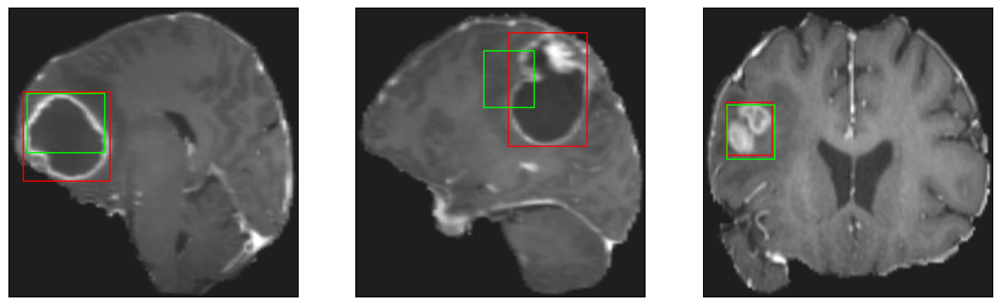

26/26 [==============================] - 3s 104ms/step - loss: 4.3191 - IoU: 0.6610 - val_loss: 10.5483 - val_IoU: 0.4214
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 4.2636 - IoU: 0.6595
Epoch 179: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


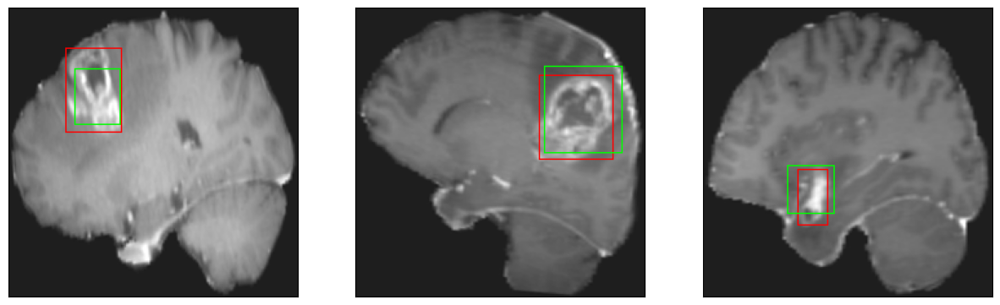

26/26 [==============================] - 4s 137ms/step - loss: 4.2636 - IoU: 0.6595 - val_loss: 8.6726 - val_IoU: 0.5102
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 4.3247 - IoU: 0.6530
Epoch 180: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


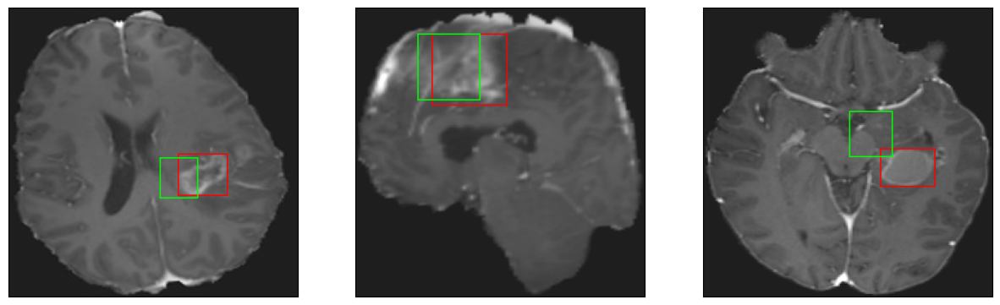

26/26 [==============================] - 3s 108ms/step - loss: 4.3247 - IoU: 0.6530 - val_loss: 8.7794 - val_IoU: 0.4967
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 4.1139 - IoU: 0.6734
Epoch 181: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


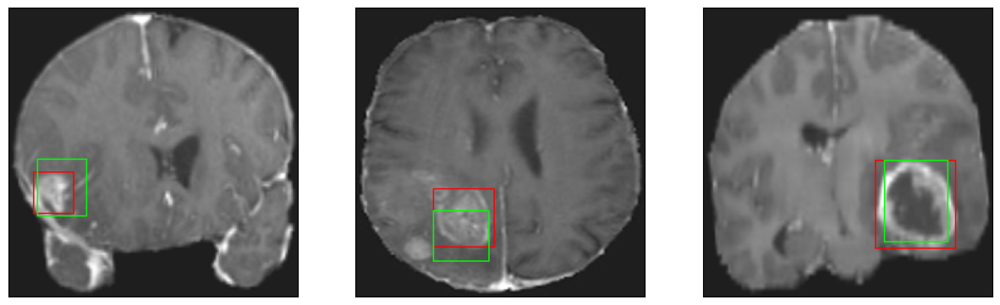

26/26 [==============================] - 3s 101ms/step - loss: 4.1139 - IoU: 0.6734 - val_loss: 8.9312 - val_IoU: 0.4870
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 4.2731 - IoU: 0.6647
Epoch 182: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


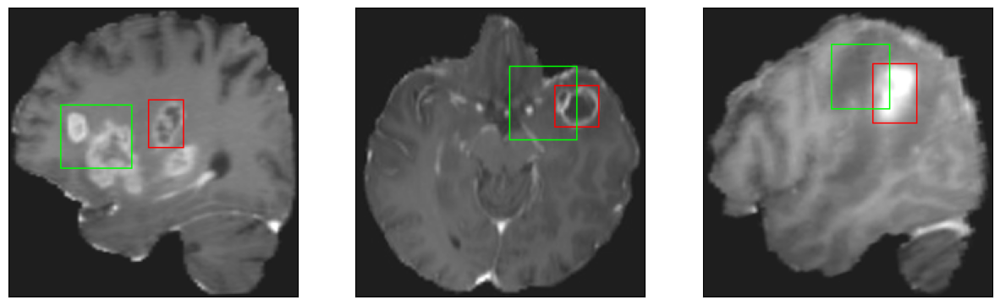

26/26 [==============================] - 3s 113ms/step - loss: 4.2731 - IoU: 0.6647 - val_loss: 9.1037 - val_IoU: 0.4816
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2075 - IoU: 0.6678
Epoch 183: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


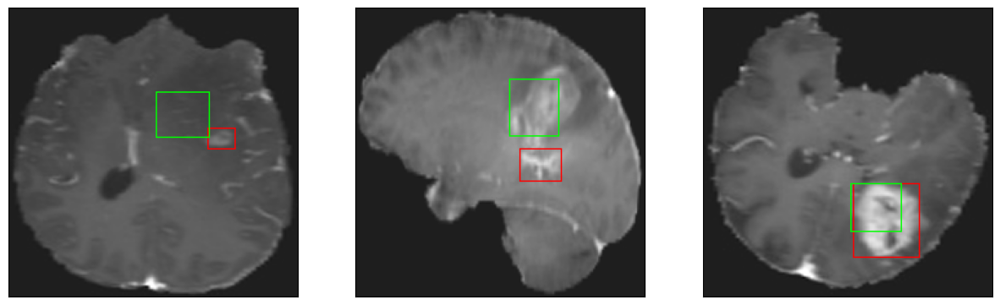

26/26 [==============================] - 3s 131ms/step - loss: 4.1951 - IoU: 0.6677 - val_loss: 8.8904 - val_IoU: 0.5021
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.5051 - IoU: 0.6528
Epoch 184: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


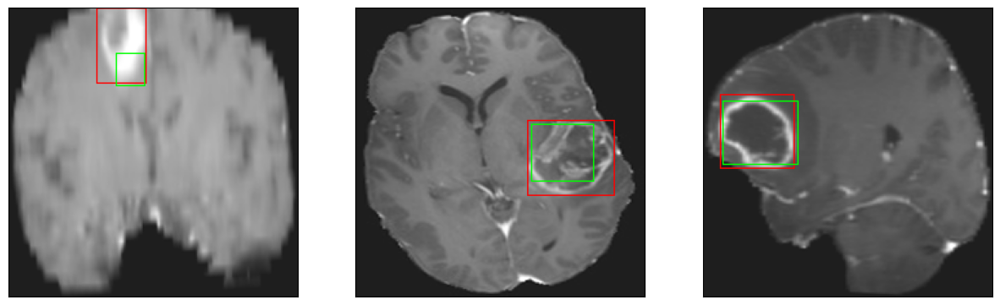

26/26 [==============================] - 3s 103ms/step - loss: 4.5051 - IoU: 0.6528 - val_loss: 9.6916 - val_IoU: 0.4434
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6009 - IoU: 0.6472
Epoch 185: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


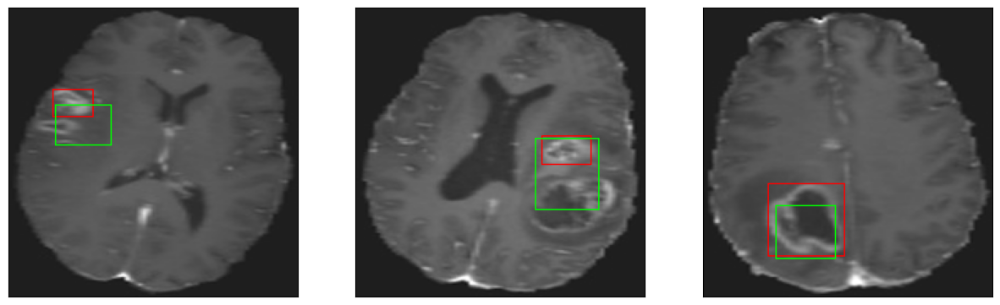

26/26 [==============================] - 2s 95ms/step - loss: 4.5731 - IoU: 0.6486 - val_loss: 9.0870 - val_IoU: 0.4841
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.4608 - IoU: 0.6490
Epoch 186: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


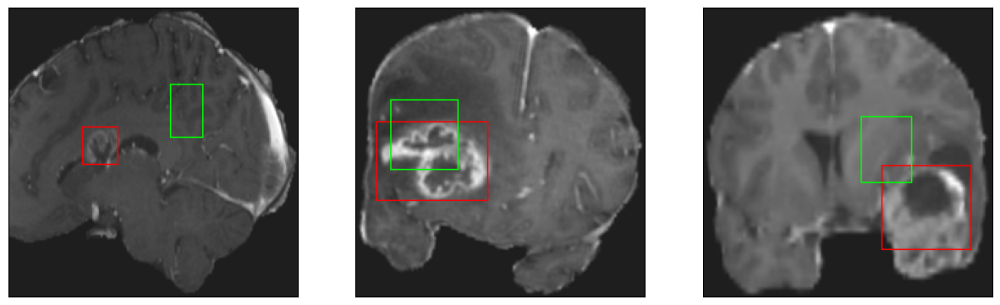

26/26 [==============================] - 2s 95ms/step - loss: 4.4608 - IoU: 0.6490 - val_loss: 11.3924 - val_IoU: 0.3771
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2420 - IoU: 0.6654
Epoch 187: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


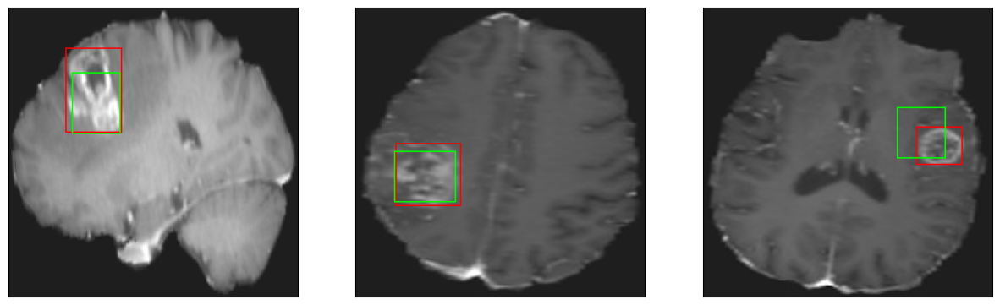

26/26 [==============================] - 3s 119ms/step - loss: 4.2620 - IoU: 0.6645 - val_loss: 9.7886 - val_IoU: 0.4645
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 4.2837 - IoU: 0.6591
Epoch 188: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


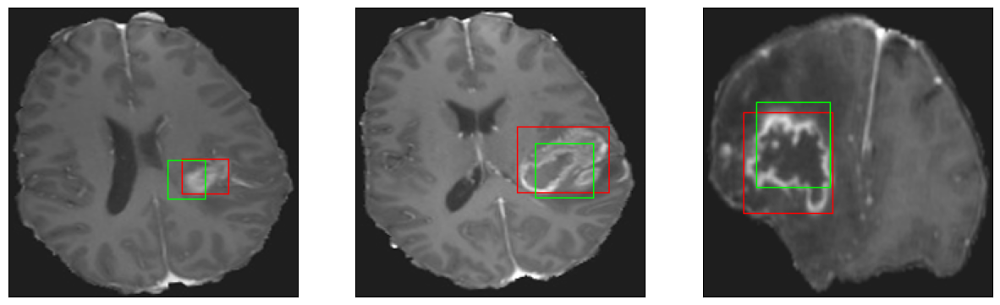

26/26 [==============================] - 3s 105ms/step - loss: 4.2837 - IoU: 0.6591 - val_loss: 9.0503 - val_IoU: 0.4920
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.3476 - IoU: 0.6546
Epoch 189: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


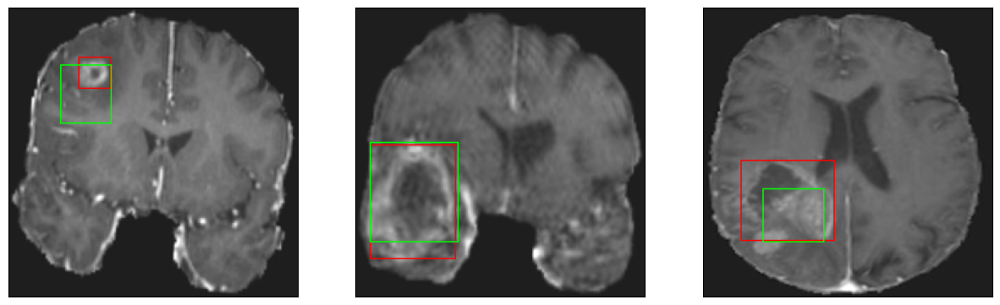

26/26 [==============================] - 3s 100ms/step - loss: 4.3476 - IoU: 0.6546 - val_loss: 8.6684 - val_IoU: 0.4991
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3835 - IoU: 0.6542
Epoch 190: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


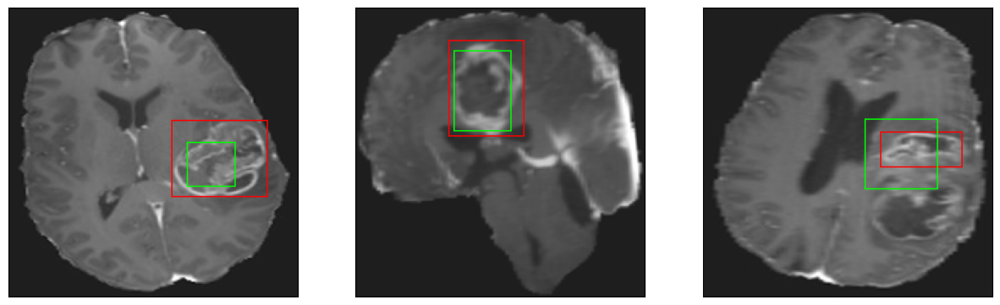

26/26 [==============================] - 3s 125ms/step - loss: 4.3496 - IoU: 0.6556 - val_loss: 9.3482 - val_IoU: 0.4696
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 4.2642 - IoU: 0.6622
Epoch 191: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


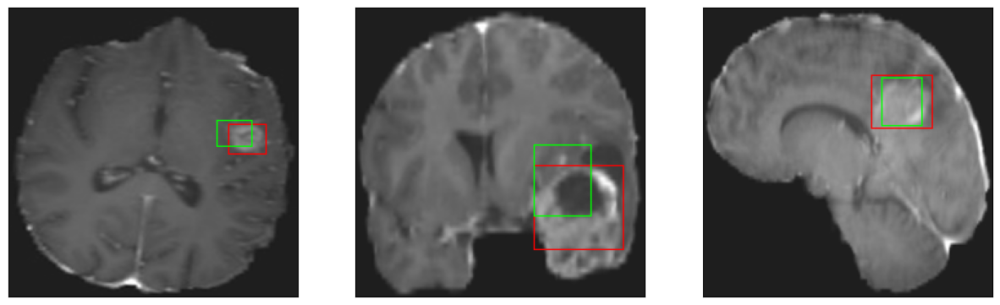

26/26 [==============================] - 3s 107ms/step - loss: 4.2642 - IoU: 0.6622 - val_loss: 8.9405 - val_IoU: 0.4860
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1980 - IoU: 0.6741
Epoch 192: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


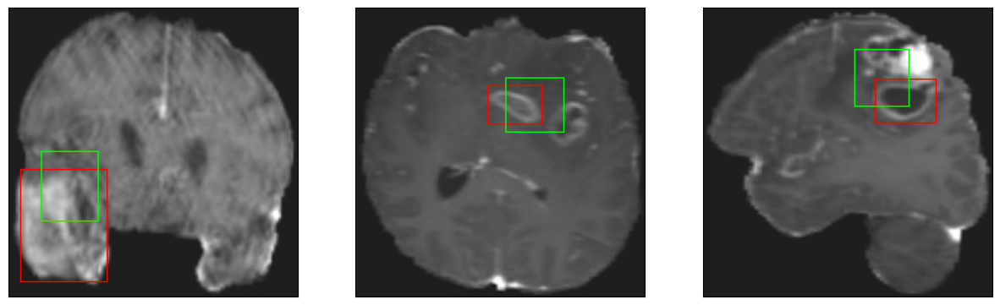

26/26 [==============================] - 3s 98ms/step - loss: 4.2090 - IoU: 0.6727 - val_loss: 9.1500 - val_IoU: 0.4631
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 4.2075 - IoU: 0.6673
Epoch 193: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


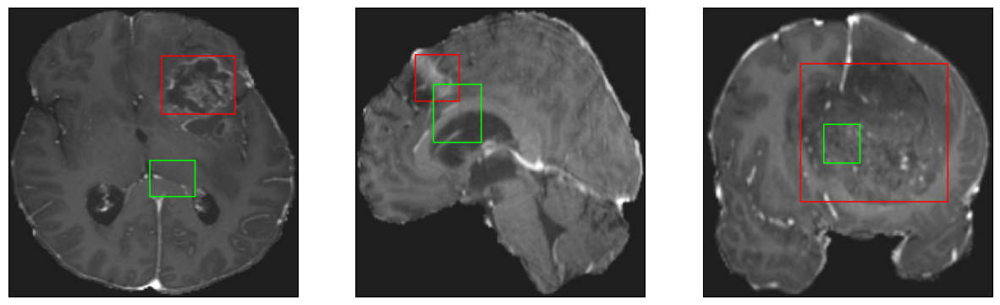

26/26 [==============================] - 3s 113ms/step - loss: 4.2075 - IoU: 0.6673 - val_loss: 11.6416 - val_IoU: 0.3677
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2027 - IoU: 0.6621
Epoch 194: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


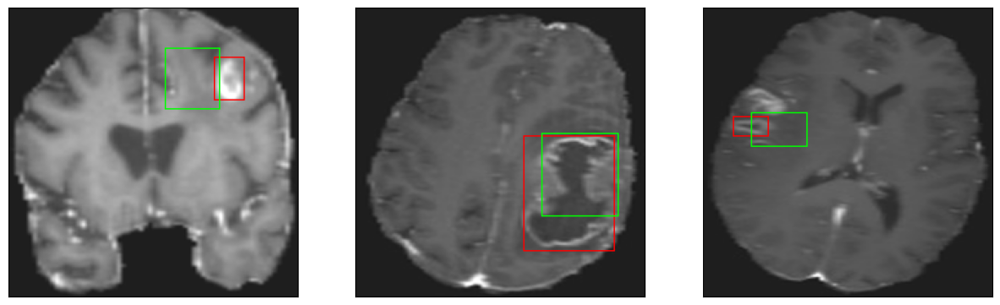

26/26 [==============================] - 3s 119ms/step - loss: 4.1556 - IoU: 0.6655 - val_loss: 8.7591 - val_IoU: 0.4996
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1244 - IoU: 0.6623
Epoch 195: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


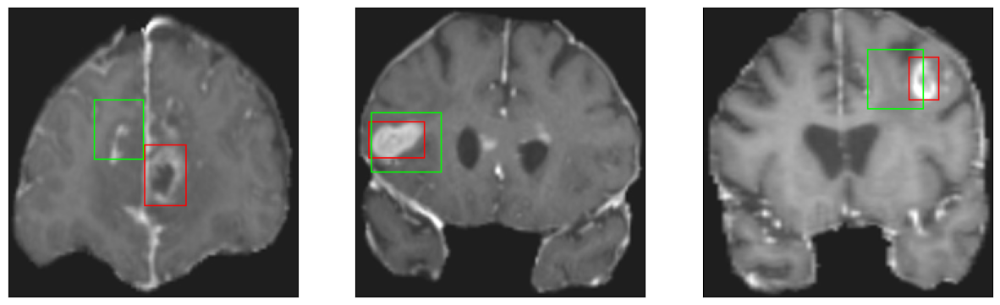

26/26 [==============================] - 3s 99ms/step - loss: 4.0932 - IoU: 0.6653 - val_loss: 8.7907 - val_IoU: 0.5072
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1737 - IoU: 0.6682
Epoch 196: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


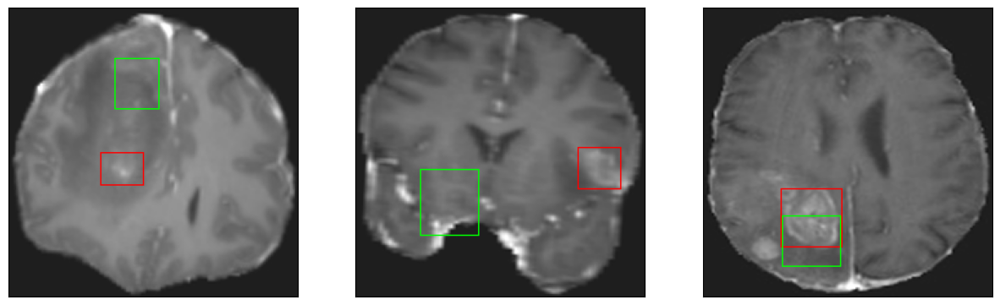

26/26 [==============================] - 2s 96ms/step - loss: 4.1948 - IoU: 0.6685 - val_loss: 8.9609 - val_IoU: 0.4997
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3599 - IoU: 0.6448
Epoch 197: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


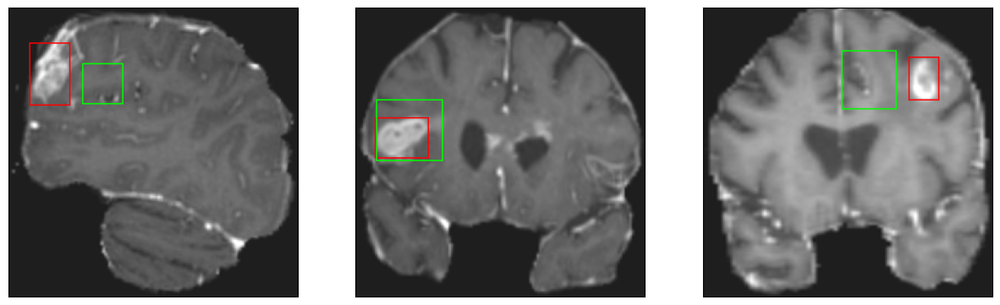

26/26 [==============================] - 3s 101ms/step - loss: 4.3086 - IoU: 0.6475 - val_loss: 9.2942 - val_IoU: 0.4561
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1194 - IoU: 0.6715
Epoch 198: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


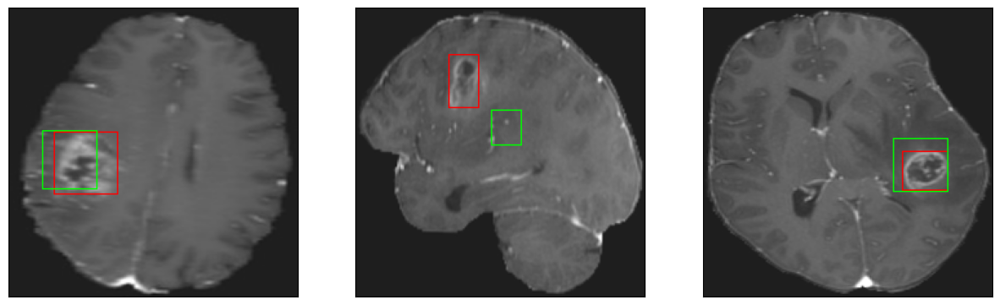

26/26 [==============================] - 3s 127ms/step - loss: 4.1149 - IoU: 0.6710 - val_loss: 9.0899 - val_IoU: 0.4760
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 4.1974 - IoU: 0.6679
Epoch 199: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


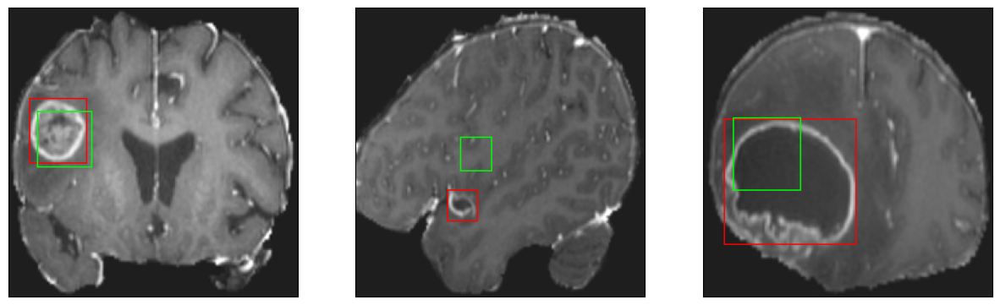

26/26 [==============================] - 3s 107ms/step - loss: 4.1974 - IoU: 0.6679 - val_loss: 8.9101 - val_IoU: 0.4929
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.1778 - IoU: 0.6669
Epoch 200: val_loss did not improve from 8.43746
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


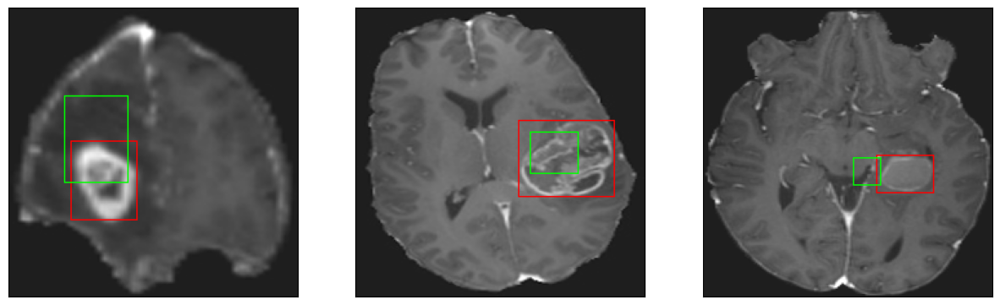

26/26 [==============================] - 2s 93ms/step - loss: 4.1778 - IoU: 0.6669 - val_loss: 9.5877 - val_IoU: 0.4400


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

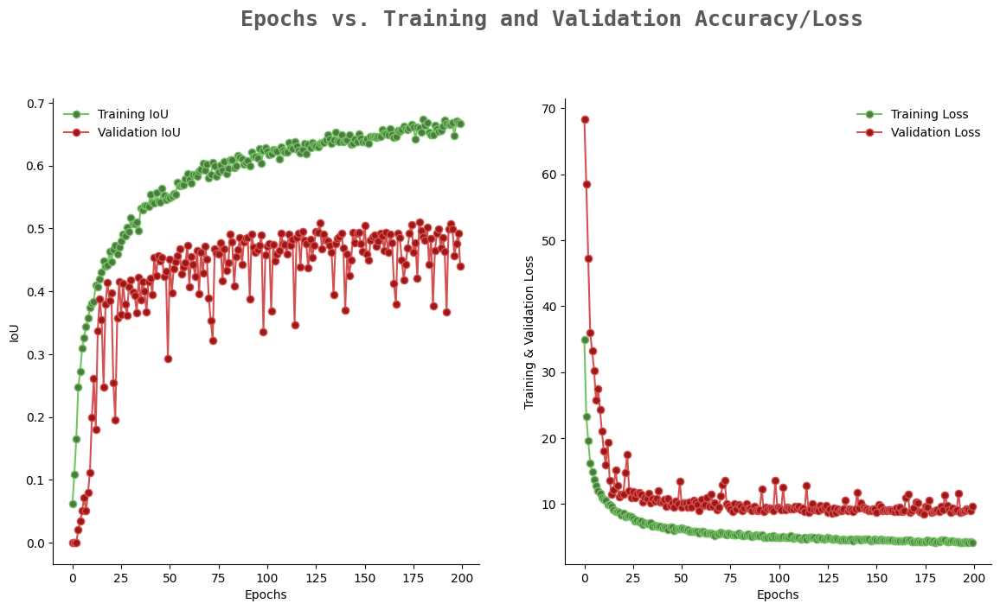

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 41ms/step - loss: 12.8441 - IoU: 0.3626


[12.844141006469727, 0.3625642955303192]